# ROI 200

In [1]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi200"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=200)
        
        
    

In [2]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi200/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi200/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Using TensorFlow backend.


Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 590us/step - loss: 0.0964 - mean_squared_error: 0.0964 - val_loss: 0.0722 - val_mean_squared_error: 0.0722
Epoch 2/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0680 - mean_squared_error: 0.0680 - val_loss: 0.0601 - val_mean_squared_error: 0.0601
Epoch 3/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0587 - mean_squared_error: 0.0587 - val_loss: 0.0483 - val_mean_squared_error: 0.0483
Epoch 4/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0497 - mean_squared_error: 0.0497 - val_loss: 0.0415 - val_mean_squared_error: 0.0415
Epoch 5/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0439 - mean_squared_error: 0.0439 - val_loss: 0.0383 - val_mean_squared_error: 0.0383
Epoch 6/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0409 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 348us/step - loss: 0.0201 - mean_squared_error: 0.0201 - val_loss: 0.0197 - val_mean_squared_error: 0.0197
Epoch 98/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0201 - mean_squared_error: 0.0201 - val_loss: 0.0194 - val_mean_squared_error: 0.0194
Epoch 99/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0201 - mean_squared_error: 0.0201 - val_loss: 0.0197 - val_mean_squared_error: 0.0197
Epoch 100/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0201 - mean_squared_error: 0.0201 - val_loss: 0.0201 - val_mean_squared_error: 0.0201
Epoch 101/2000
3600/3600 [==============================] - 1s 318us/step - loss: 0.0200 - mean_squared_error: 0.0200 - val_loss: 0.0194 - val_mean_squared_error: 0.0194
Epoch 102/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0199 - mean_squared_error: 0.0199 - val_loss: 0.0193 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 330us/step - loss: 0.0181 - mean_squared_error: 0.0181 - val_loss: 0.0172 - val_mean_squared_error: 0.0172
Epoch 194/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0182 - mean_squared_error: 0.0182 - val_loss: 0.0175 - val_mean_squared_error: 0.0175
Epoch 195/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0183 - mean_squared_error: 0.0183 - val_loss: 0.0177 - val_mean_squared_error: 0.0177
Epoch 196/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0182 - mean_squared_error: 0.0182 - val_loss: 0.0174 - val_mean_squared_error: 0.0174
Epoch 197/2000
3600/3600 [==============================] - 1s 314us/step - loss: 0.0181 - mean_squared_error: 0.0181 - val_loss: 0.0171 - val_mean_squared_error: 0.0171
Epoch 198/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0181 - mean_squared_error: 0.0181 - val_loss: 0.0171 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 349us/step - loss: 0.0159 - mean_squared_error: 0.0159 - val_loss: 0.0145 - val_mean_squared_error: 0.0145
Epoch 290/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0159 - mean_squared_error: 0.0159 - val_loss: 0.0145 - val_mean_squared_error: 0.0145
Epoch 291/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0159 - mean_squared_error: 0.0159 - val_loss: 0.0144 - val_mean_squared_error: 0.0144
Epoch 292/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0160 - mean_squared_error: 0.0160 - val_loss: 0.0143 - val_mean_squared_error: 0.0143
Epoch 293/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0159 - mean_squared_error: 0.0159 - val_loss: 0.0144 - val_mean_squared_error: 0.0144
Epoch 294/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0157 - mean_squared_error: 0.0157 - val_loss: 0.0144 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 345us/step - loss: 0.0146 - mean_squared_error: 0.0146 - val_loss: 0.0127 - val_mean_squared_error: 0.0127
Epoch 386/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0144 - mean_squared_error: 0.0144 - val_loss: 0.0128 - val_mean_squared_error: 0.0128
Epoch 387/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0145 - mean_squared_error: 0.0145 - val_loss: 0.0133 - val_mean_squared_error: 0.0133
Epoch 388/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0145 - mean_squared_error: 0.0145 - val_loss: 0.0133 - val_mean_squared_error: 0.0133
Epoch 389/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0147 - mean_squared_error: 0.0147 - val_loss: 0.0130 - val_mean_squared_error: 0.0130
Epoch 390/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0143 - mean_squared_error: 0.0143 - val_loss: 0.0130 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 340us/step - loss: 0.0138 - mean_squared_error: 0.0138 - val_loss: 0.0126 - val_mean_squared_error: 0.0126
Epoch 482/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0137 - mean_squared_error: 0.0137 - val_loss: 0.0126 - val_mean_squared_error: 0.0126
Epoch 483/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0139 - mean_squared_error: 0.0139 - val_loss: 0.0122 - val_mean_squared_error: 0.0122
Epoch 484/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0140 - mean_squared_error: 0.0140 - val_loss: 0.0121 - val_mean_squared_error: 0.0121
Epoch 485/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0139 - mean_squared_error: 0.0139 - val_loss: 0.0125 - val_mean_squared_error: 0.0125
Epoch 486/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0139 - mean_squared_error: 0.0139 - val_loss: 0.0126 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 347us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0119 - val_mean_squared_error: 0.0119
Epoch 578/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0135 - mean_squared_error: 0.0135 - val_loss: 0.0114 - val_mean_squared_error: 0.0114
Epoch 579/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0122 - val_mean_squared_error: 0.0122
Epoch 580/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0120 - val_mean_squared_error: 0.0120
Epoch 581/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0135 - mean_squared_error: 0.0135 - val_loss: 0.0124 - val_mean_squared_error: 0.0124
Epoch 582/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0128 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 334us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0115 - val_mean_squared_error: 0.0115
Epoch 674/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0130 - mean_squared_error: 0.0130 - val_loss: 0.0118 - val_mean_squared_error: 0.0118
Epoch 675/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0132 - mean_squared_error: 0.0132 - val_loss: 0.0112 - val_mean_squared_error: 0.0112
Epoch 676/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0117 - val_mean_squared_error: 0.0117
Epoch 677/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0130 - mean_squared_error: 0.0130 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 678/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0130 - mean_squared_error: 0.0130 - val_loss: 0.0119 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 336us/step - loss: 0.0128 - mean_squared_error: 0.0128 - val_loss: 0.0113 - val_mean_squared_error: 0.0113
Epoch 770/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0114 - val_mean_squared_error: 0.0114
Epoch 771/2000
3600/3600 [==============================] - 1s 318us/step - loss: 0.0128 - mean_squared_error: 0.0128 - val_loss: 0.0113 - val_mean_squared_error: 0.0113
Epoch 772/2000
3600/3600 [==============================] - 1s 320us/step - loss: 0.0128 - mean_squared_error: 0.0128 - val_loss: 0.0117 - val_mean_squared_error: 0.0117
Epoch 773/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0115 - val_mean_squared_error: 0.0115
Epoch 774/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0126 - mean_squared_error: 0.0126 - val_loss: 0.0120 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 349us/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 0.0111 - val_mean_squared_error: 0.0111
Epoch 866/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0124 - mean_squared_error: 0.0124 - val_loss: 0.0112 - val_mean_squared_error: 0.0112
Epoch 867/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 0.0118 - val_mean_squared_error: 0.0118
Epoch 868/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0109 - val_mean_squared_error: 0.0109
Epoch 869/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0109 - val_mean_squared_error: 0.0109
Epoch 870/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0124 - mean_squared_error: 0.0124 - val_loss: 0.0109 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 329us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 962/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 963/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0113 - val_mean_squared_error: 0.0113
Epoch 964/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 965/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 966/2000
3600/3600 [==============================] - 1s 315us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0104 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 339us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0104 - val_mean_squared_error: 0.0104
Epoch 1058/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1059/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0109 - val_mean_squared_error: 0.0109
Epoch 1060/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 1061/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0114 - val_mean_squared_error: 0.0114
Epoch 1062/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0106 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0111 - val_mean_squared_error: 0.0111
Epoch 1106/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0112 - val_mean_squared_error: 0.0112
Epoch 1107/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 1108/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1109/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 1110/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0108 - val_mean_squared_erro

3600/3600 [==============================] - 1s 338us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0111 - val_mean_squared_error: 0.0111
Epoch 1154/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0123 - val_mean_squared_error: 0.0123
Epoch 1155/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 1156/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1157/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0113 - val_mean_squared_error: 0.0113
Epoch 1158/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0104 - val_mean_squared_erro

3600/3600 [==============================] - 1s 332us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0101 - val_mean_squared_error: 0.0101
Epoch 1202/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1203/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1204/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0104 - val_mean_squared_error: 0.0104
Epoch 1205/2000
3600/3600 [==============================] - 1s 315us/step - loss: 0.0113 - mean_squared_error: 0.0113 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1206/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0102 - val_mean_squared_erro

3600/3600 [==============================] - 1s 333us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 1250/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 1251/2000
3600/3600 [==============================] - 1s 317us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0106 - val_mean_squared_error: 0.0106
Epoch 1252/2000
3600/3600 [==============================] - 1s 324us/step - loss: 0.0113 - mean_squared_error: 0.0113 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 1253/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1254/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0106 - val_mean_squared_erro

3600/3600 [==============================] - 1s 338us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0118 - val_mean_squared_error: 0.0118
Epoch 1298/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1299/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1300/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0101 - val_mean_squared_error: 0.0101
Epoch 1301/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1302/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0103 - val_mean_squared_erro

3600/3600 [==============================] - 1s 327us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1346/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0113 - mean_squared_error: 0.0113 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 1347/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1348/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0115 - mean_squared_error: 0.0115 - val_loss: 0.0115 - val_mean_squared_error: 0.0115
Epoch 1349/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 1350/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0102 - val_mean_squared_erro

3600/3600 [==============================] - 1s 356us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1394/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1395/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 1396/2000
3600/3600 [==============================] - 1s 323us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1397/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 1398/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0107 - val_mean_squared_erro

3600/3600 [==============================] - 1s 321us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 1442/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1443/2000
3600/3600 [==============================] - 1s 316us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1444/2000
3600/3600 [==============================] - 1s 325us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0101 - val_mean_squared_error: 0.0101
Epoch 1445/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 1446/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0103 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1490/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0112 - mean_squared_error: 0.0112 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1491/2000
3600/3600 [==============================] - 1s 323us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0097 - val_mean_squared_error: 0.0097
Epoch 1492/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0111 - mean_squared_error: 0.0111 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1493/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0101 - val_mean_squared_error: 0.0101
Epoch 1494/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0100 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1538/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1539/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1540/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1541/2000
3600/3600 [==============================] - 1s 310us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0097 - val_mean_squared_error: 0.0097
Epoch 1542/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0100 - val_mean_squared_erro

3600/3600 [==============================] - 1s 324us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1586/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1587/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1588/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1589/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 1590/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0094 - val_mean_squared_erro

3600/3600 [==============================] - 1s 364us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1634/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0114 - val_mean_squared_error: 0.0114
Epoch 1635/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1636/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1637/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 1638/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0102 - val_mean_squared_erro

3600/3600 [==============================] - 1s 349us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 1682/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1683/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1684/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1685/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 1686/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0096 - val_mean_squared_erro

3600/3600 [==============================] - 1s 357us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0094 - val_mean_squared_error: 0.0094
Epoch 1730/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 1731/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1732/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1733/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1734/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0095 - val_mean_squared_erro

3600/3600 [==============================] - 1s 328us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1778/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1779/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 1780/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 1781/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1782/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0094 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 1826/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0106 - mean_squared_error: 0.0106 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 1827/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0091 - val_mean_squared_error: 0.0091
Epoch 1828/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 1829/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0091 - val_mean_squared_error: 0.0091
Epoch 1830/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0098 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 1874/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1875/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0109 - val_mean_squared_error: 0.0109
Epoch 1876/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 1877/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1878/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0094 - val_mean_squared_erro

3600/3600 [==============================] - 1s 320us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 1922/2000
3600/3600 [==============================] - 1s 310us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1923/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 1924/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1925/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 1926/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.0094 - val_mean_squared_erro

3600/3600 [==============================] - 1s 333us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0099 - val_mean_squared_error: 0.0099
Epoch 1970/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 1971/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0089 - val_mean_squared_error: 0.0089
Epoch 1972/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0091 - val_mean_squared_error: 0.0091
Epoch 1973/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0094 - val_mean_squared_error: 0.0094
Epoch 1974/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0096 - val_mean_squared_erro

<Figure size 640x480 with 1 Axes>

save the model


(500, 9)


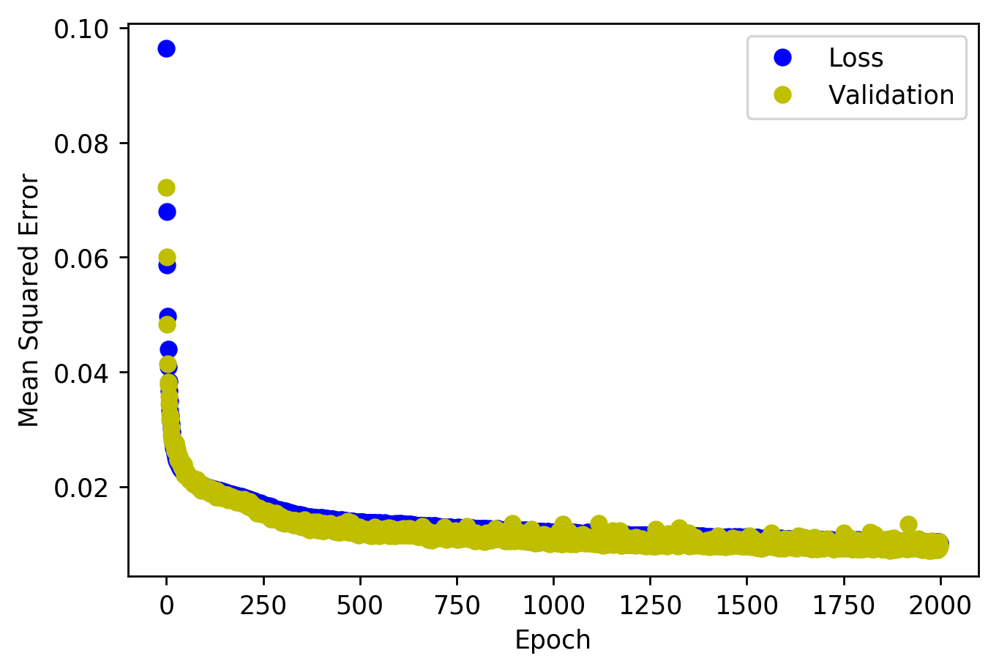

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


<Figure size 432x288 with 0 Axes>

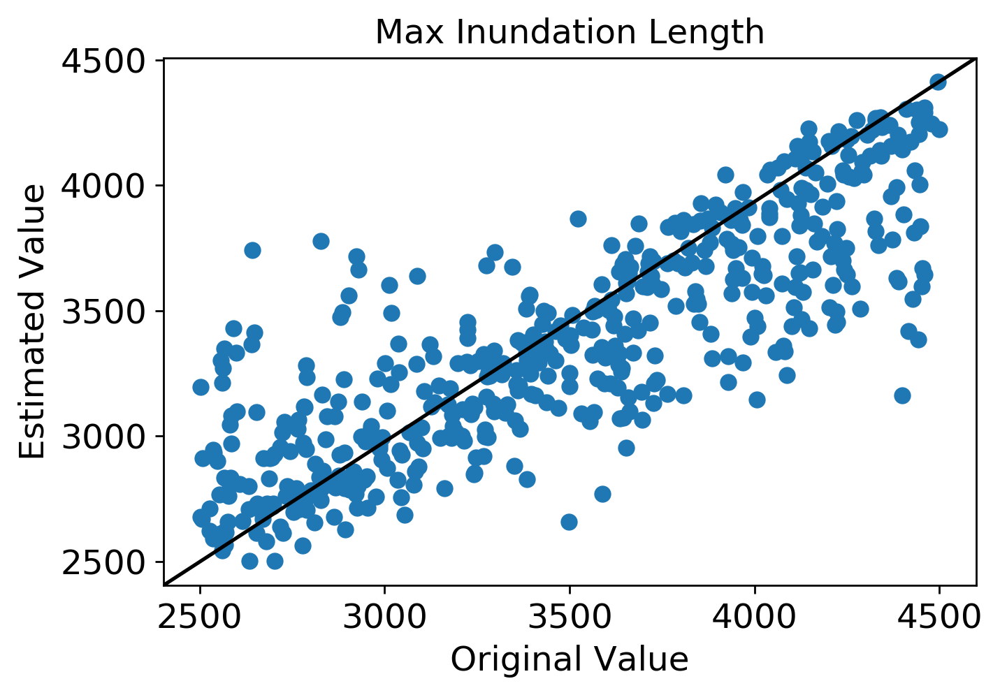

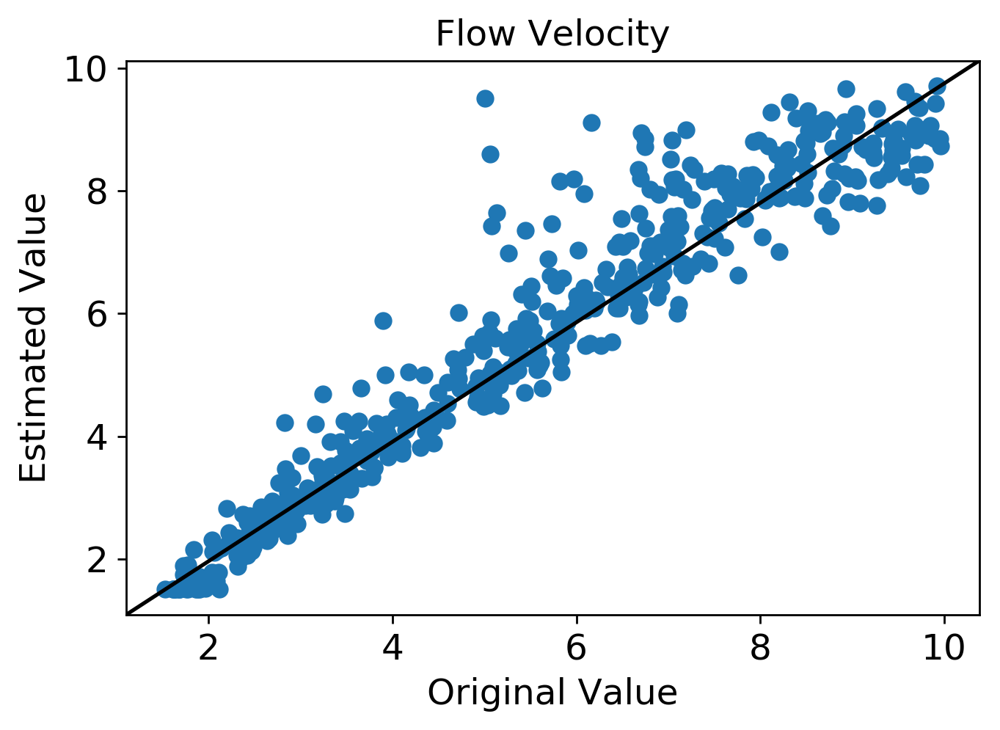

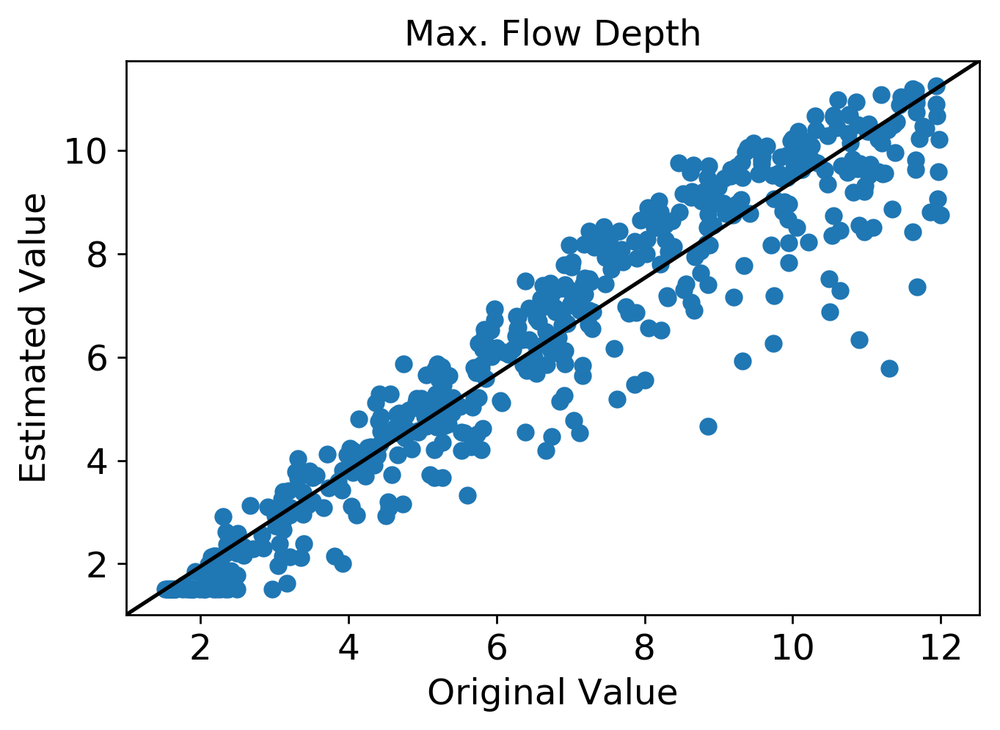

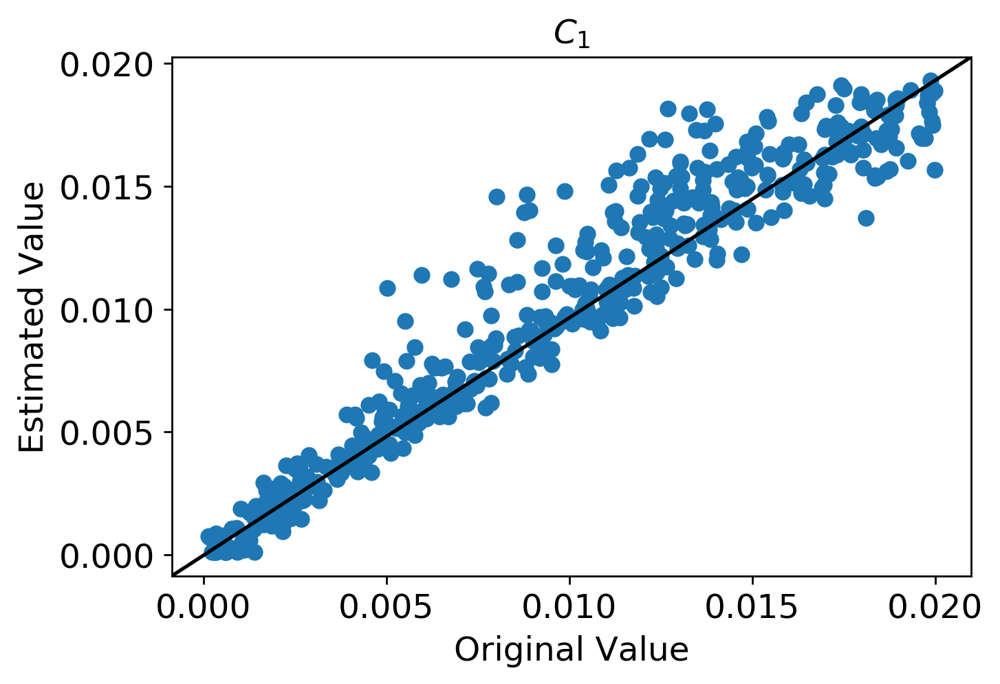

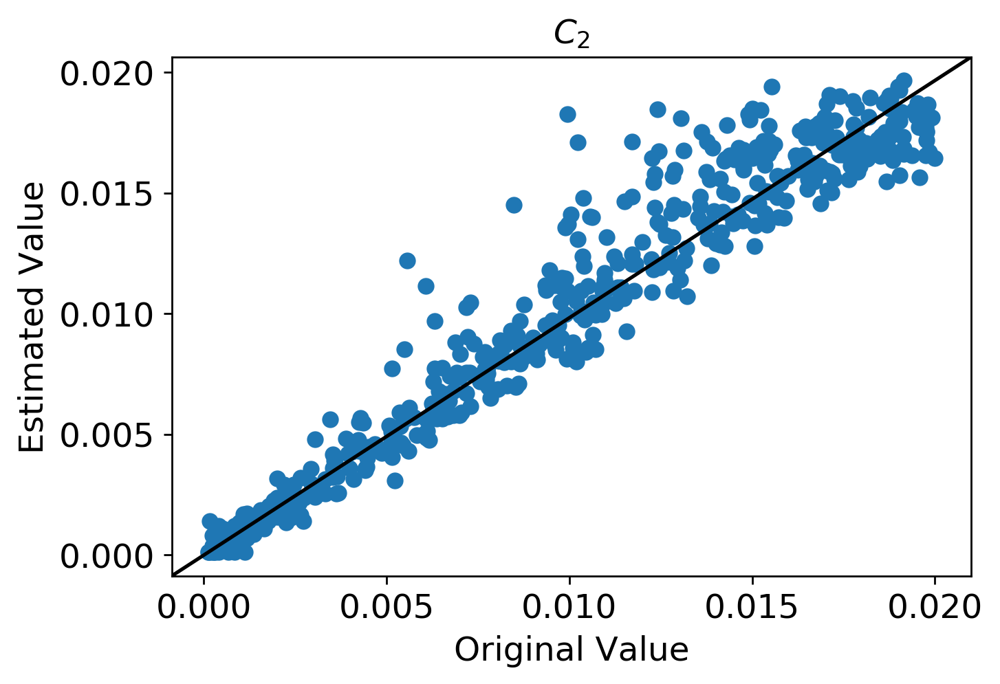

...

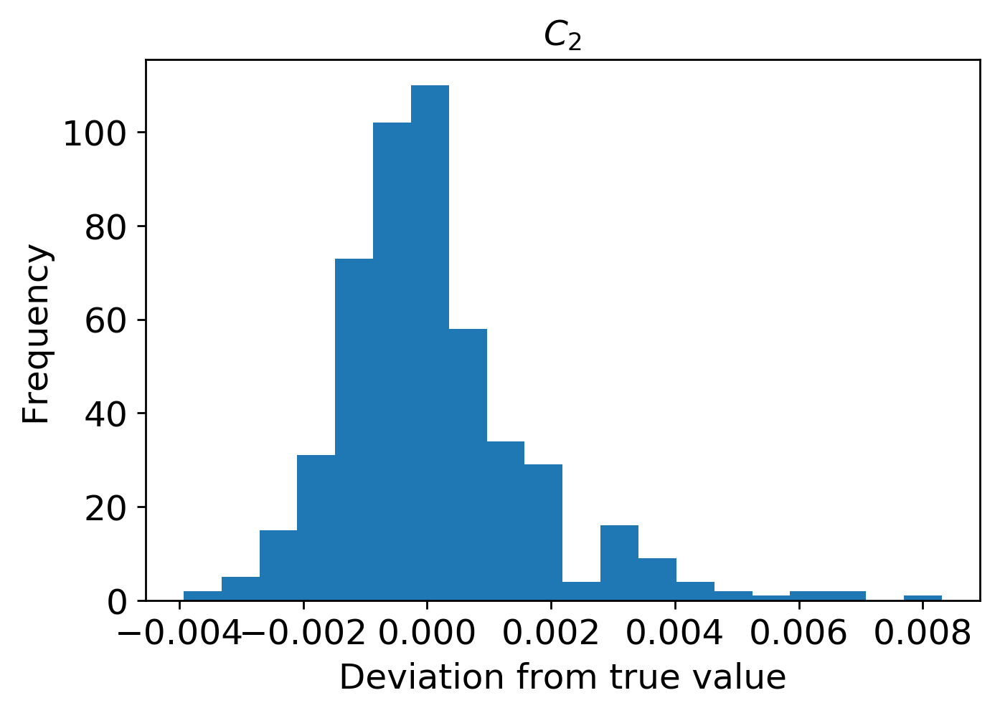

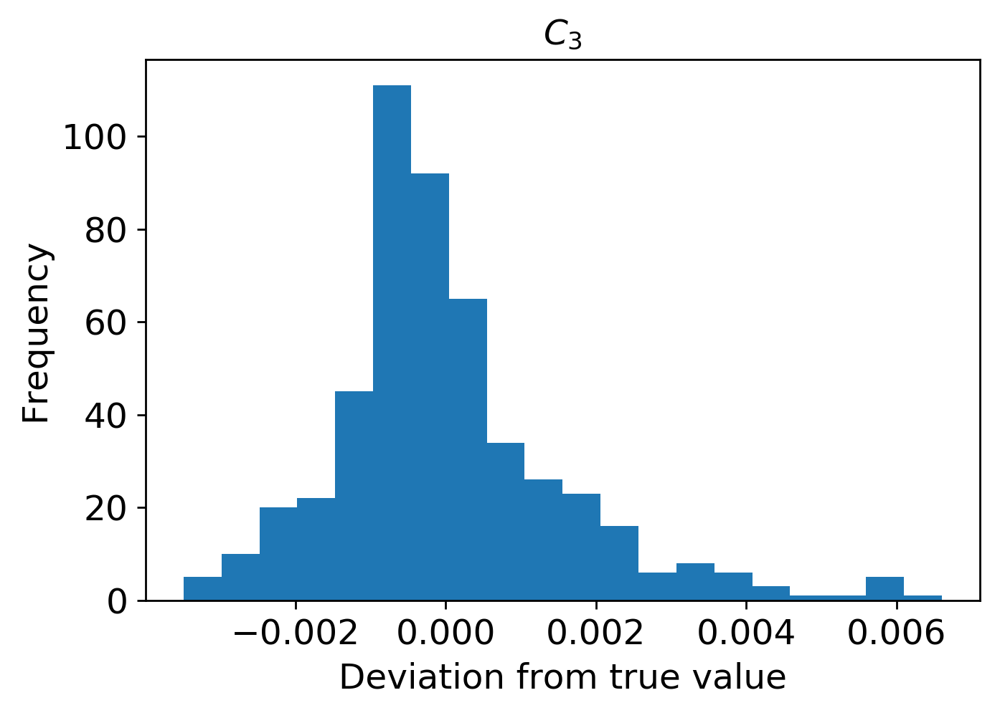

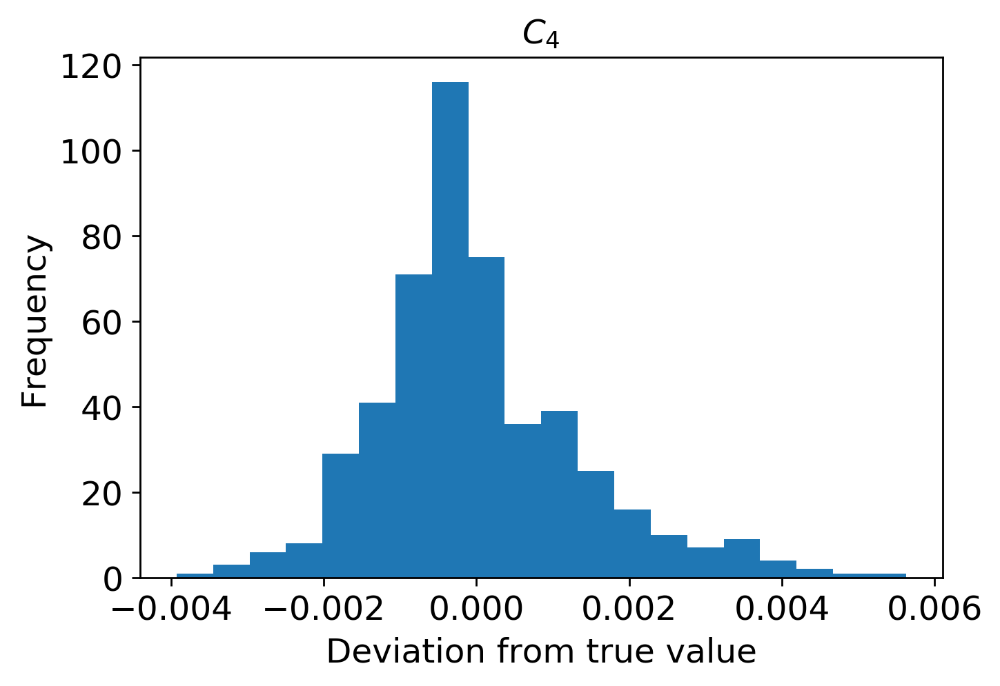

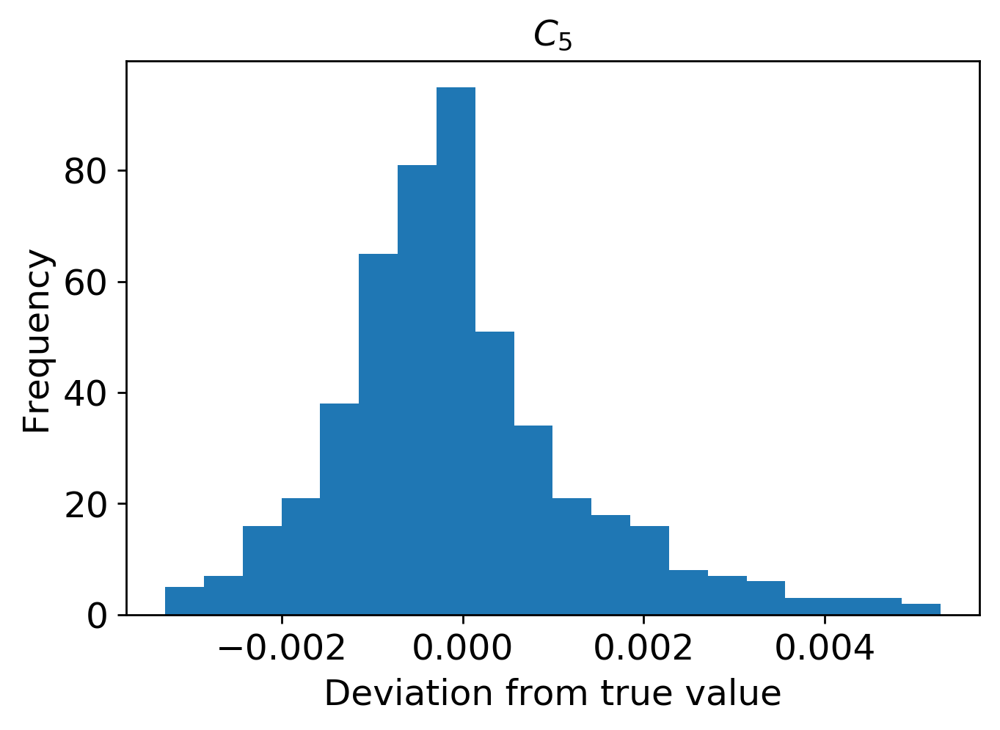

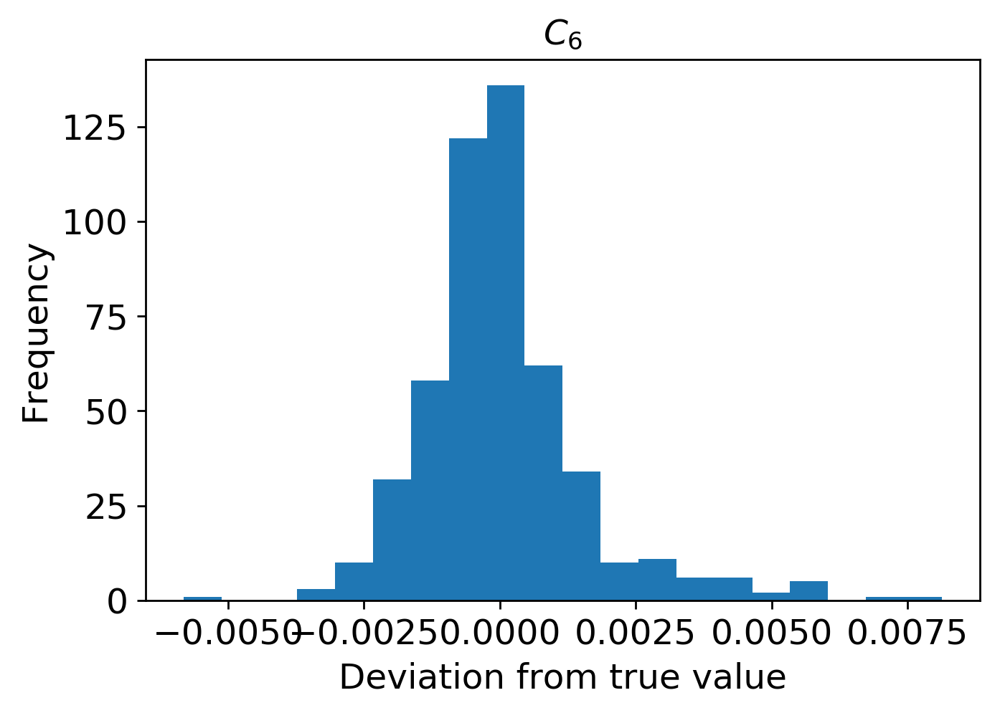

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi200/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

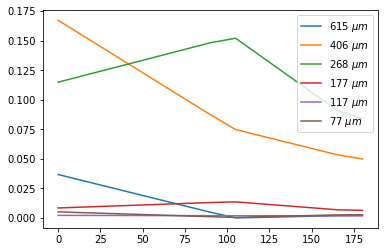

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi200/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='power',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi200.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



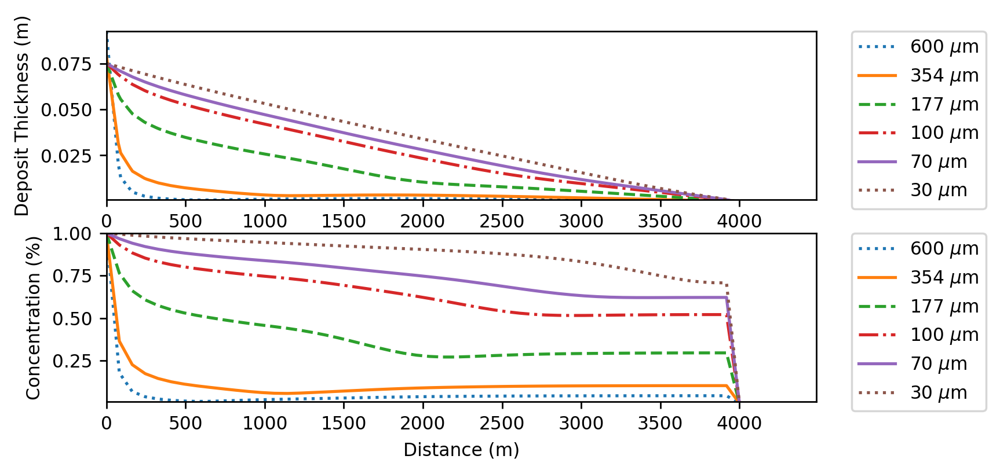

(5000, 9)
(5000, 1800)


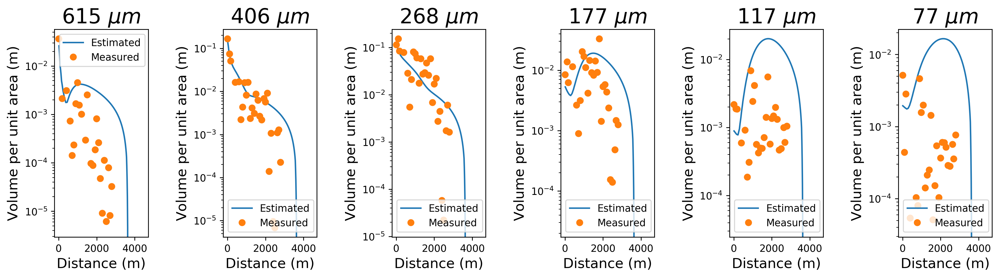

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi200.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi200.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi200.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi200.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi200.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi200.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi200.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi200.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


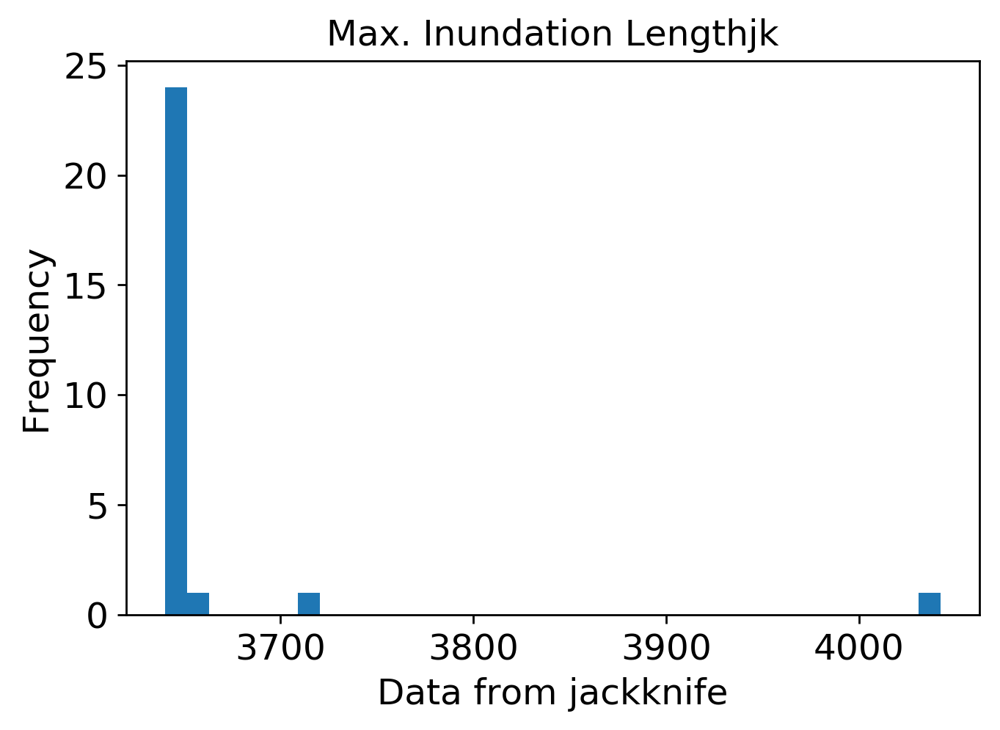

mean: 4.5081072133912965
jk_e: 0.07584632497388634


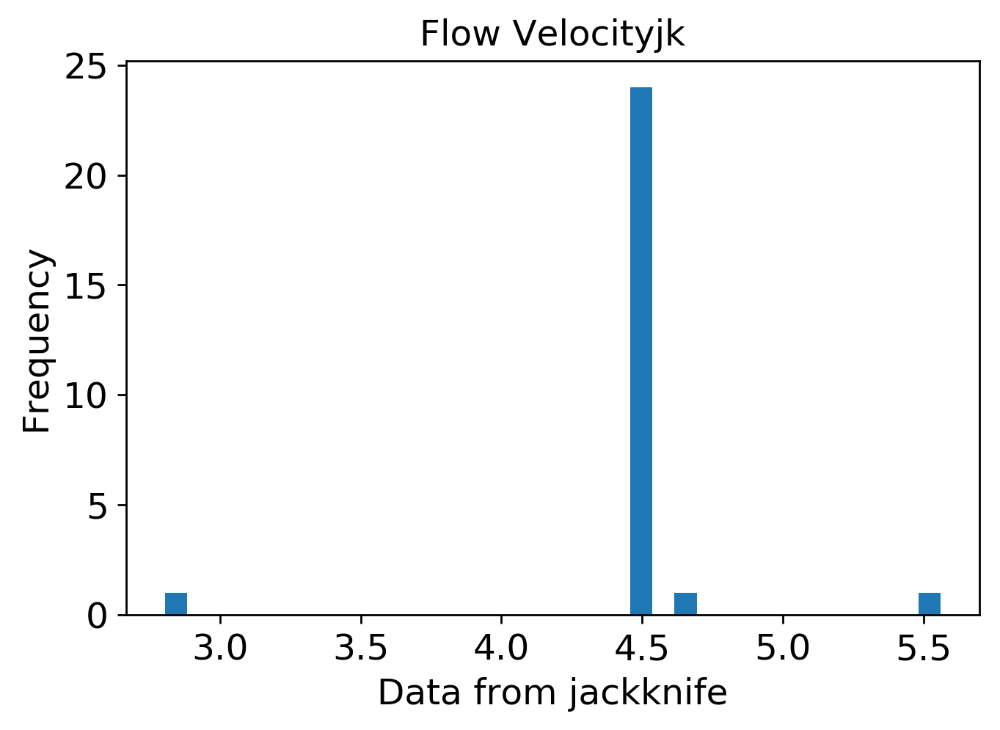

mean: 5.436019973442801
jk_e: 0.08918976698084637


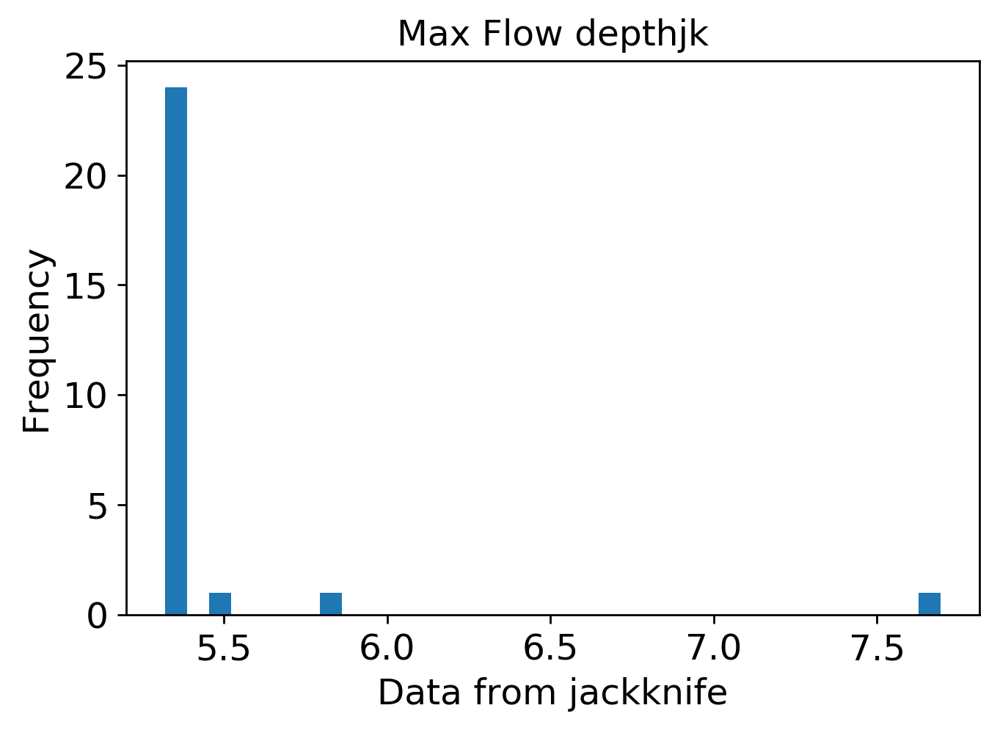

mean: 0.003137457035058343
jk_e: 0.00011784301683807445


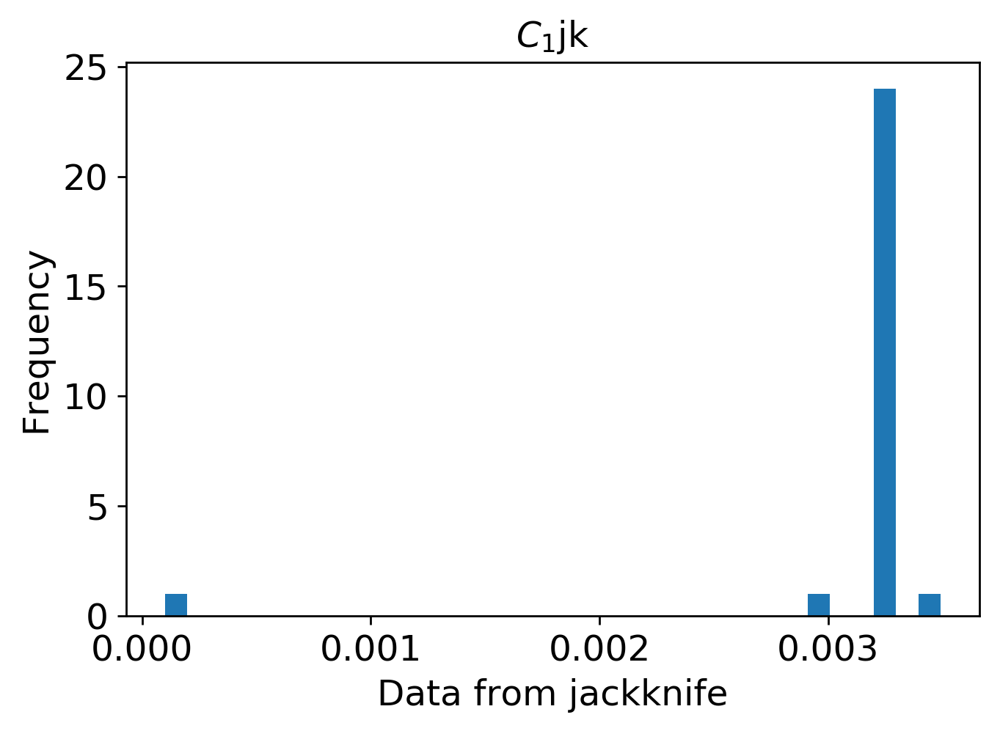

mean: 0.016930011298784044
jk_e: 0.0003062422849700934


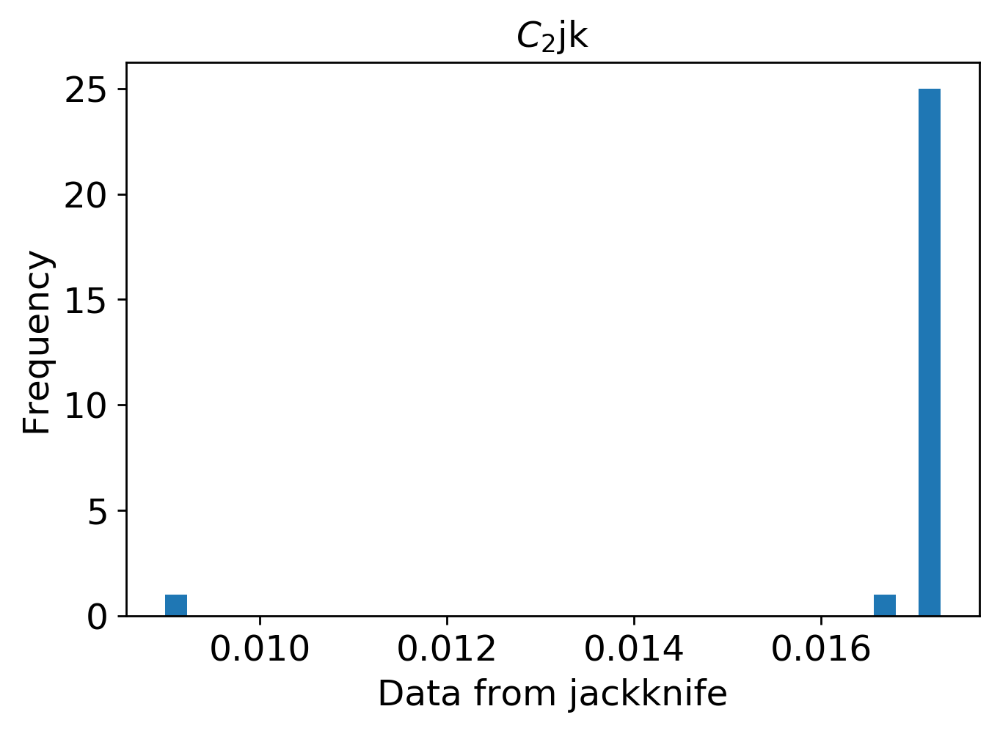

mean: 0.014435631740217716
jk_e: 0.00015981735866774856


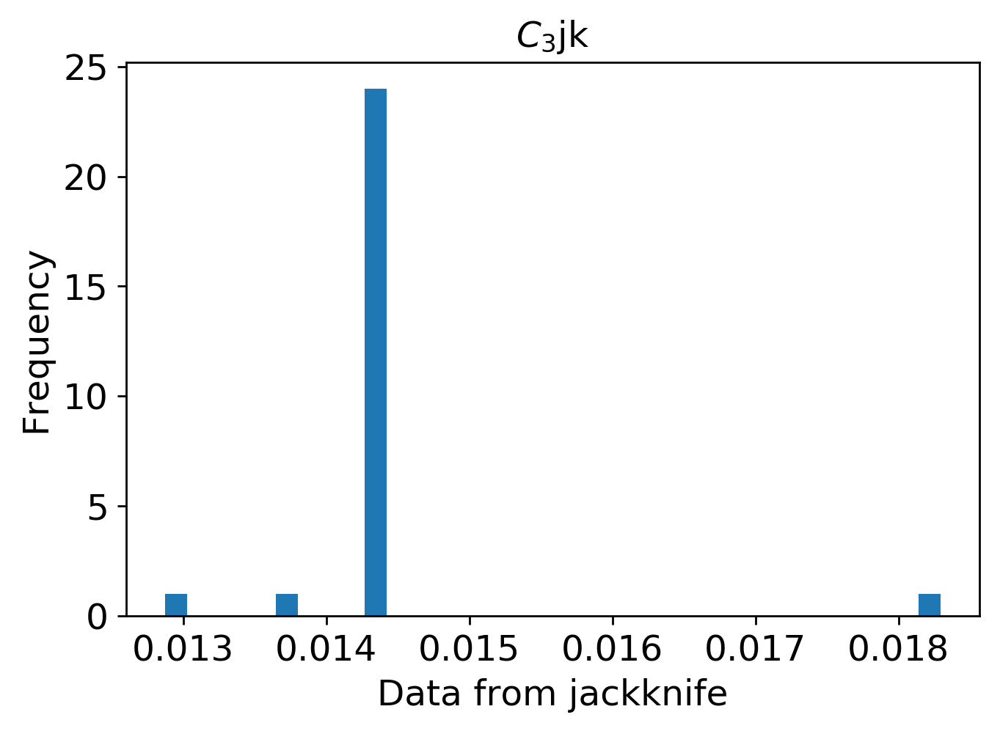

mean: 0.0006150599977753674
jk_e: 2.158224854906081e-05


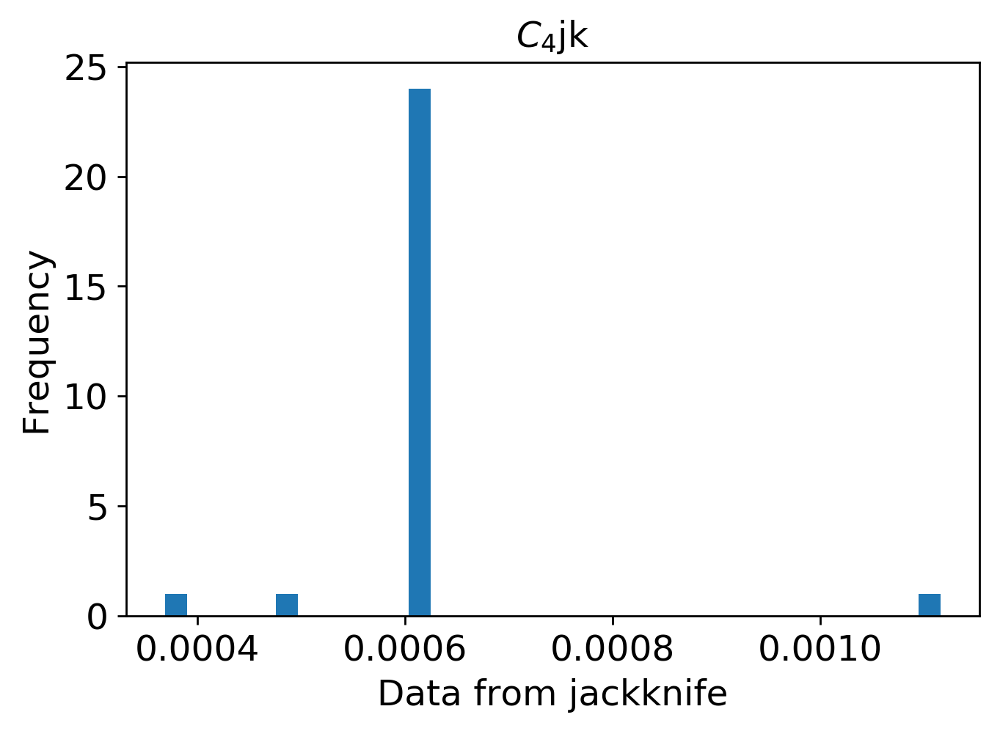

mean: 0.00010136096021857652
jk_e: 0.0


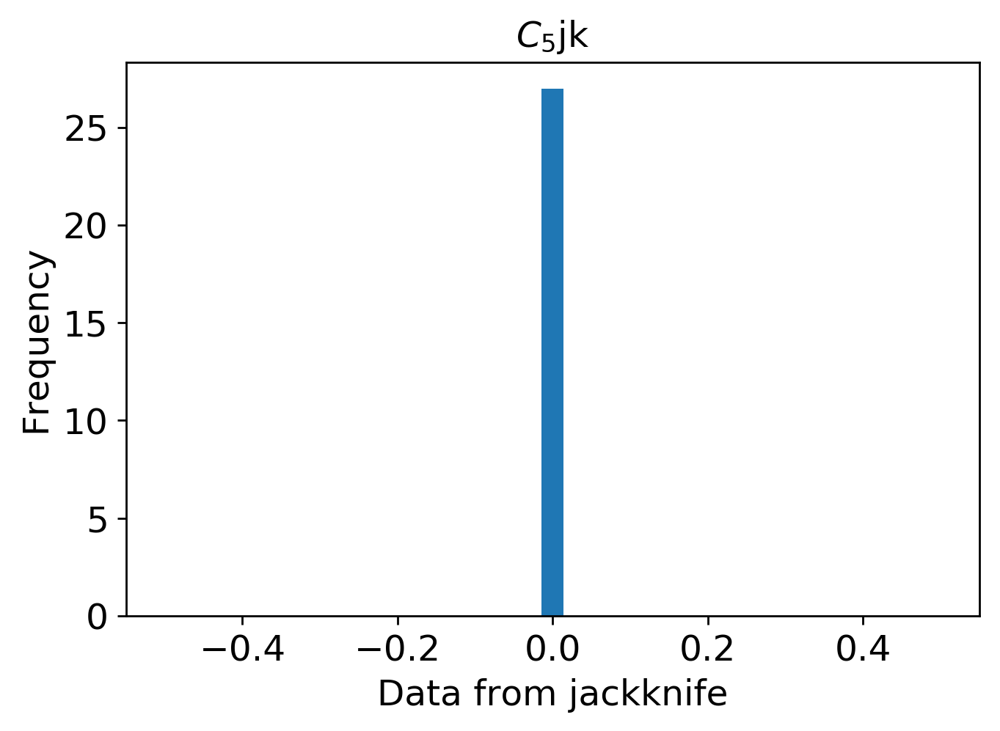

mean: 0.00022373075351927129
jk_e: 1.3759934979300283e-05


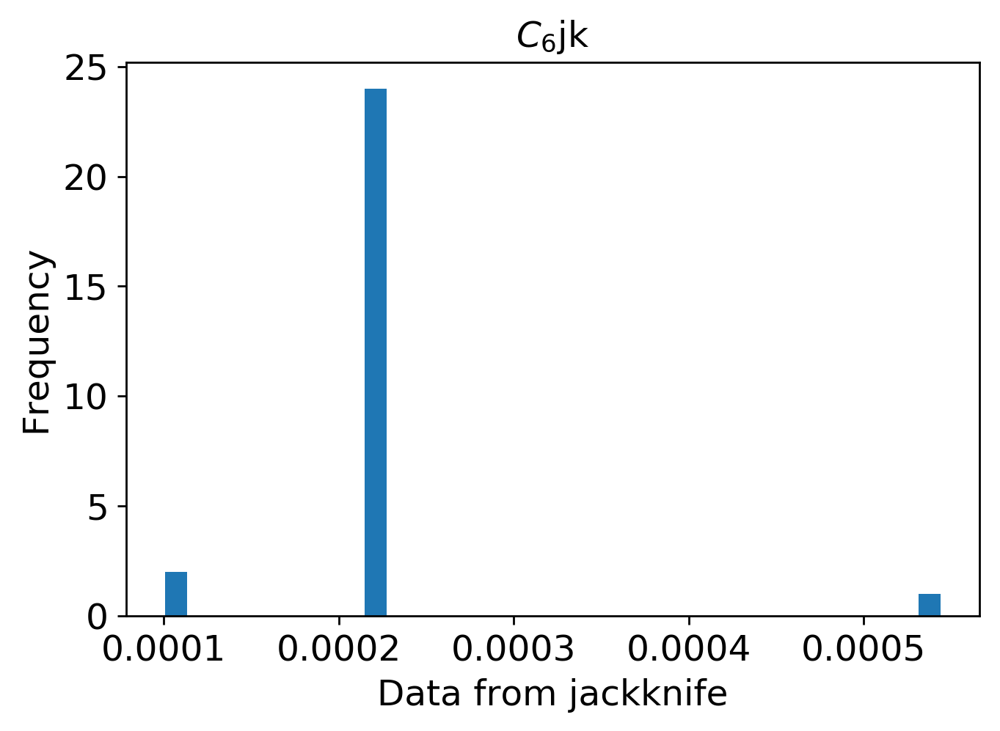

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi200/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi200.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi200.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi200.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 300

In [7]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi300"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=300)
        
        
    

In [ ]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi300/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi300/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Using TensorFlow backend.


Train on 3600 samples, validate on 900 samples
Epoch 1/2000


(500, 9)


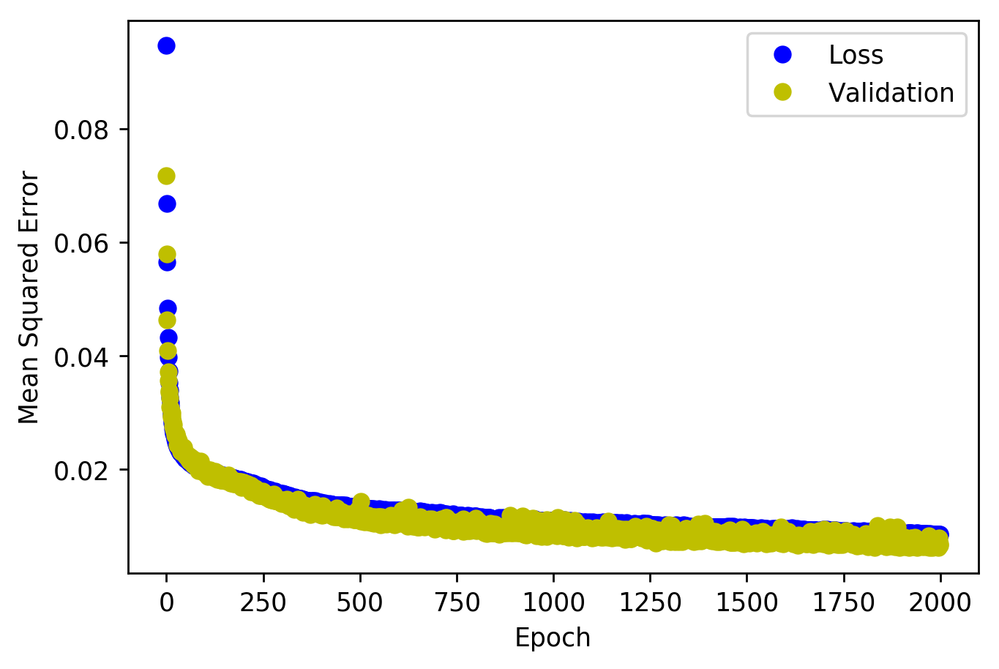

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


<Figure size 432x288 with 0 Axes>

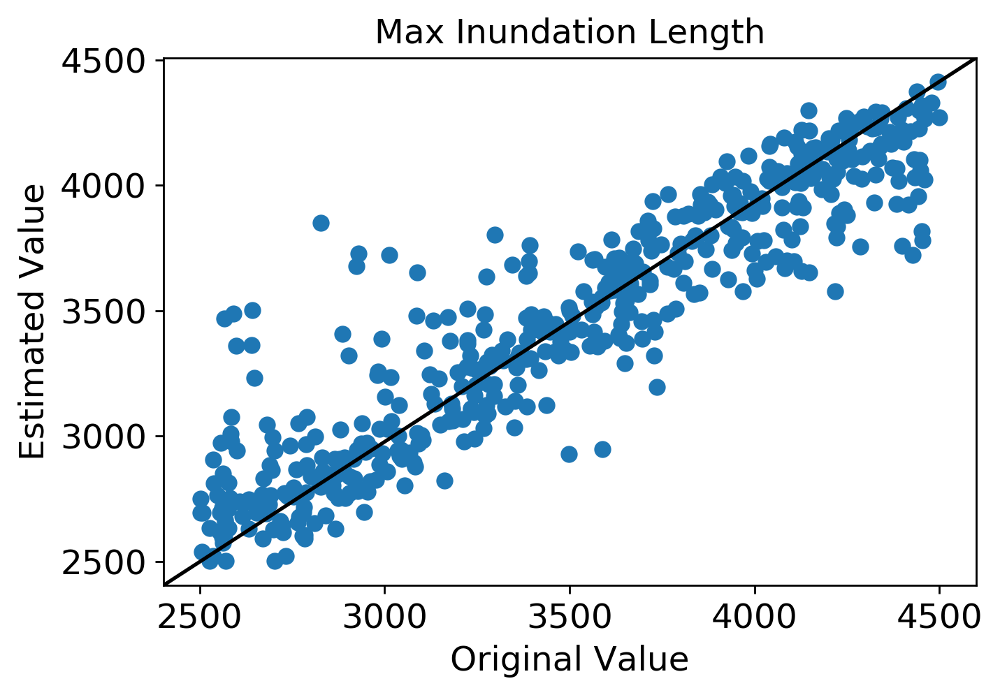

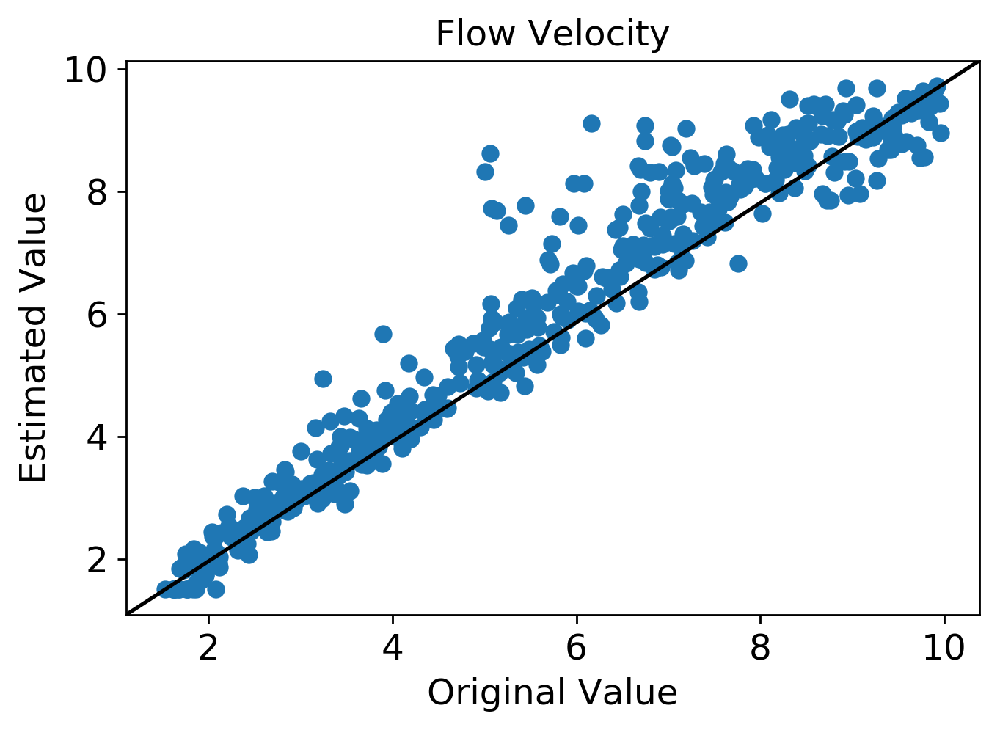

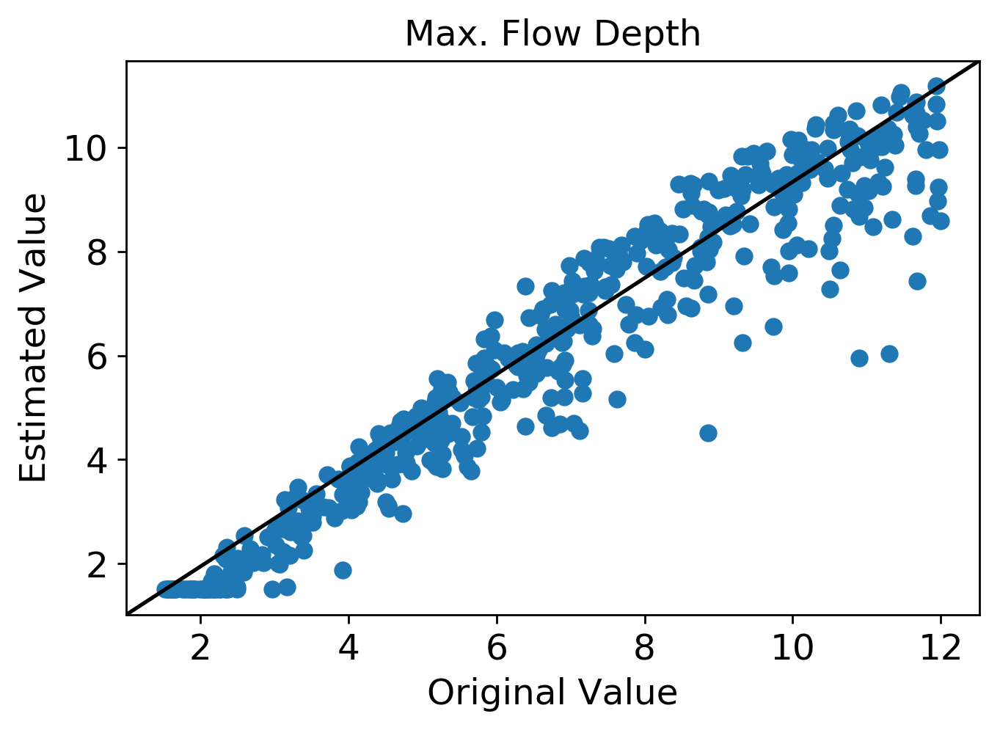

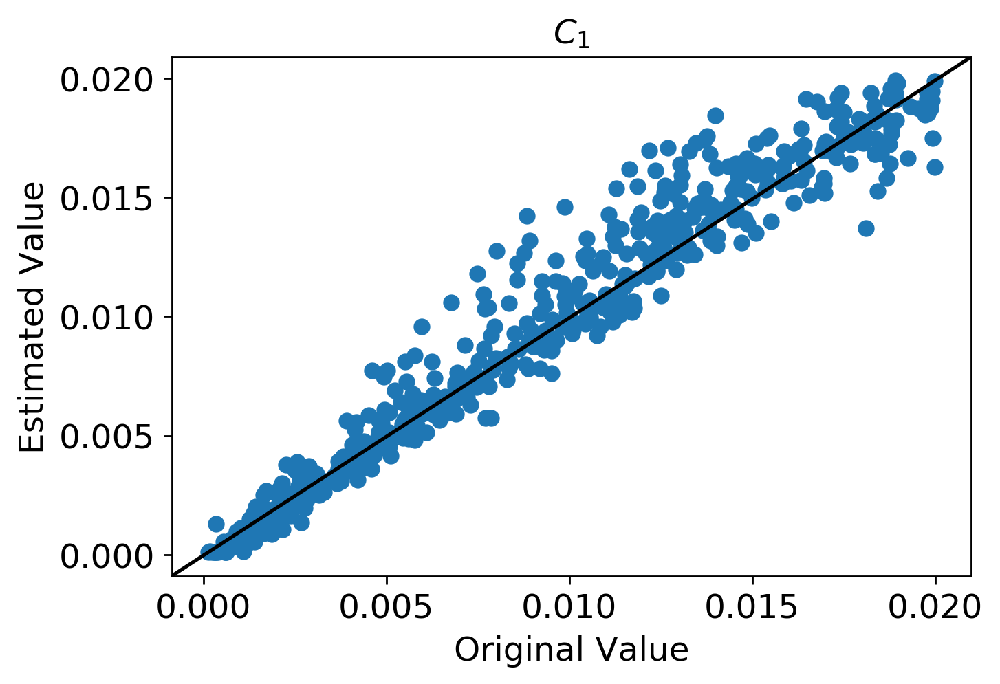

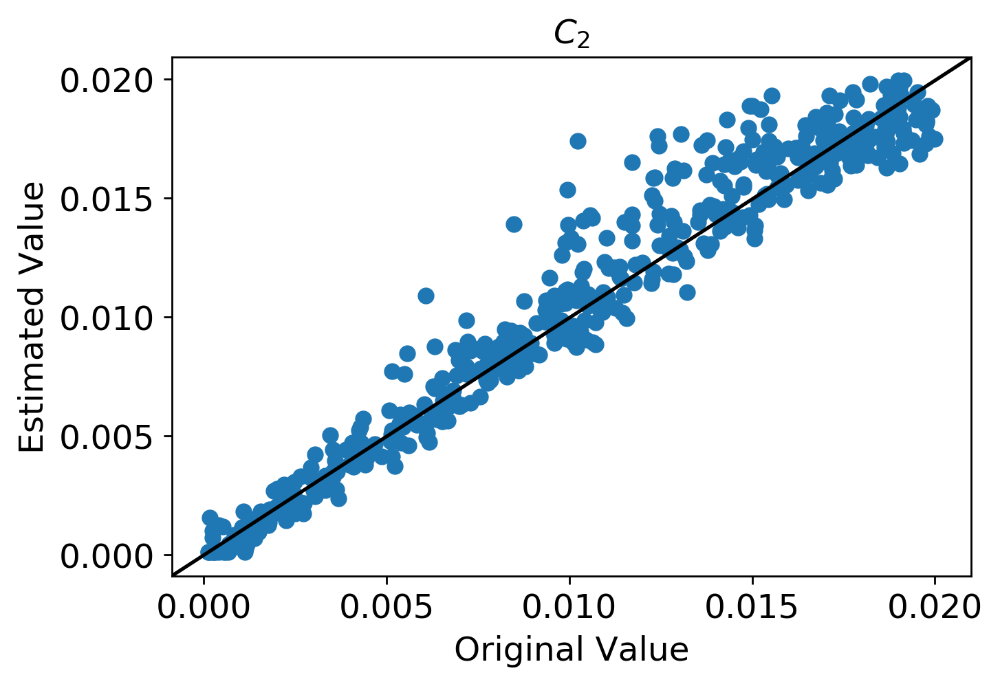

...

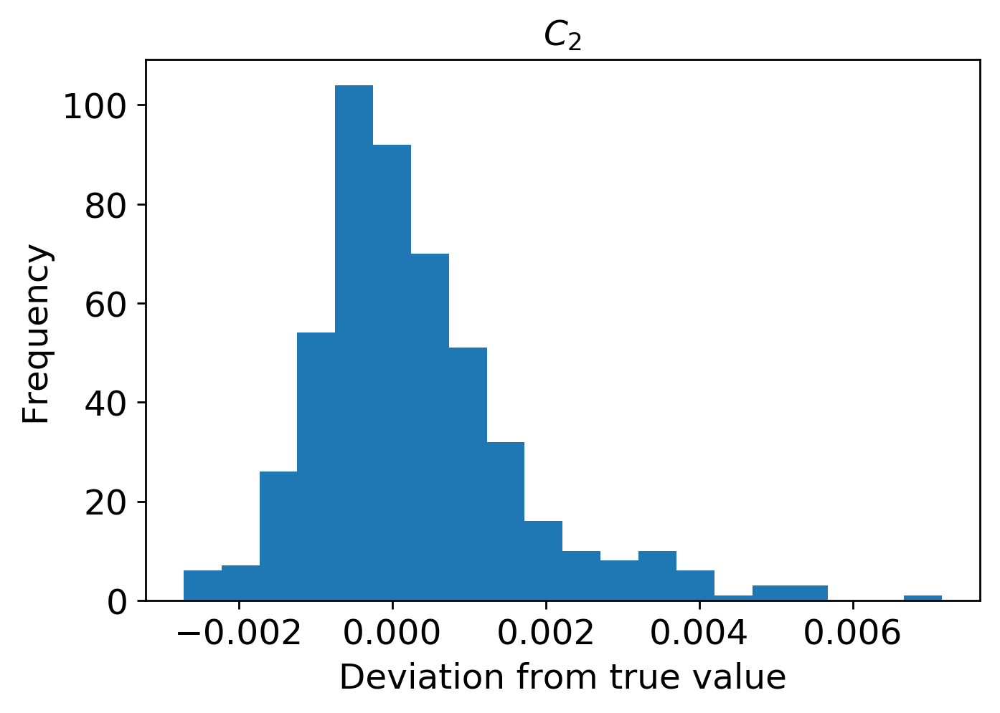

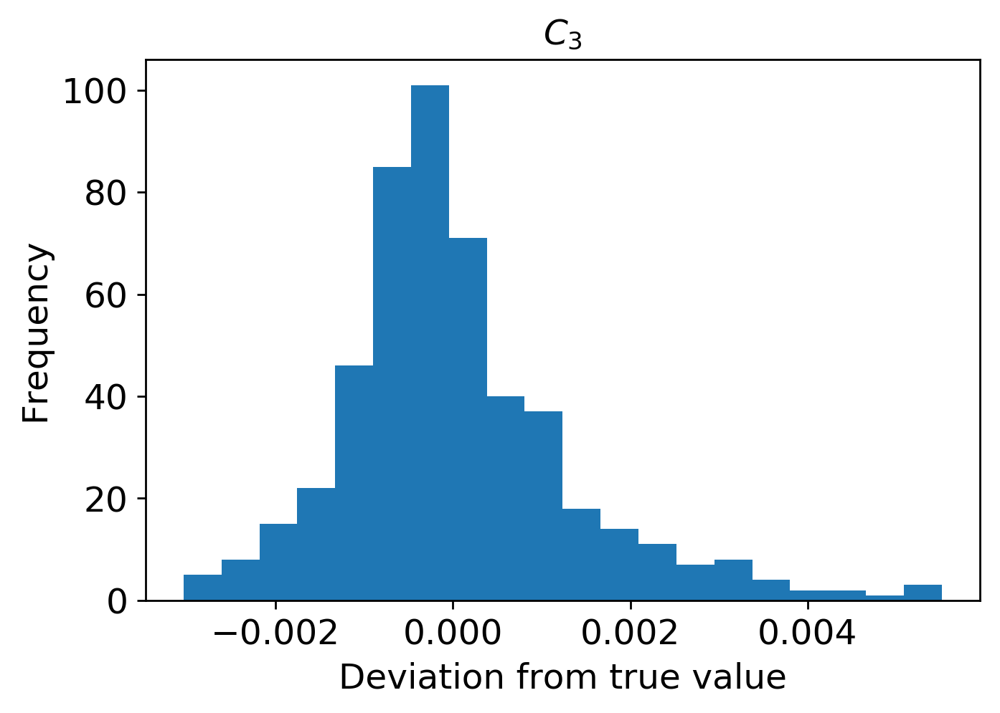

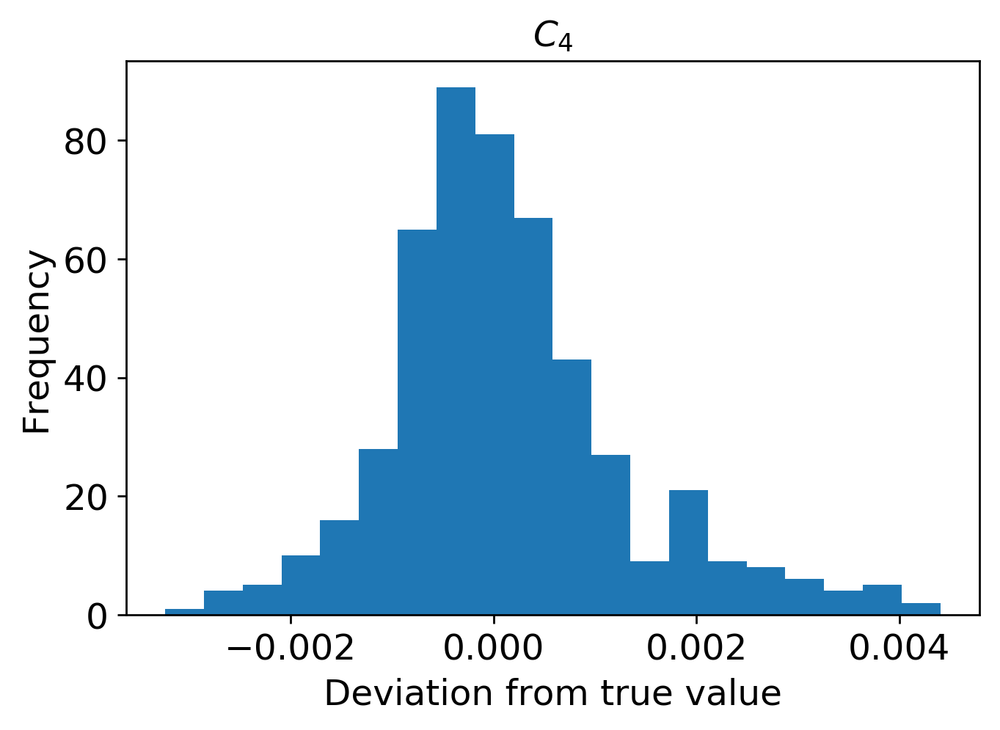

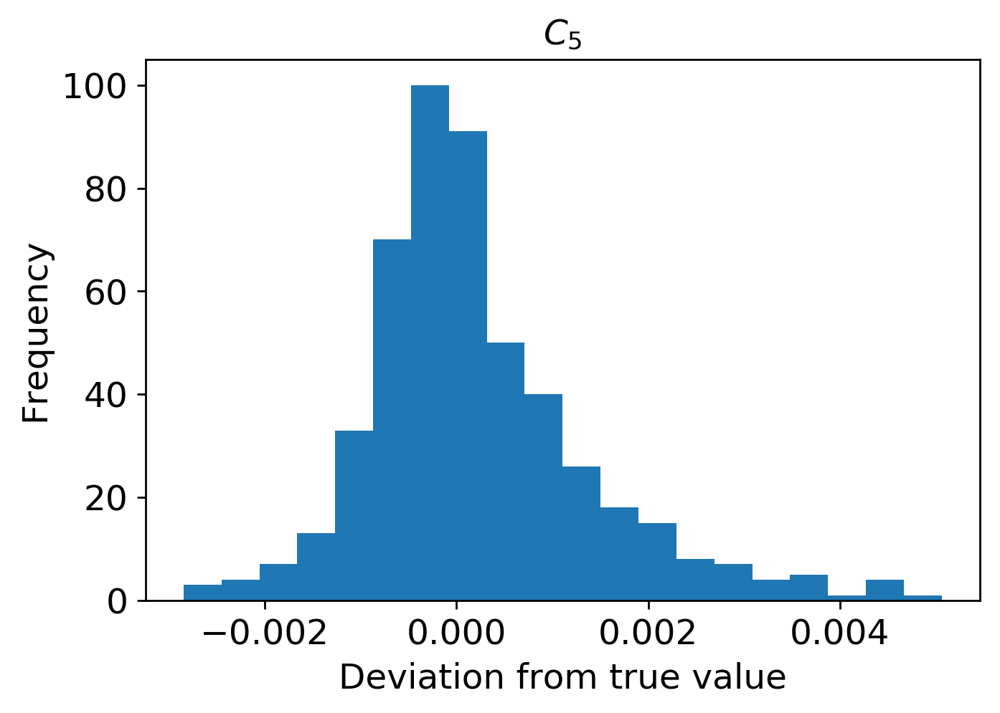

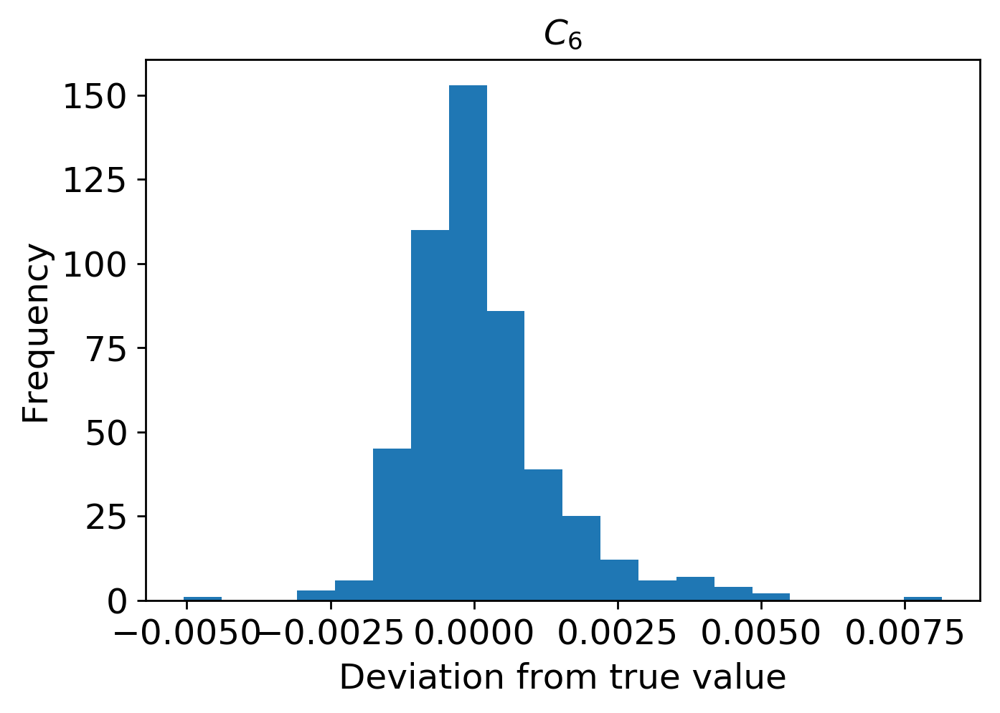

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi300/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

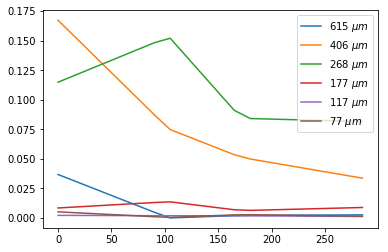

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi300/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi300.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



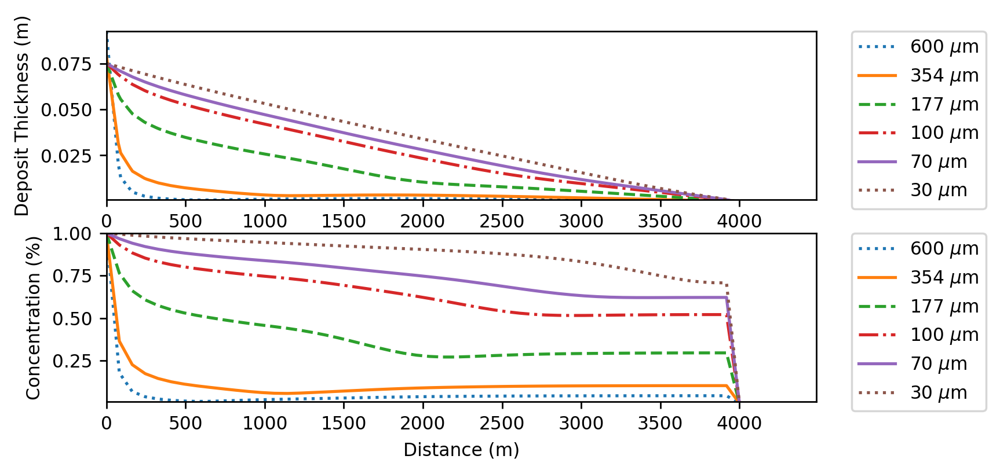

(5000, 9)
(5000, 1800)


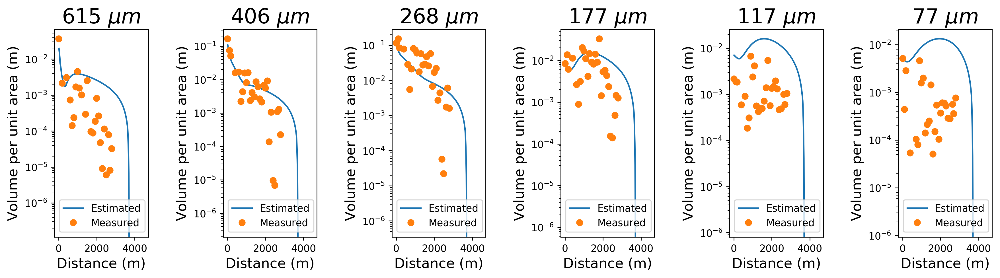

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi300.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi300.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi300.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi300.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi300.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi300.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi300.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi300.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[3.70824275e+03 5.37346010e+00 3.54653157e+00 3.65946930e-03
  1.98082356e-02 1.71833602e-02 1.44462151e-03 1.22095937e-03
  8.30042439e-04]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


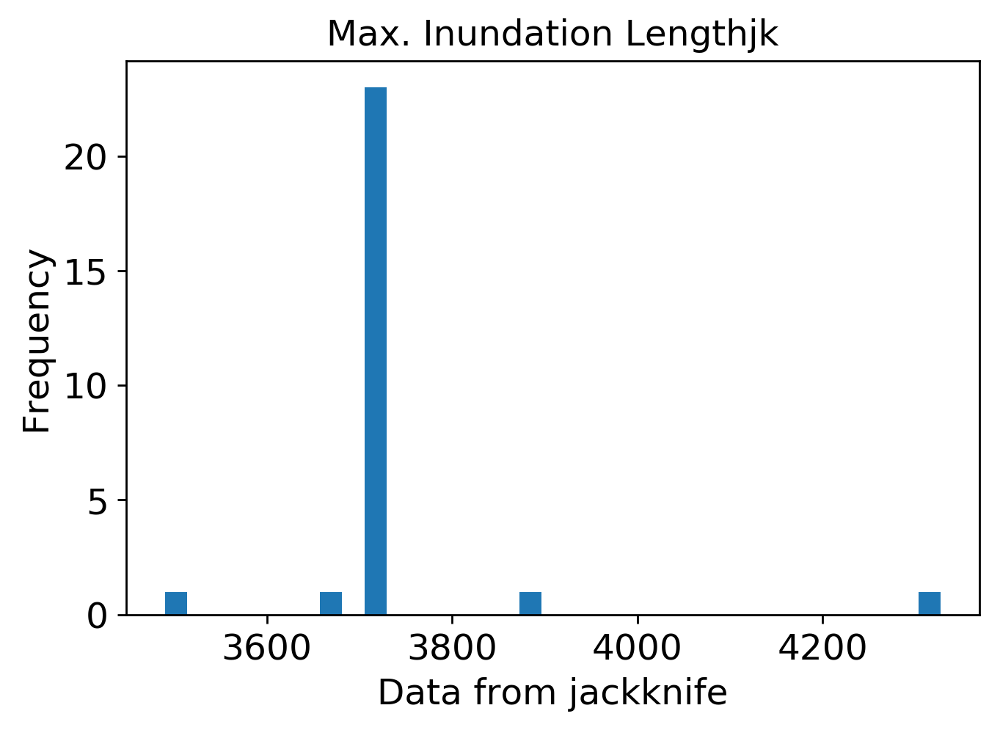

mean: 5.296051728419307
jk_e: 0.09996293819964036


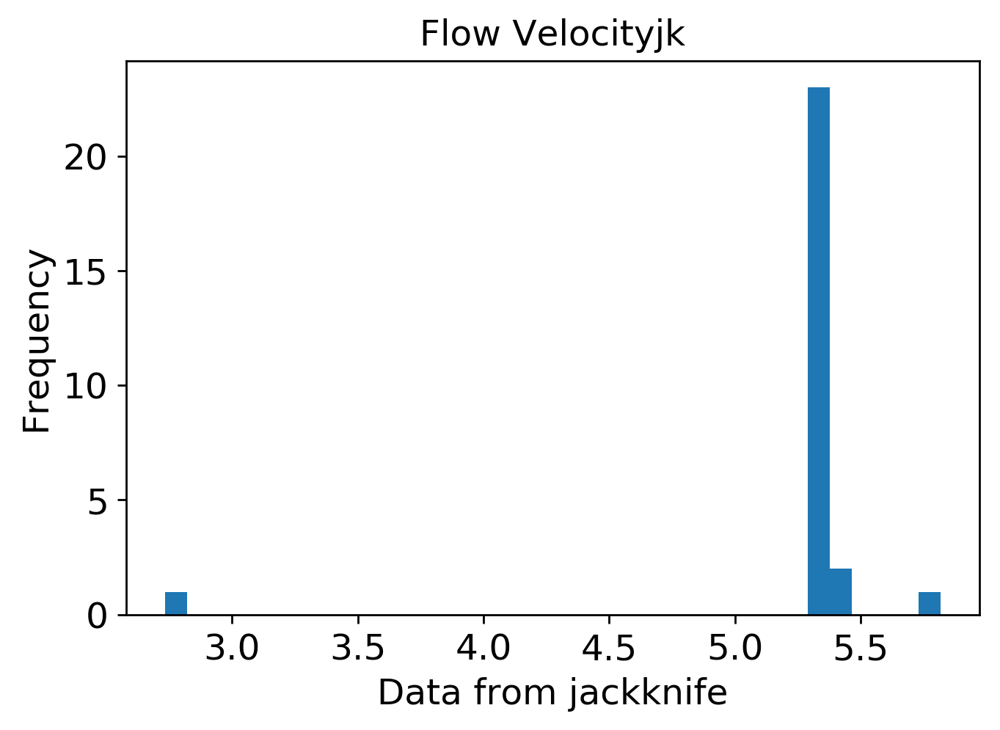

mean: 3.727055903910897
jk_e: 0.1223828477501057


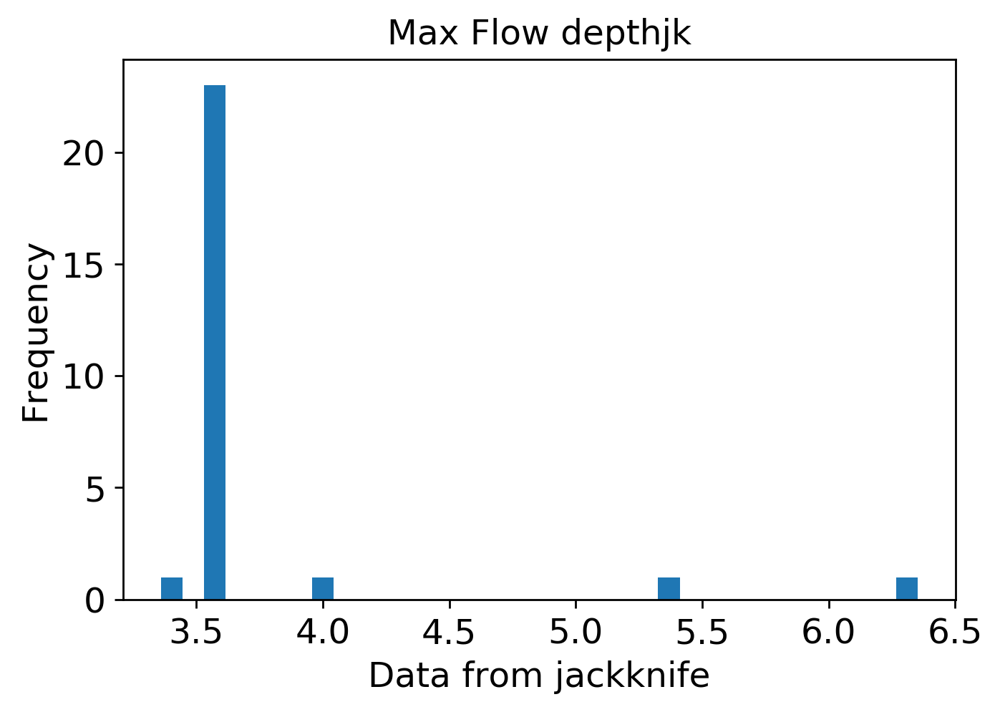

mean: 0.003512633494462672
jk_e: 0.0001346920094820426


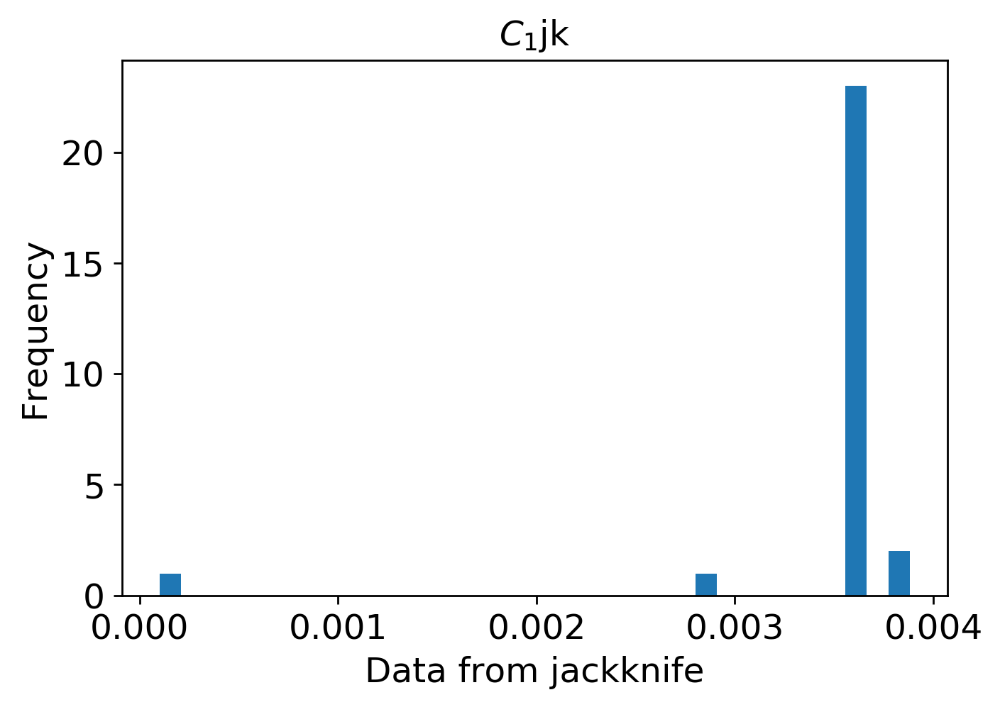

mean: 0.01936442608465525
jk_e: 0.0003495992189677858


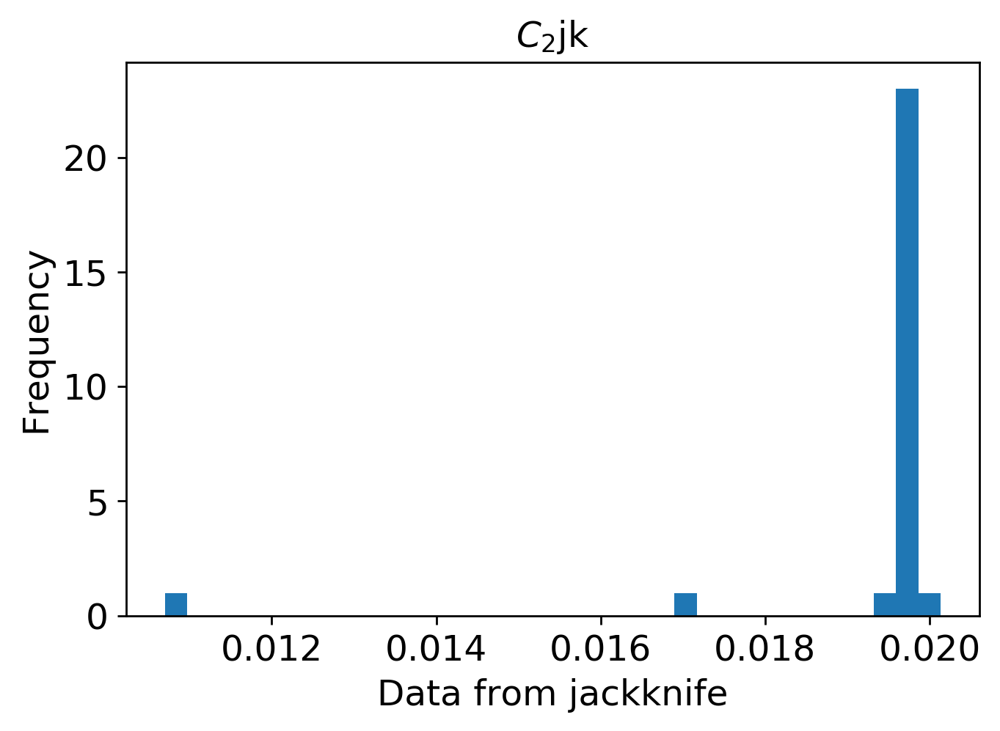

mean: 0.017081848238885602
jk_e: 0.0002022920685618979


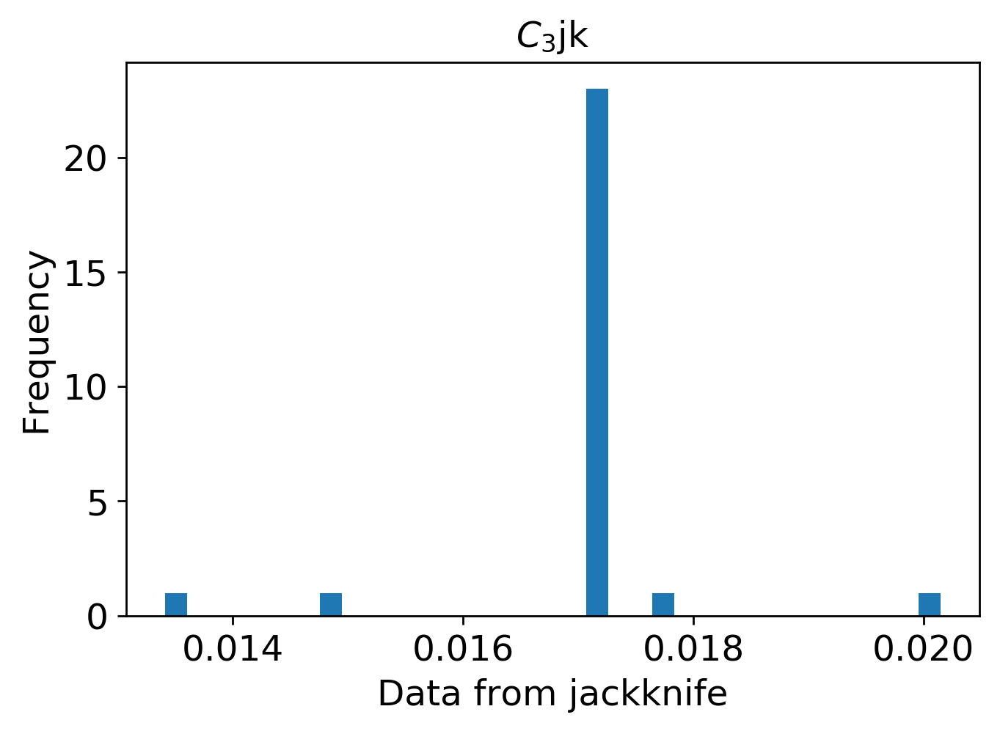

mean: 0.0013832907531423665
jk_e: 4.741825282117963e-05


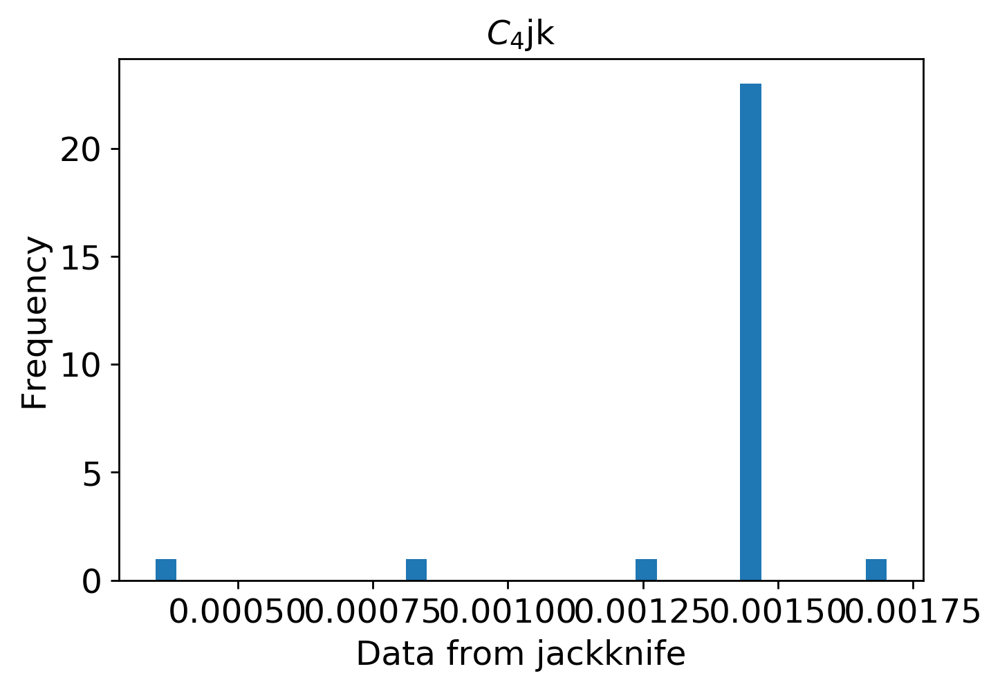

mean: 0.0011409211696424724
jk_e: 5.9076300904567e-05


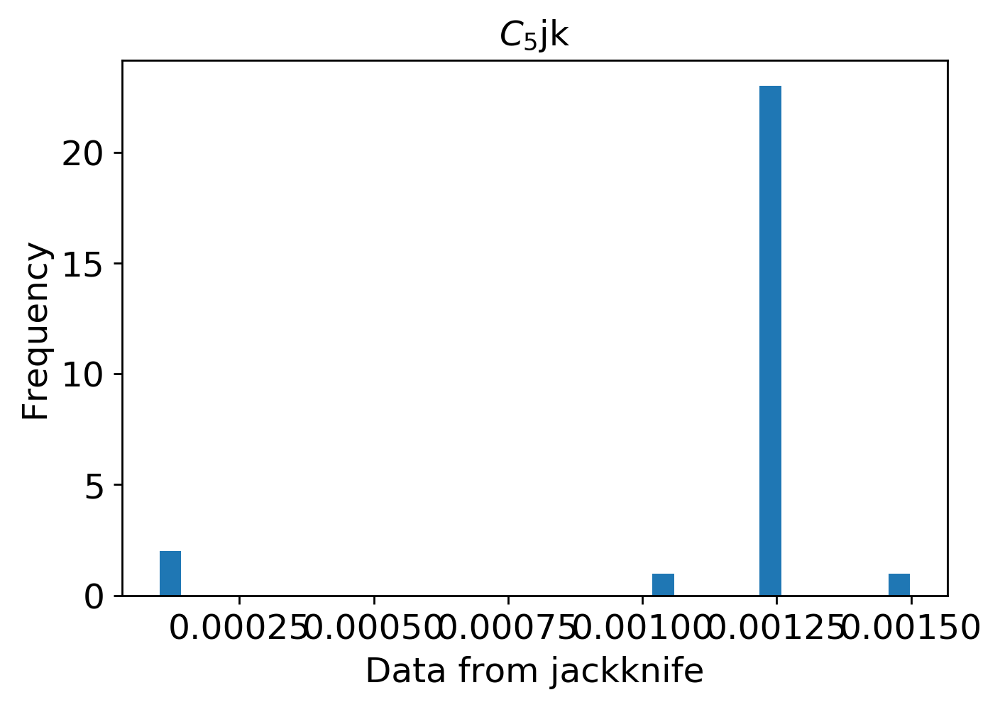

mean: 0.0007800324805582159
jk_e: 3.792865811109517e-05


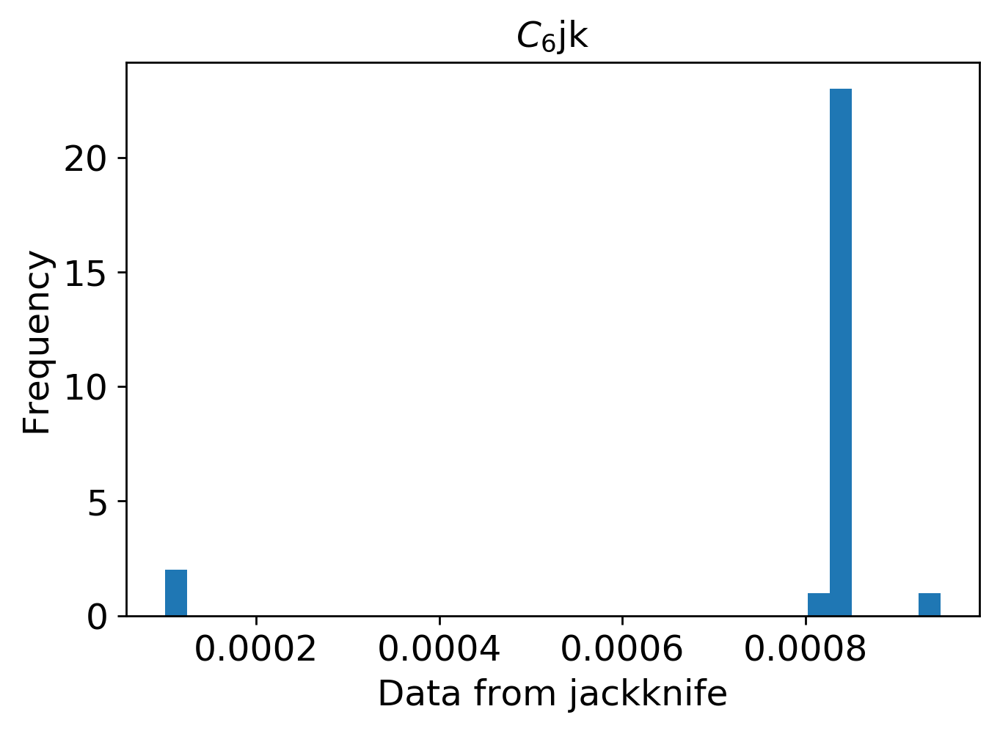

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi300/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi300.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi300.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi300.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 400

In [5]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi400"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=400)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0982 - mean_squared_error: 0.0982 - val_loss: 0.0703 - val_mean_squared_error: 0.0703
Epoch 2/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0663 - mean_squared_error: 0.0663 - val_loss: 0.0565 - val_mean_squared_error: 0.0565
Epoch 3/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0561 - mean_squared_error: 0.0561 - val_loss: 0.0465 - val_mean_squared_error: 0.0465
Epoch 4/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0483 - mean_squared_error: 0.0483 - val_loss: 0.0409 - val_mean_squared_error: 0.0409
Epoch 5/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0435 - mean_squared_error: 0.0435 - val_loss: 0.0374 - val_mean_squared_error: 0.0374
Epoch 6/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0395 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 340us/step - loss: 0.0197 - mean_squared_error: 0.0197 - val_loss: 0.0194 - val_mean_squared_error: 0.0194
Epoch 98/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0198 - mean_squared_error: 0.0198 - val_loss: 0.0201 - val_mean_squared_error: 0.0201
Epoch 99/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0197 - mean_squared_error: 0.0197 - val_loss: 0.0192 - val_mean_squared_error: 0.0192
Epoch 100/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0198 - mean_squared_error: 0.0198 - val_loss: 0.0192 - val_mean_squared_error: 0.0192
Epoch 101/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0198 - mean_squared_error: 0.0198 - val_loss: 0.0197 - val_mean_squared_error: 0.0197
Epoch 102/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0196 - mean_squared_error: 0.0196 - val_loss: 0.0195 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 345us/step - loss: 0.0177 - mean_squared_error: 0.0177 - val_loss: 0.0169 - val_mean_squared_error: 0.0169
Epoch 194/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0178 - mean_squared_error: 0.0178 - val_loss: 0.0163 - val_mean_squared_error: 0.0163
Epoch 195/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0178 - mean_squared_error: 0.0178 - val_loss: 0.0168 - val_mean_squared_error: 0.0168
Epoch 196/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0177 - mean_squared_error: 0.0177 - val_loss: 0.0169 - val_mean_squared_error: 0.0169
Epoch 197/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0176 - mean_squared_error: 0.0176 - val_loss: 0.0168 - val_mean_squared_error: 0.0168
Epoch 198/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0176 - mean_squared_error: 0.0176 - val_loss: 0.0166 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 347us/step - loss: 0.0151 - mean_squared_error: 0.0151 - val_loss: 0.0138 - val_mean_squared_error: 0.0138
Epoch 290/2000
3600/3600 [==============================] - 1s 324us/step - loss: 0.0149 - mean_squared_error: 0.0149 - val_loss: 0.0133 - val_mean_squared_error: 0.0133
Epoch 291/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0150 - mean_squared_error: 0.0150 - val_loss: 0.0137 - val_mean_squared_error: 0.0137
Epoch 292/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0150 - mean_squared_error: 0.0150 - val_loss: 0.0130 - val_mean_squared_error: 0.0130
Epoch 293/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0149 - mean_squared_error: 0.0149 - val_loss: 0.0131 - val_mean_squared_error: 0.0131
Epoch 294/2000
3600/3600 [==============================] - 1s 321us/step - loss: 0.0149 - mean_squared_error: 0.0149 - val_loss: 0.0128 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 359us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 386/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0129 - mean_squared_error: 0.0129 - val_loss: 0.0119 - val_mean_squared_error: 0.0119
Epoch 387/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 388/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 389/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0112 - val_mean_squared_error: 0.0112
Epoch 390/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0131 - mean_squared_error: 0.0131 - val_loss: 0.0106 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0093 - val_mean_squared_error: 0.0093
Epoch 482/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0097 - val_mean_squared_error: 0.0097
Epoch 483/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0117 - mean_squared_error: 0.0117 - val_loss: 0.0091 - val_mean_squared_error: 0.0091
Epoch 484/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0091 - val_mean_squared_error: 0.0091
Epoch 485/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0089 - val_mean_squared_error: 0.0089
Epoch 486/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0119 - mean_squared_error: 0.0119 - val_loss: 0.0105 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0077 - val_mean_squared_error: 0.0077
Epoch 578/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0082 - val_mean_squared_error: 0.0082
Epoch 579/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0081 - val_mean_squared_error: 0.0081
Epoch 580/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0076 - val_mean_squared_error: 0.0076
Epoch 581/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0088 - val_mean_squared_error: 0.0088
Epoch 582/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0077 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 338us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0076 - val_mean_squared_error: 0.0076
Epoch 674/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0086 - val_mean_squared_error: 0.0086
Epoch 675/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0081 - val_mean_squared_error: 0.0081
Epoch 676/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0104 - mean_squared_error: 0.0104 - val_loss: 0.0074 - val_mean_squared_error: 0.0074
Epoch 677/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0074 - val_mean_squared_error: 0.0074
Epoch 678/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0103 - mean_squared_error: 0.0103 - val_loss: 0.0076 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 356us/step - loss: 0.0100 - mean_squared_error: 0.0100 - val_loss: 0.0080 - val_mean_squared_error: 0.0080
Epoch 770/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0076 - val_mean_squared_error: 0.0076
Epoch 771/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0099 - mean_squared_error: 0.0099 - val_loss: 0.0072 - val_mean_squared_error: 0.0072
Epoch 772/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0099 - mean_squared_error: 0.0099 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 773/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0099 - mean_squared_error: 0.0099 - val_loss: 0.0072 - val_mean_squared_error: 0.0072
Epoch 774/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0100 - mean_squared_error: 0.0100 - val_loss: 0.0072 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 325us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0078 - val_mean_squared_error: 0.0078
Epoch 866/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 867/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 868/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 869/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0075 - val_mean_squared_error: 0.0075
Epoch 870/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0086 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 349us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 962/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 963/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 964/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 965/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0072 - val_mean_squared_error: 0.0072
Epoch 966/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0070 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 360us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 1058/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 1059/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 1060/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1061/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 1062/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0062 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 1106/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 1107/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 1108/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 1109/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 1110/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0056 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 1154/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 1155/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 1156/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 1157/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 1158/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0063 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 1202/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 1203/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 1204/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 1205/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1206/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0068 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0073 - val_mean_squared_error: 0.0073
Epoch 1250/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 1251/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 1252/2000
3600/3600 [==============================] - 1s 325us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 1253/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1254/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0062 - val_mean_squared_erro

3600/3600 [==============================] - 1s 352us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1298/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 1299/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 1300/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 1301/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 1302/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0056 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 1346/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 1347/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1348/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 1349/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 1350/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0058 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 1394/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 1395/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 1396/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 1397/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 1398/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0058 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1442/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 1443/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 1444/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 1445/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 1446/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0065 - val_mean_squared_erro

3600/3600 [==============================] - 1s 376us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 1490/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1491/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 1492/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 1493/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1494/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0062 - val_mean_squared_erro

3600/3600 [==============================] - 1s 327us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 1538/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 1539/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1540/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1541/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1542/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0063 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1586/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 1587/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 1588/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 1589/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1590/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0062 - val_mean_squared_erro

3600/3600 [==============================] - 1s 333us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 1634/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 1635/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 1636/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 1637/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 1638/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0053 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1682/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1683/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 1684/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 1685/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1686/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0050 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 1730/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 1731/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1732/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 1733/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 1734/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0047 - val_mean_squared_erro

3600/3600 [==============================] - 1s 333us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1778/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 1779/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 1780/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1781/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 1782/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0047 - val_mean_squared_erro

3600/3600 [==============================] - 1s 338us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1826/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1827/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 1828/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 1829/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1830/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0056 - val_mean_squared_erro

3600/3600 [==============================] - 1s 359us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 1874/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 1875/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 1876/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 1877/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1878/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0048 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1922/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1923/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1924/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 1925/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 1926/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0047 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1970/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 1971/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 1972/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 1973/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 1974/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0052 - val_mean_squared_erro

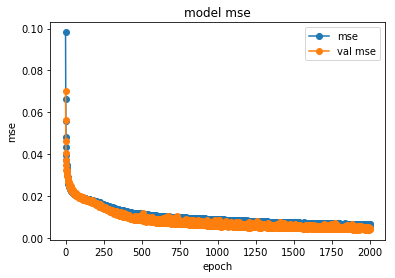

save the model


In [6]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi400/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi400/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


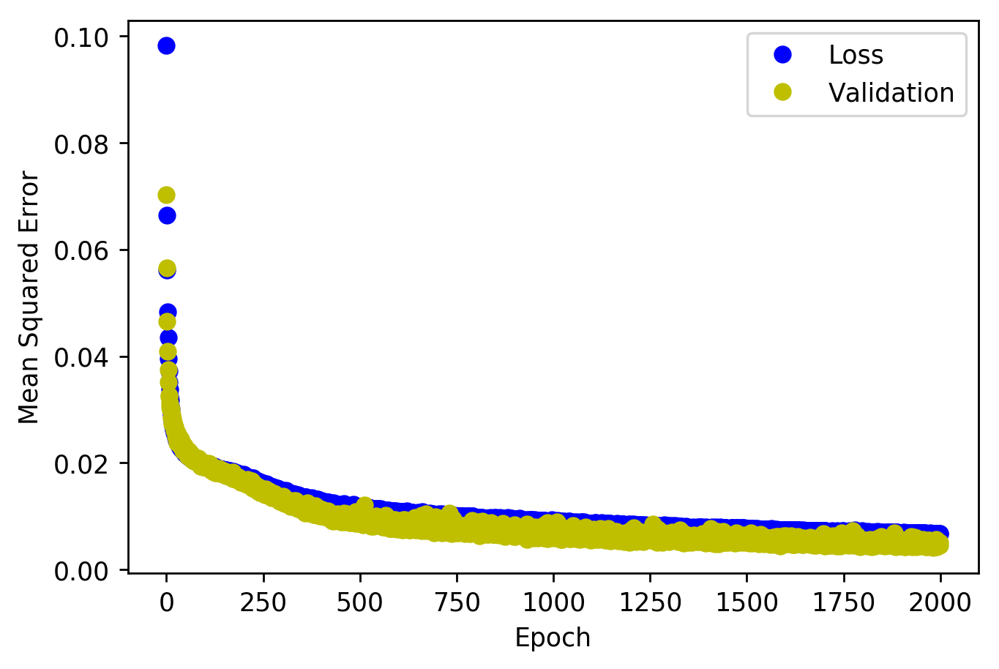

<Figure size 432x288 with 0 Axes>

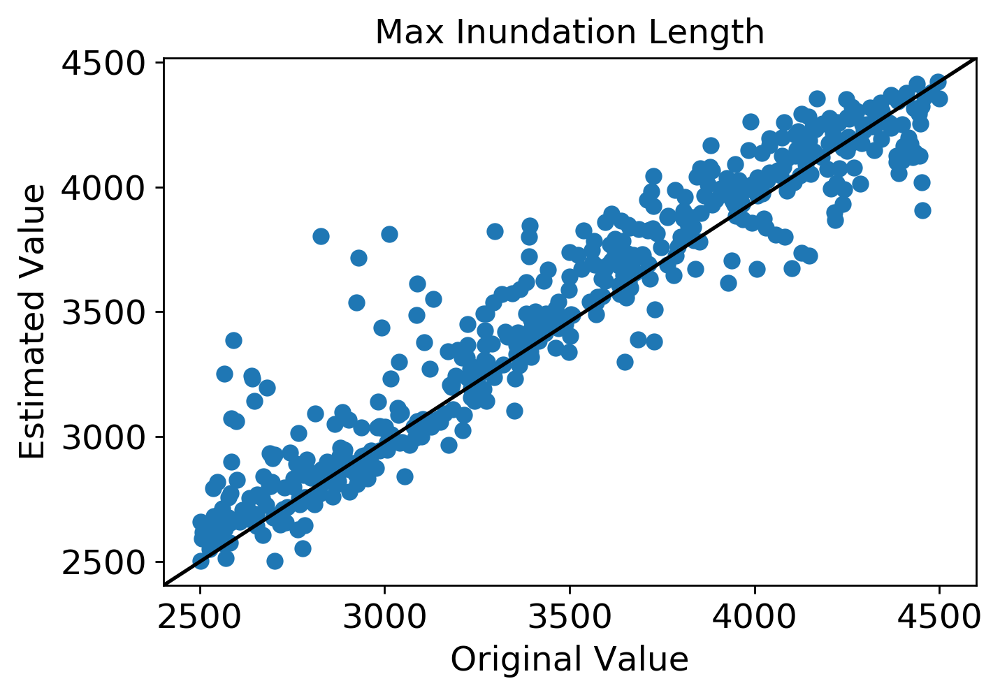

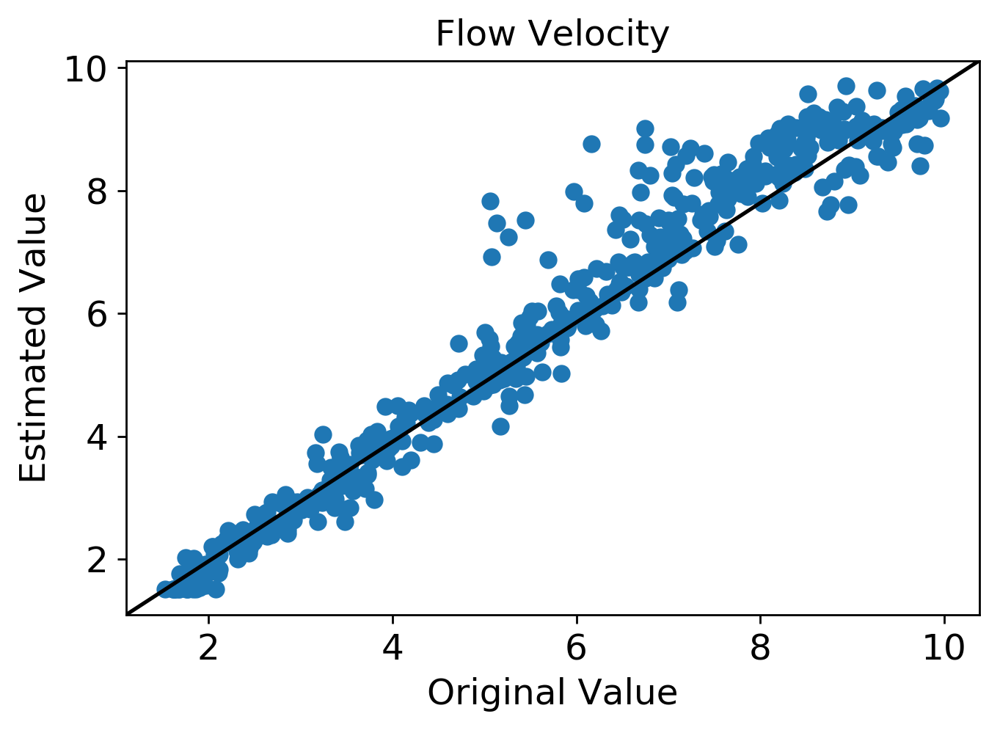

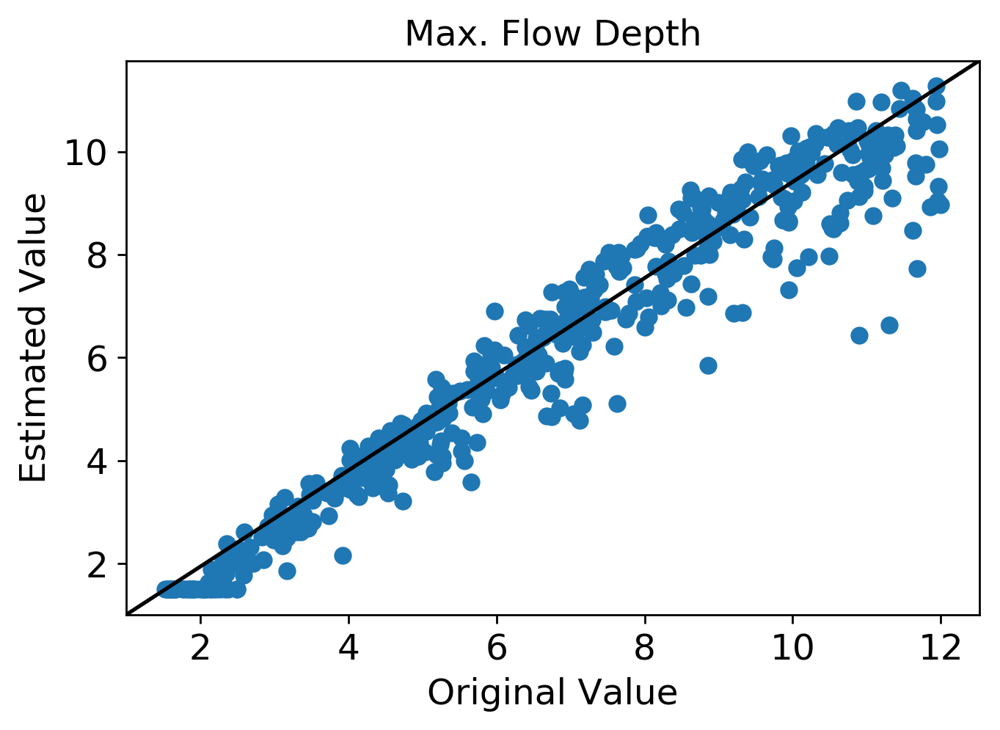

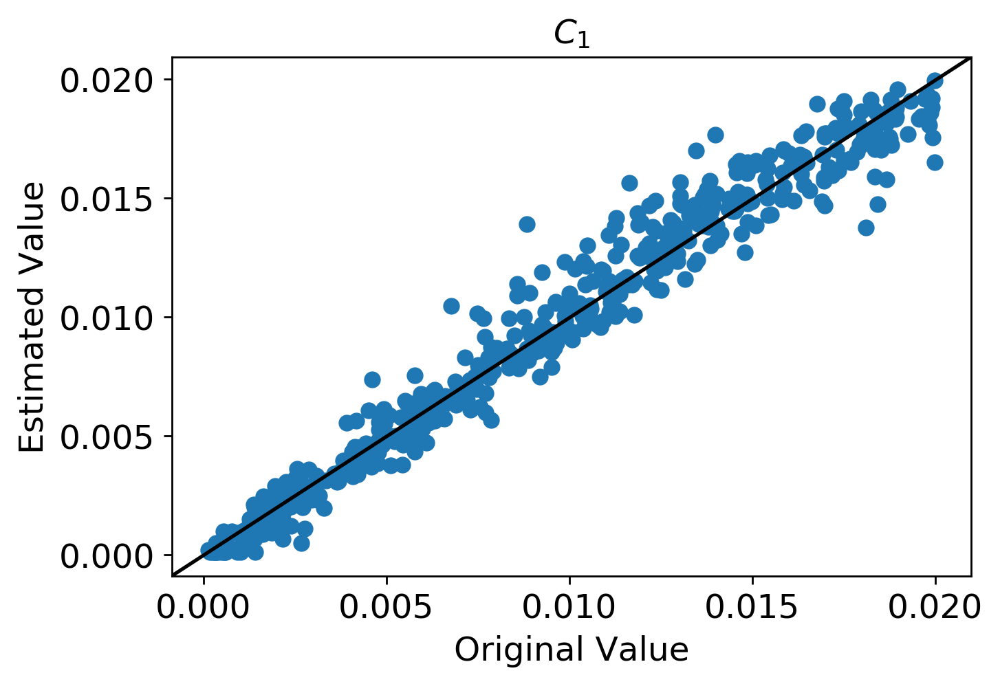

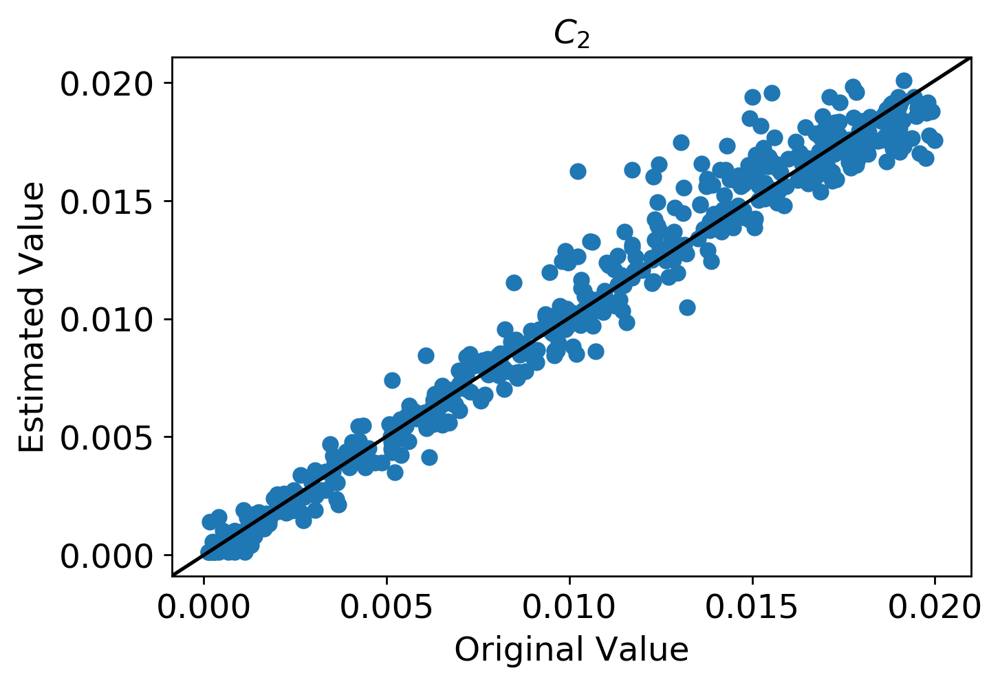

...

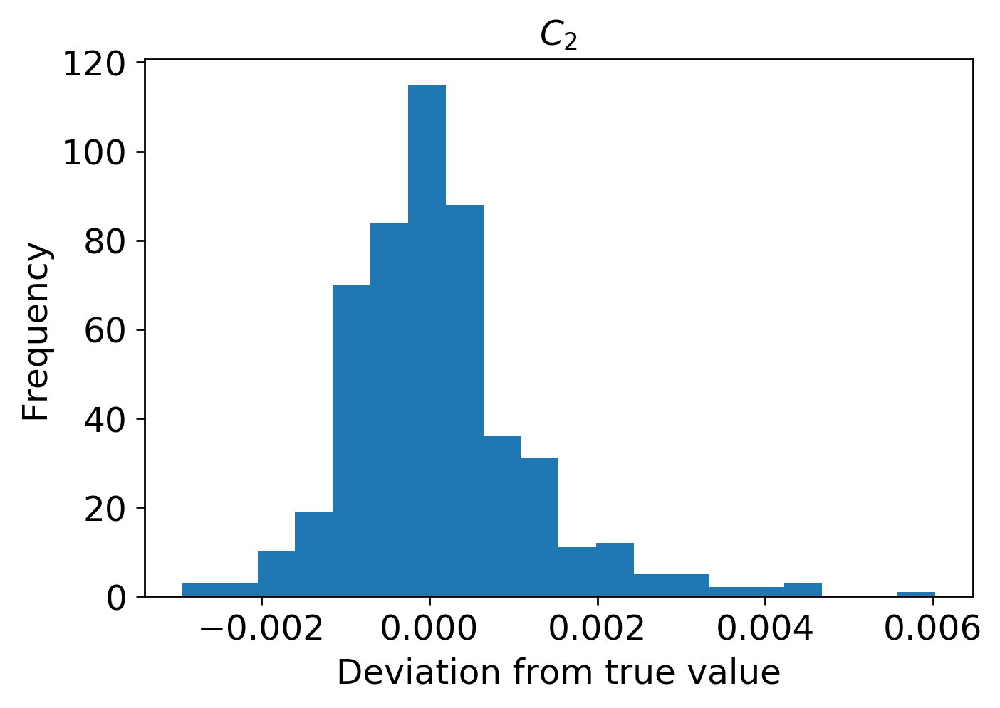

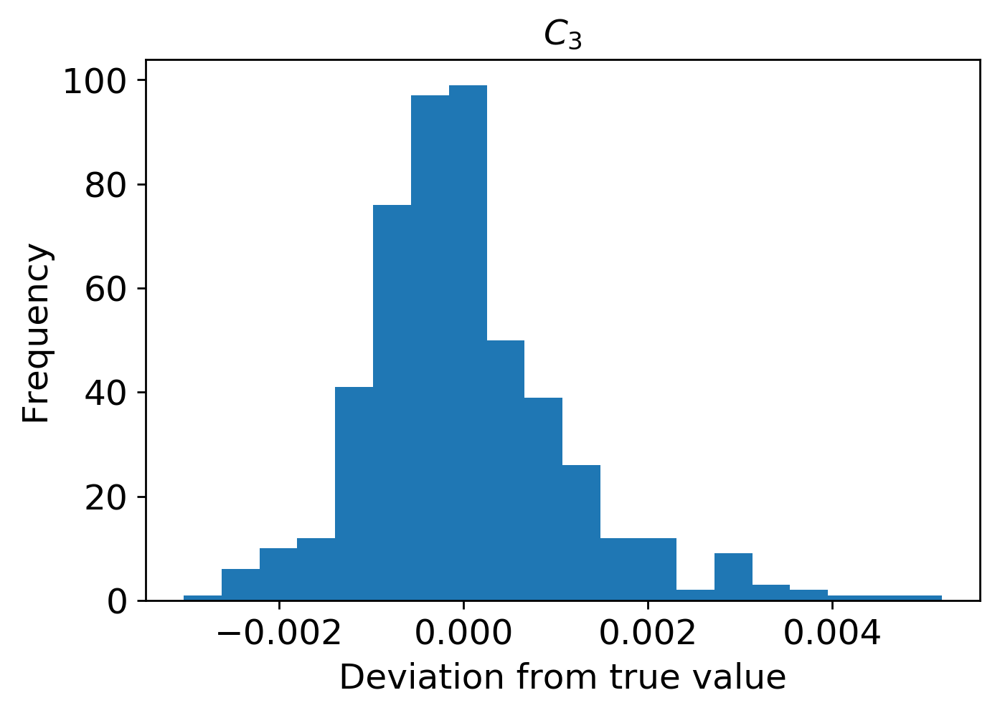

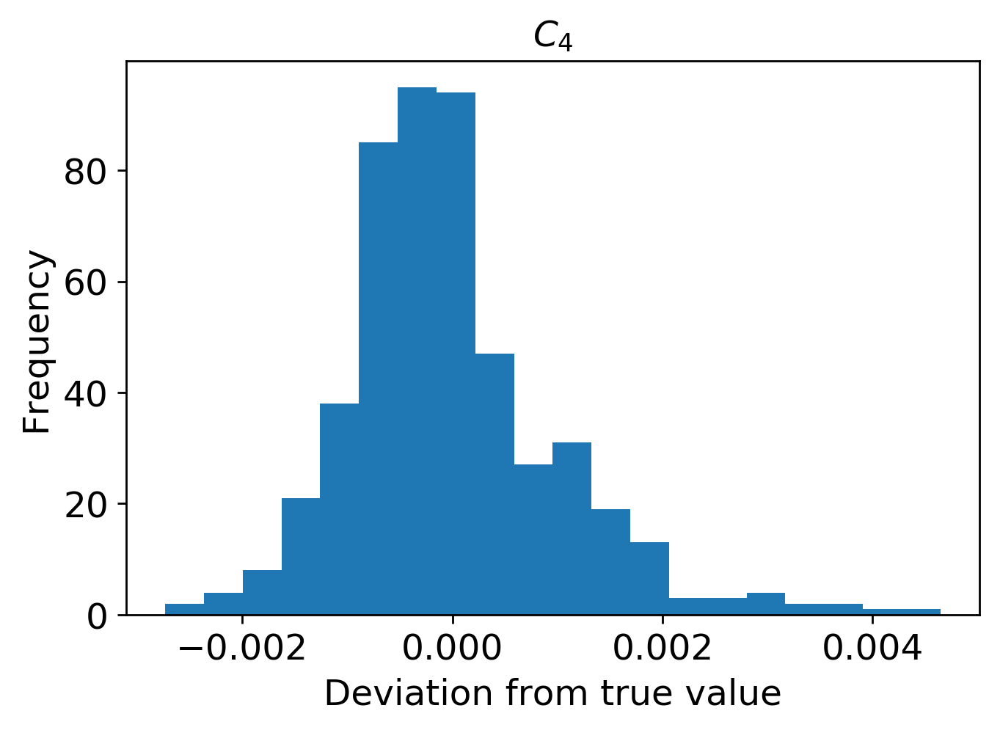

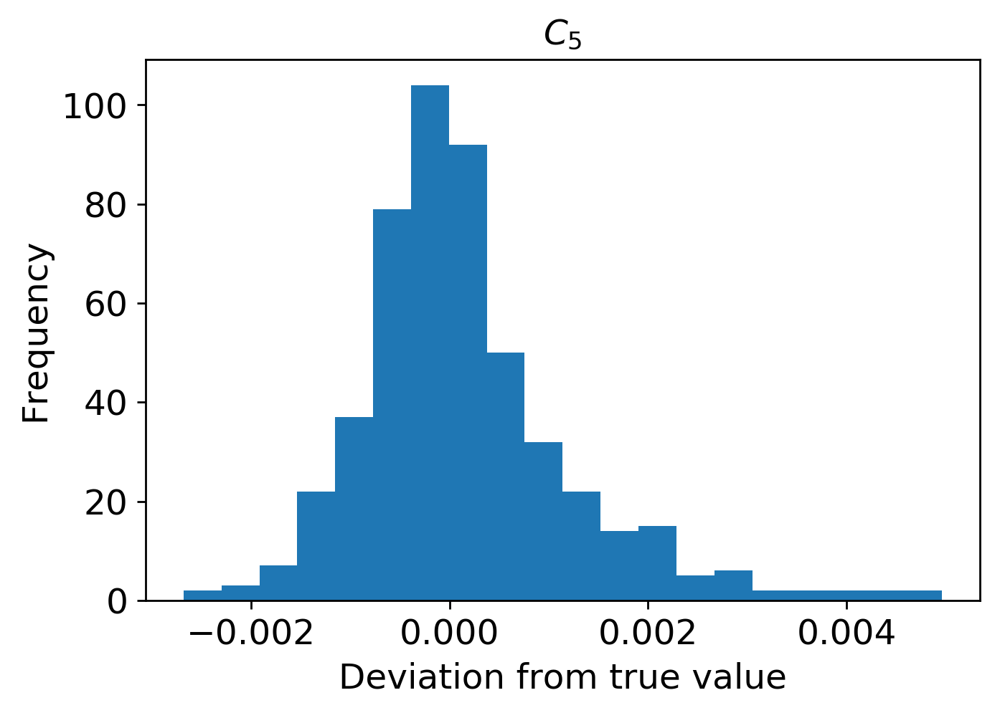

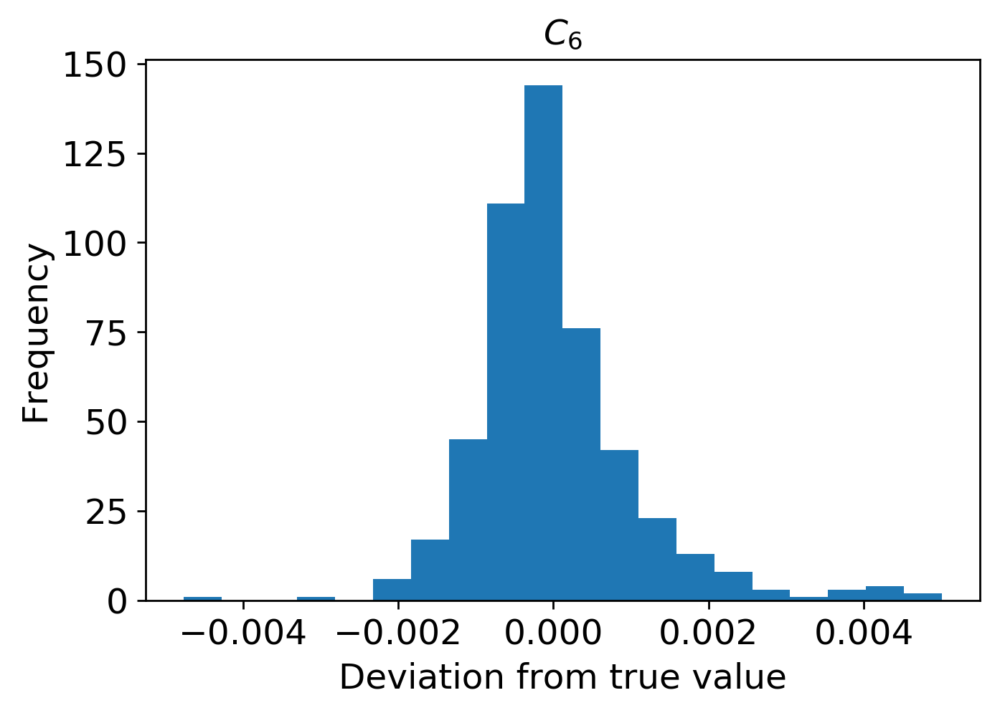

In [7]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi400/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

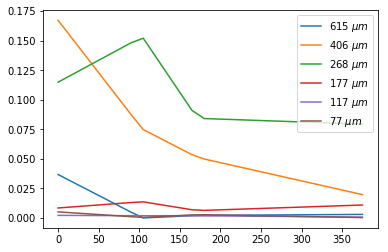

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi400/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(400)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi400.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



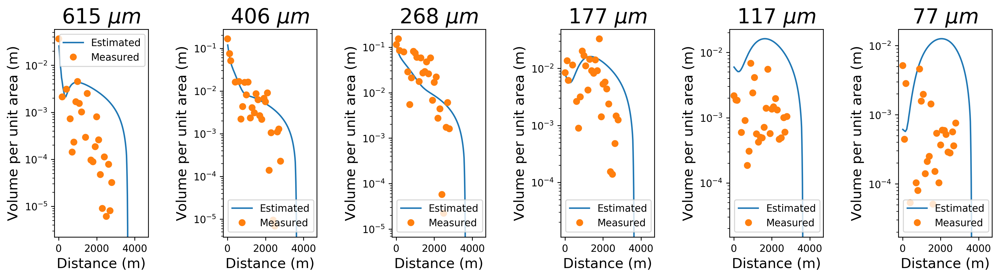

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 400.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi400.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi400.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi400.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi400.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi400.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi400.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi400.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi400.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[3.64244146e+03 5.70409614e+00 3.68612701e+00 4.63018821e-03
  2.08396333e-02 1.77558222e-02 1.28022762e-03 9.83869534e-04
  1.00773694e-04]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


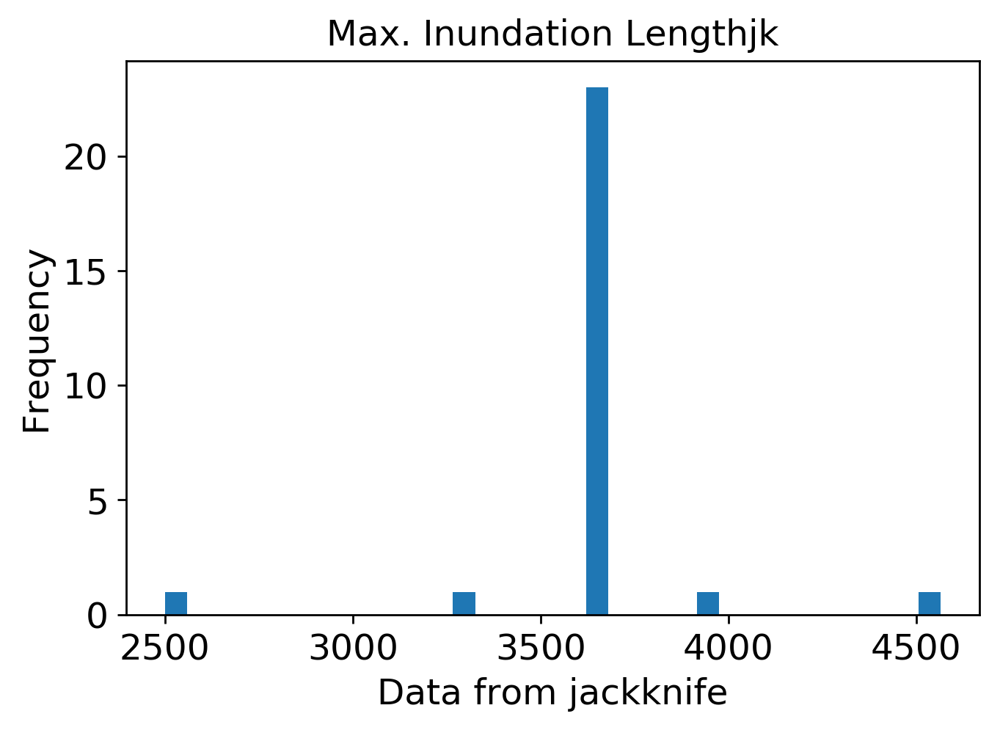

mean: 5.663693343425598
jk_e: 0.12764700477539812


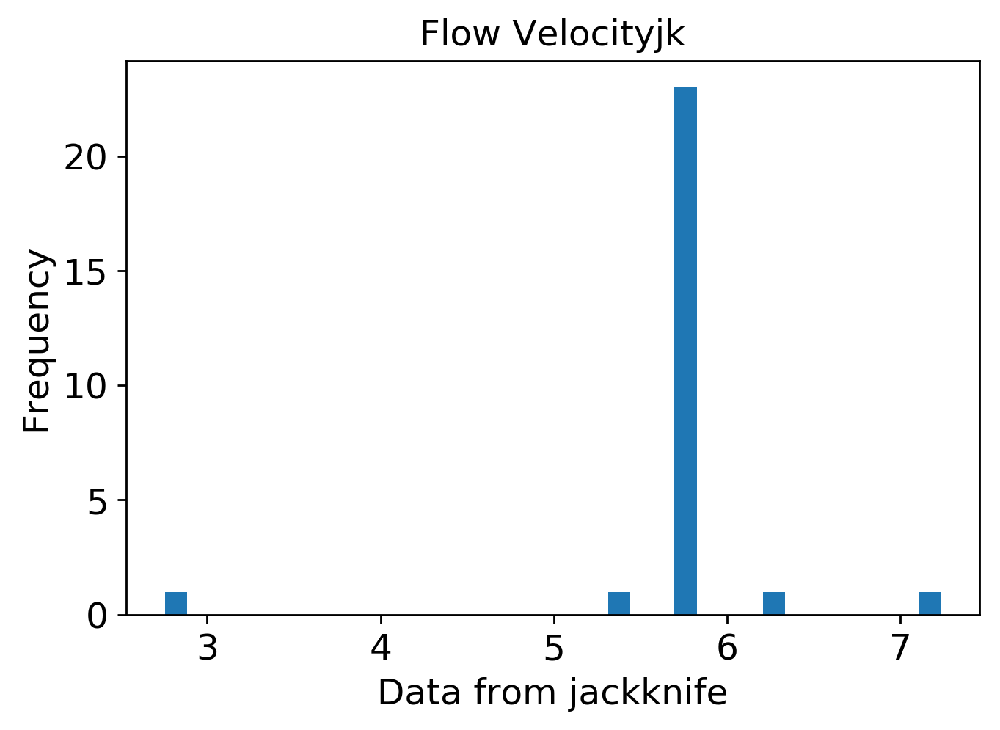

mean: 3.8247293711124004
jk_e: 0.0985127288348144


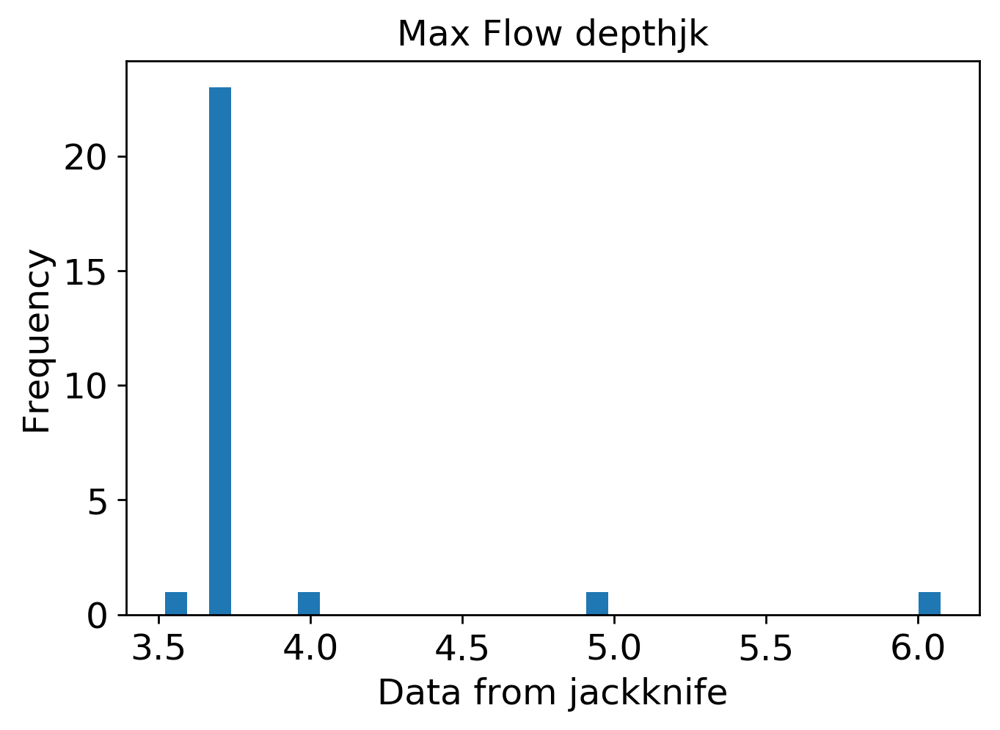

mean: 0.004518527525994287
jk_e: 0.00017511860407228935


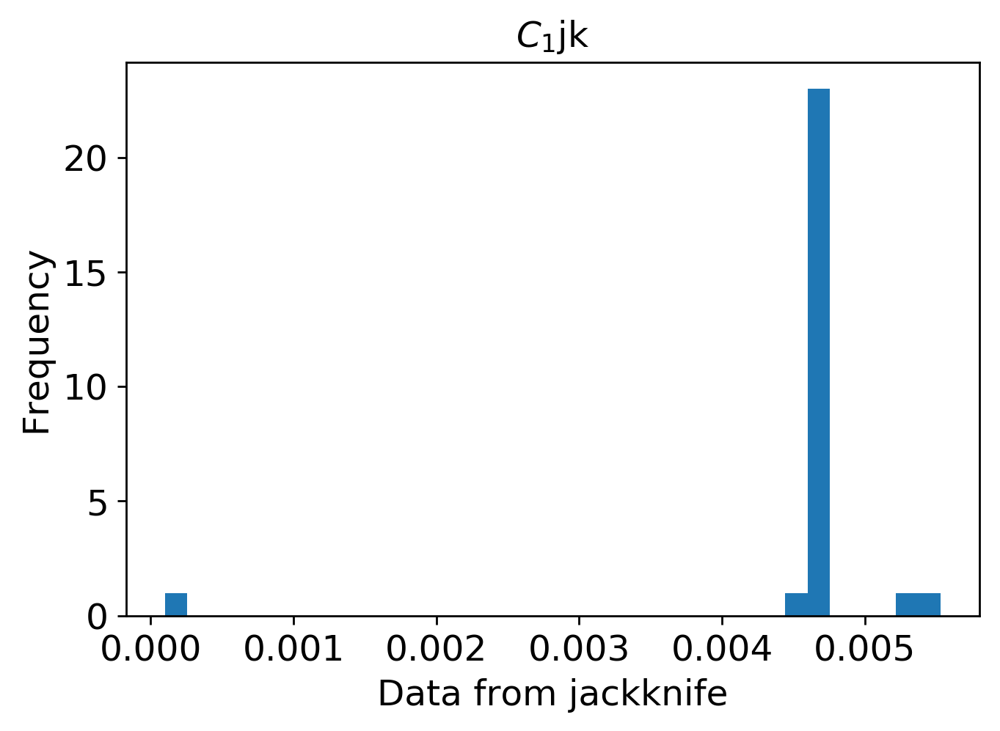

mean: 0.020454557370279552
jk_e: 0.0003592087035962986


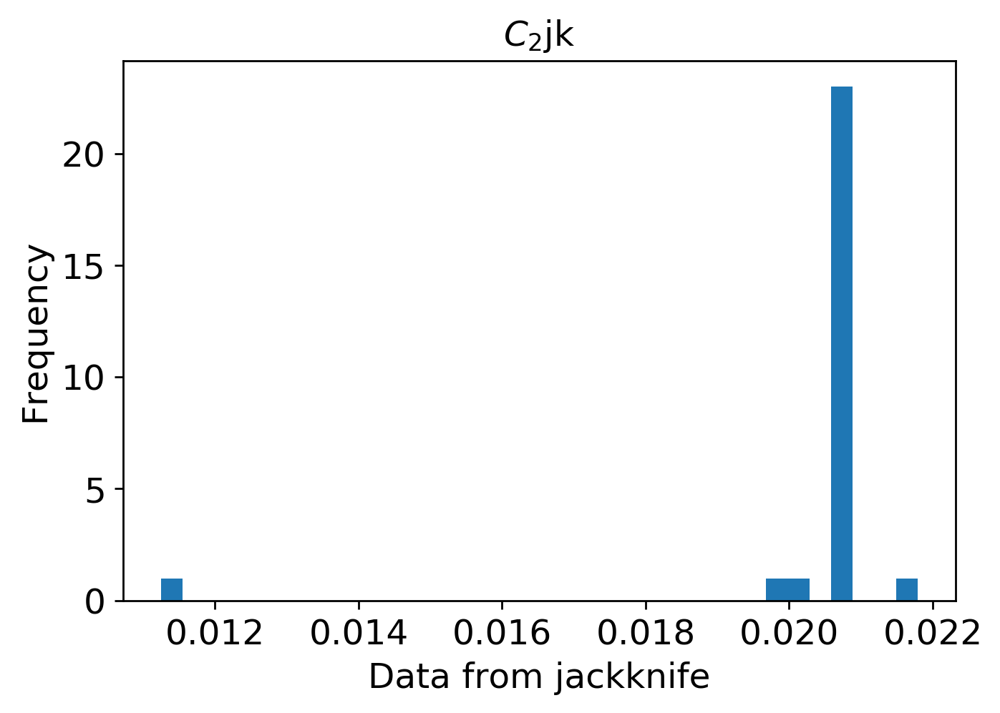

mean: 0.017798728095214437
jk_e: 0.0002047602693993759


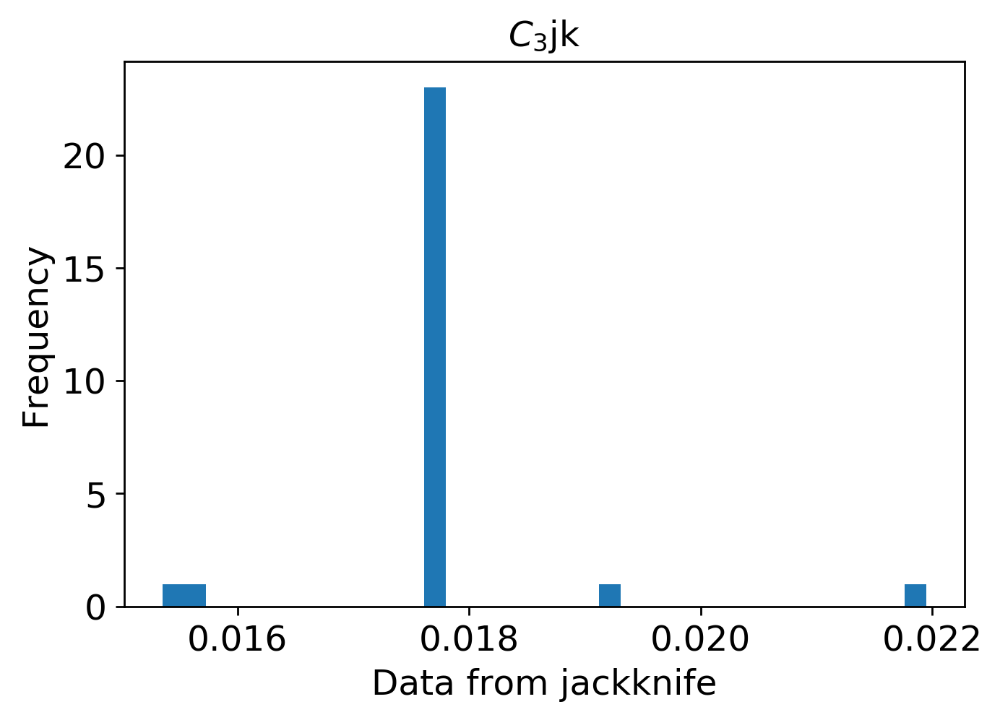

mean: 0.0013017568523509574
jk_e: 4.269513206729295e-05


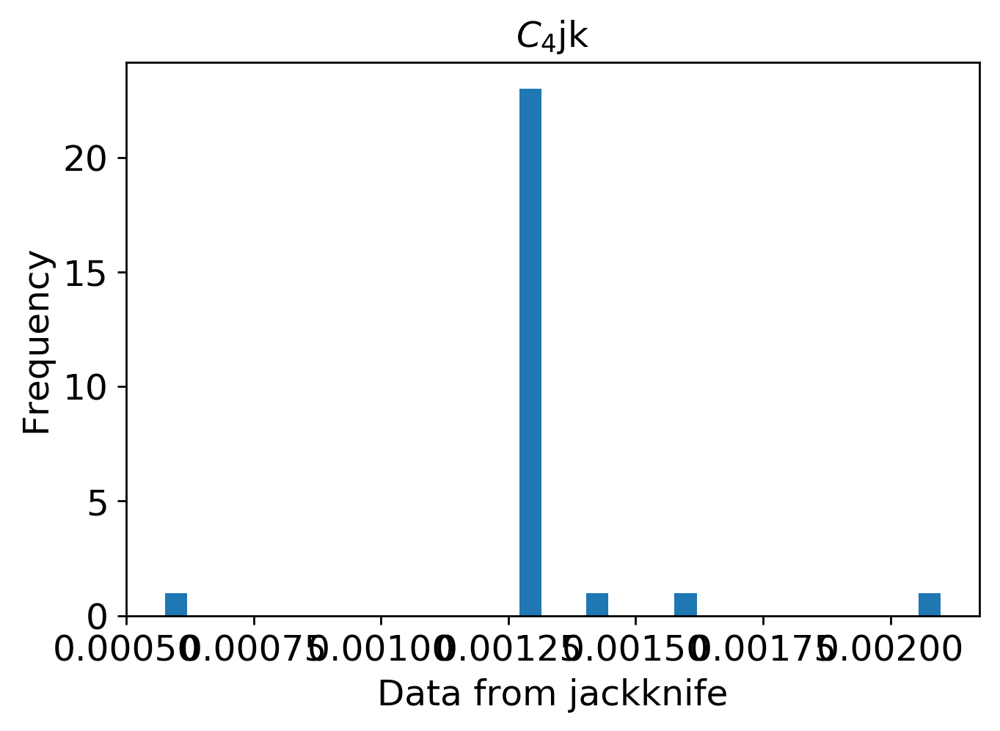

mean: 0.0009428044232411695
jk_e: 4.493373510257157e-05


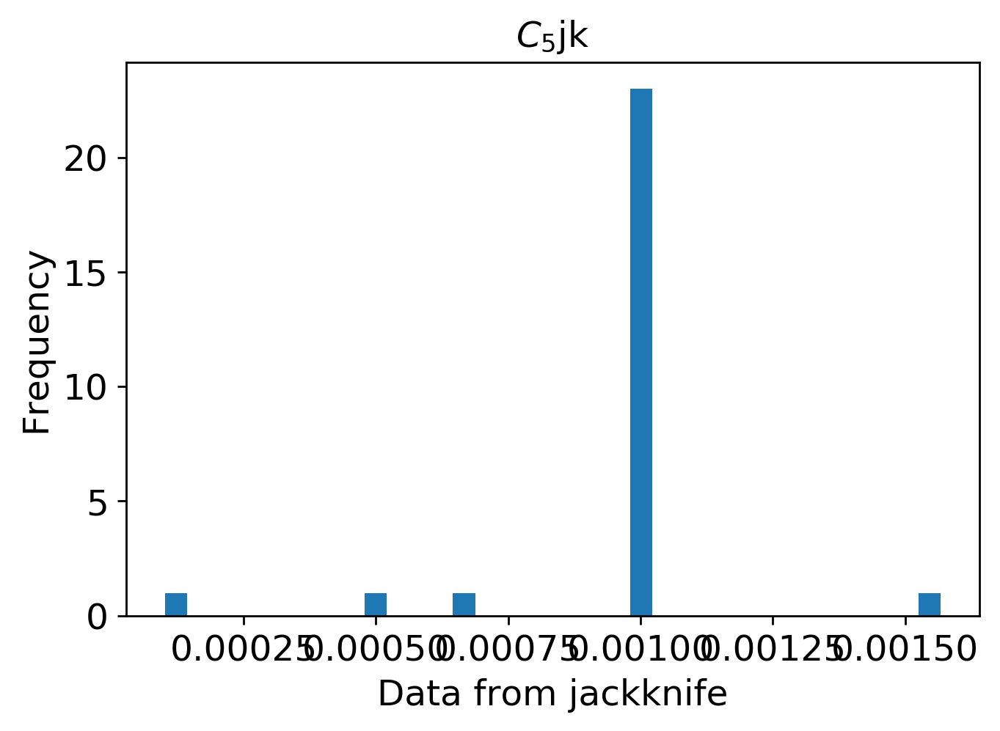

mean: 0.00011500007566005406
jk_e: 1.1984483164643312e-05


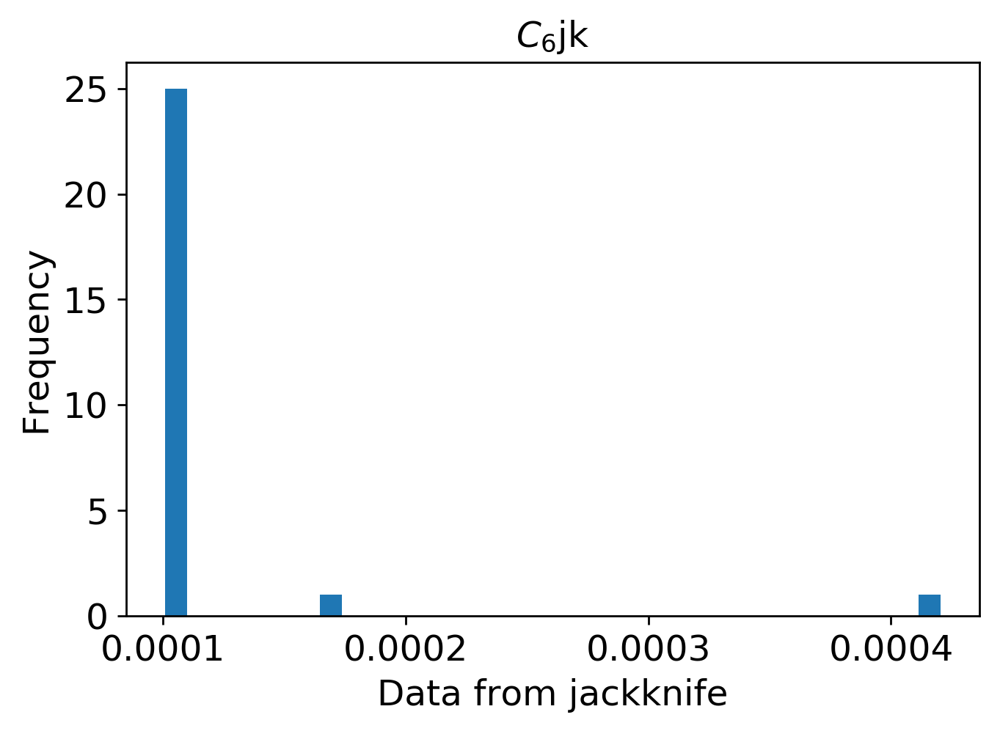

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi400/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi400.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi400.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi400.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 600

In [11]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi600"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=600)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 437us/step - loss: 0.0957 - mean_squared_error: 0.0957 - val_loss: 0.0715 - val_mean_squared_error: 0.0715
Epoch 2/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0653 - mean_squared_error: 0.0653 - val_loss: 0.0582 - val_mean_squared_error: 0.0582
Epoch 3/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0554 - mean_squared_error: 0.0554 - val_loss: 0.0484 - val_mean_squared_error: 0.0484
Epoch 4/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0486 - mean_squared_error: 0.0486 - val_loss: 0.0437 - val_mean_squared_error: 0.0437
Epoch 5/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0442 - mean_squared_error: 0.0442 - val_loss: 0.0388 - val_mean_squared_error: 0.0388
Epoch 6/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0403 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 360us/step - loss: 0.0195 - mean_squared_error: 0.0195 - val_loss: 0.0189 - val_mean_squared_error: 0.0189
Epoch 98/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0194 - mean_squared_error: 0.0194 - val_loss: 0.0195 - val_mean_squared_error: 0.0195
Epoch 99/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0194 - mean_squared_error: 0.0194 - val_loss: 0.0195 - val_mean_squared_error: 0.0195
Epoch 100/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0194 - mean_squared_error: 0.0194 - val_loss: 0.0193 - val_mean_squared_error: 0.0193
Epoch 101/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0195 - mean_squared_error: 0.0195 - val_loss: 0.0191 - val_mean_squared_error: 0.0191
Epoch 102/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0193 - mean_squared_error: 0.0193 - val_loss: 0.0189 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 337us/step - loss: 0.0143 - mean_squared_error: 0.0143 - val_loss: 0.0115 - val_mean_squared_error: 0.0115
Epoch 194/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0142 - mean_squared_error: 0.0142 - val_loss: 0.0116 - val_mean_squared_error: 0.0116
Epoch 195/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0142 - mean_squared_error: 0.0142 - val_loss: 0.0114 - val_mean_squared_error: 0.0114
Epoch 196/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0141 - mean_squared_error: 0.0141 - val_loss: 0.0110 - val_mean_squared_error: 0.0110
Epoch 197/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0141 - mean_squared_error: 0.0141 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 198/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0140 - mean_squared_error: 0.0140 - val_loss: 0.0110 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 350us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0086 - val_mean_squared_error: 0.0086
Epoch 290/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0078 - val_mean_squared_error: 0.0078
Epoch 291/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0077 - val_mean_squared_error: 0.0077
Epoch 292/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0080 - val_mean_squared_error: 0.0080
Epoch 293/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0110 - mean_squared_error: 0.0110 - val_loss: 0.0074 - val_mean_squared_error: 0.0074
Epoch 294/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0097 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 346us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 386/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0071 - val_mean_squared_error: 0.0071
Epoch 387/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 388/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 389/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 390/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0070 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 355us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 482/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 483/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 484/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 485/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 486/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0073 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 324us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 578/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 579/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 580/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 581/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 582/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0055 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 350us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 674/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 675/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 676/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 677/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 678/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0051 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 336us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 770/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 771/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 772/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 773/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 774/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0049 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 340us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 866/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 867/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 868/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 869/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 870/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0046 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 363us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 962/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 963/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 964/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 965/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 966/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0044 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 357us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 1058/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1059/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1060/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1061/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1062/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0044 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1106/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1107/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 1108/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1109/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1110/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0046 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1154/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1155/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1156/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1157/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1158/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 362us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1202/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1203/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1204/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1205/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1206/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0045 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1250/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1251/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 1252/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1253/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1254/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0039 - val_mean_squared_erro

3600/3600 [==============================] - 1s 345us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1298/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1299/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1300/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1301/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1302/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 362us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1346/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1347/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1348/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1349/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1350/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0042 - val_mean_squared_erro

3600/3600 [==============================] - 1s 349us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1394/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1395/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1396/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1397/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1398/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 388us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1442/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1443/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1444/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1445/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1446/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0045 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1490/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1491/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1492/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1493/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1494/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 350us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1538/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1539/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1540/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1541/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1542/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 323us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1586/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1587/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1588/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1589/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1590/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1634/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1635/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1636/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1637/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1638/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1682/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1683/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1684/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1685/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1686/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0037 - val_mean_squared_erro

3600/3600 [==============================] - 1s 355us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1730/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 1731/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1732/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1733/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1734/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0039 - val_mean_squared_erro

3600/3600 [==============================] - 1s 363us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1778/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1779/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1780/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1781/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1782/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1826/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1827/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1828/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1829/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1830/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 356us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1874/2000
3600/3600 [==============================] - 1s 319us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1875/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1876/2000
3600/3600 [==============================] - 1s 325us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1877/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1878/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1922/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1923/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1924/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1925/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1926/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1970/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1971/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1972/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1973/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1974/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_erro

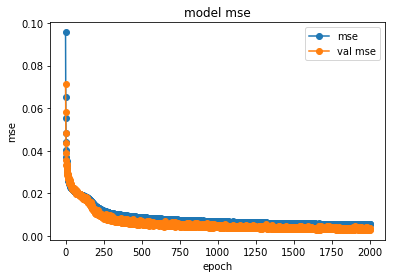

save the model


In [12]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi600/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi600/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


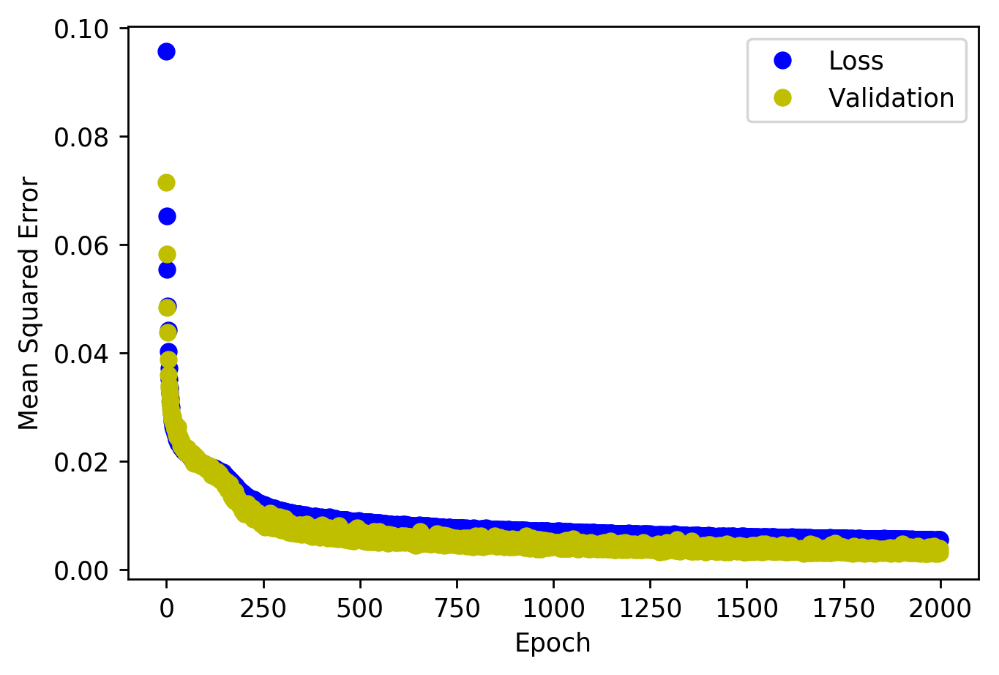

<Figure size 432x288 with 0 Axes>

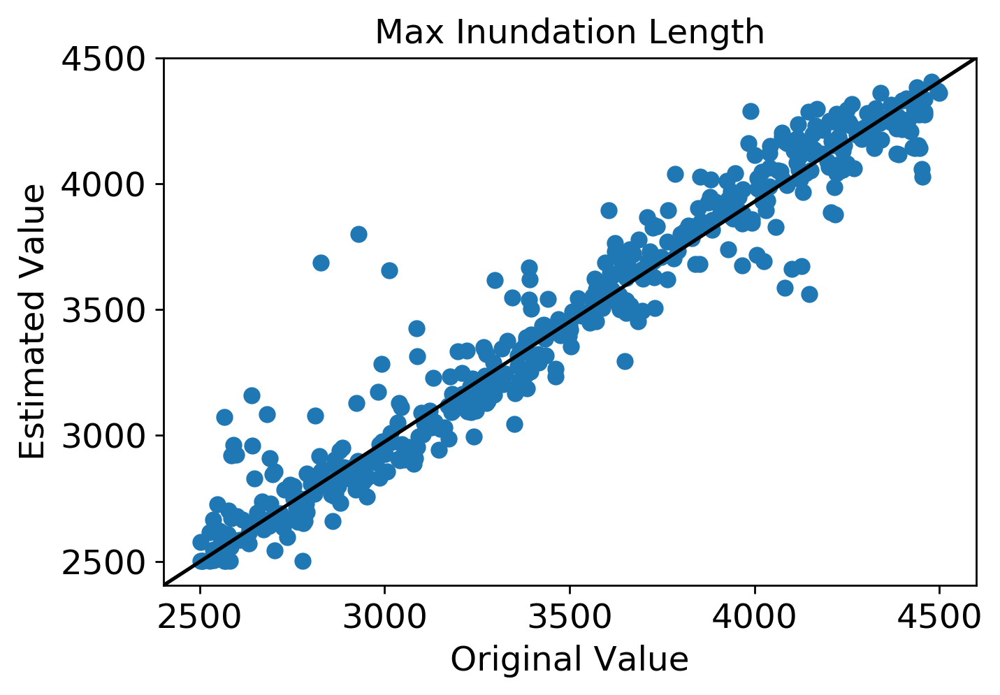

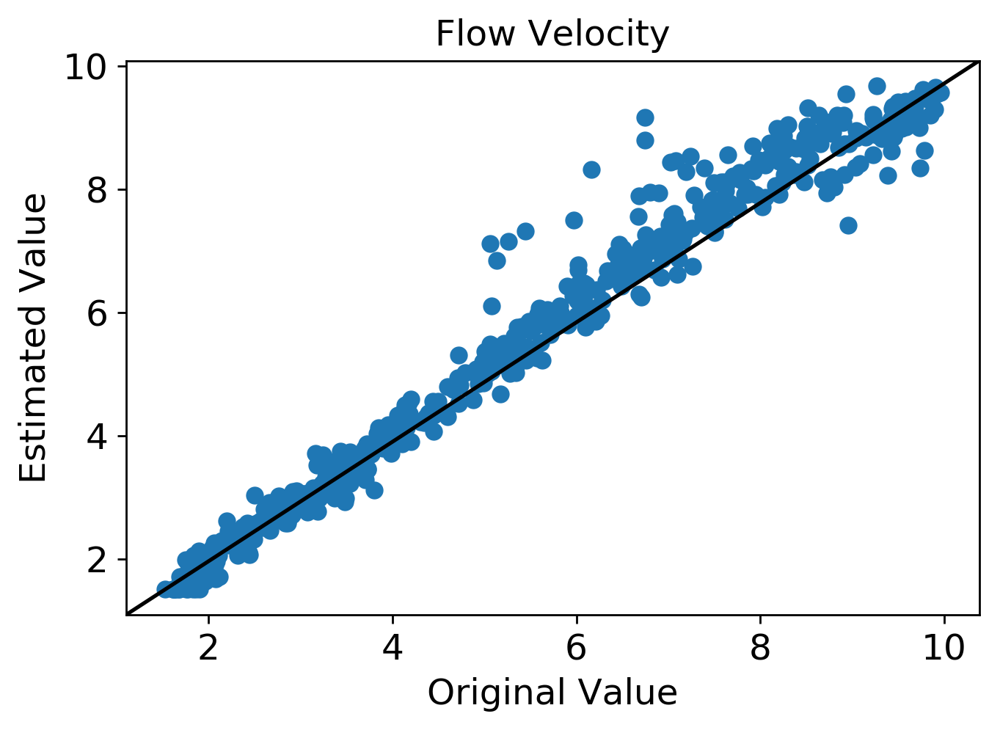

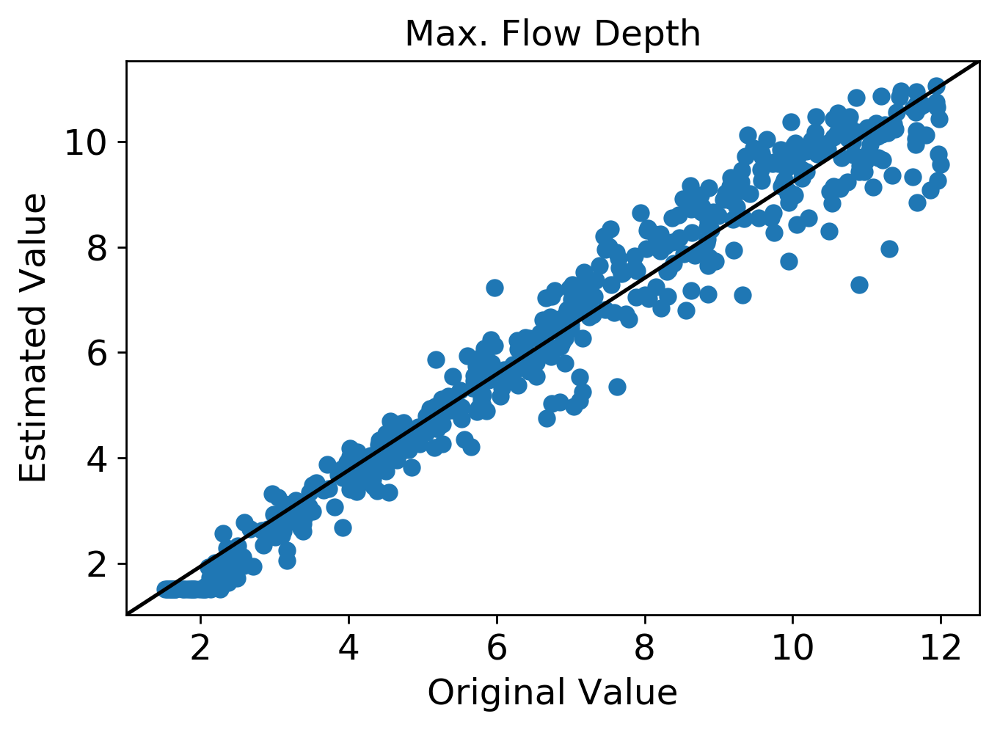

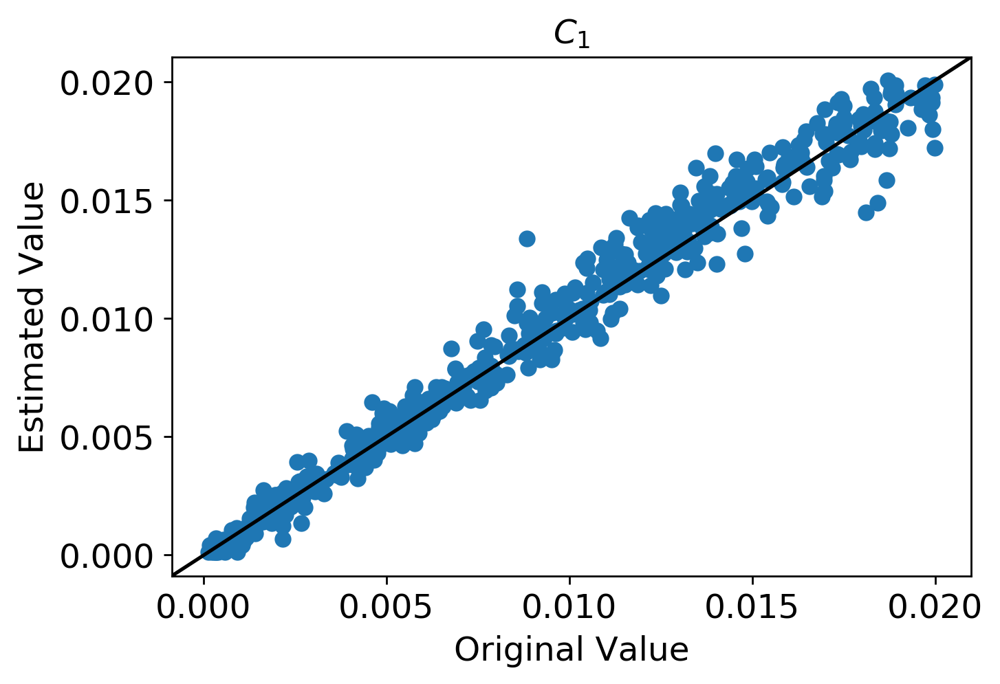

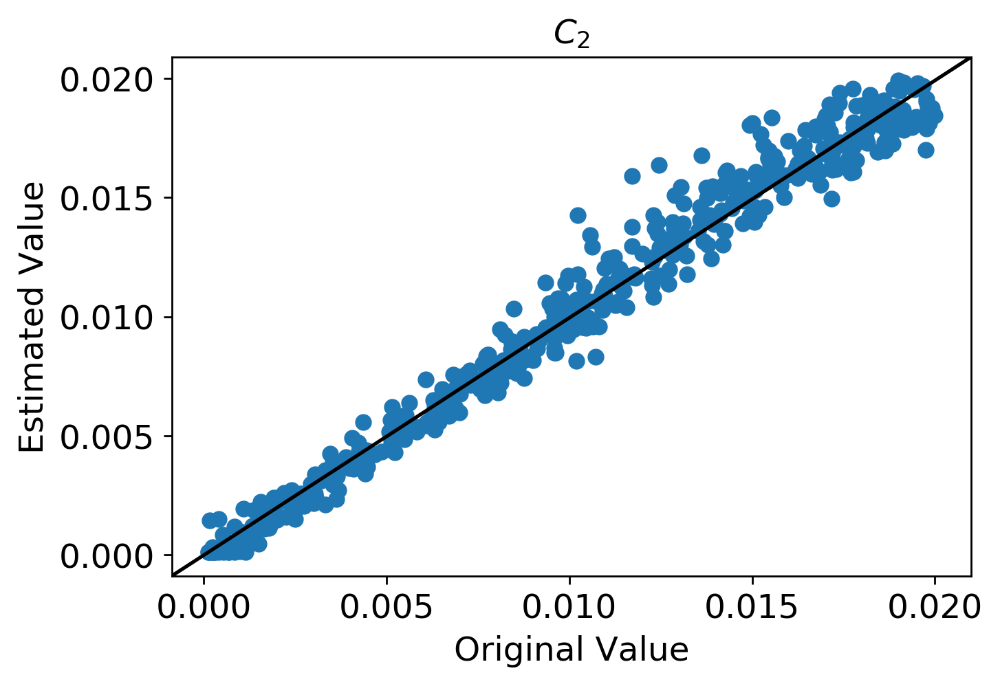

...

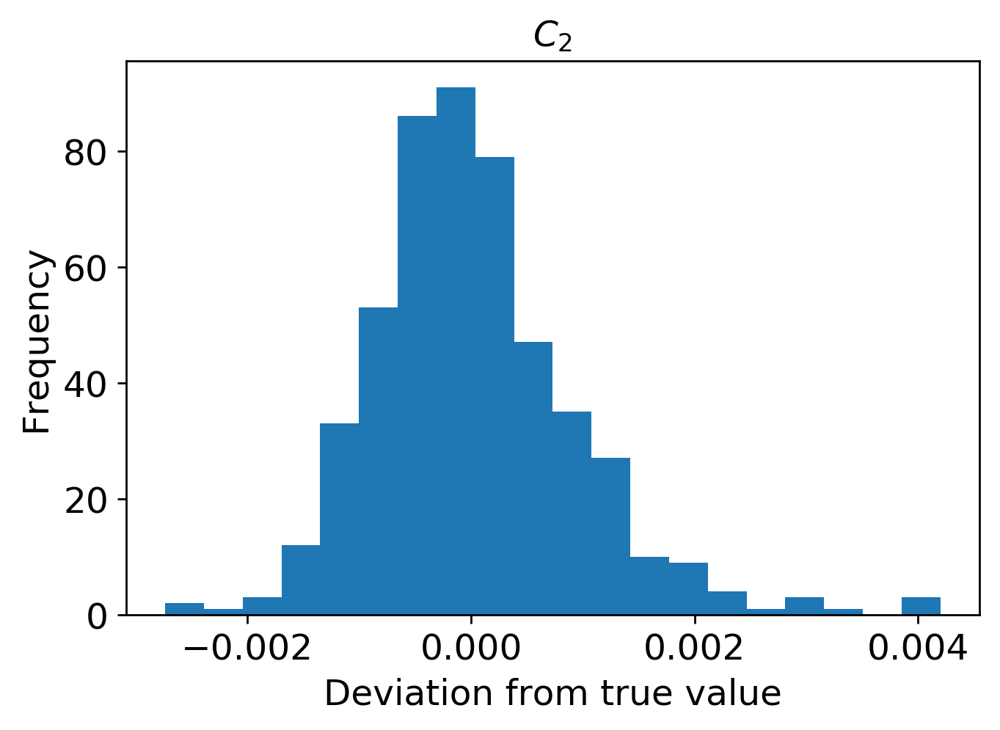

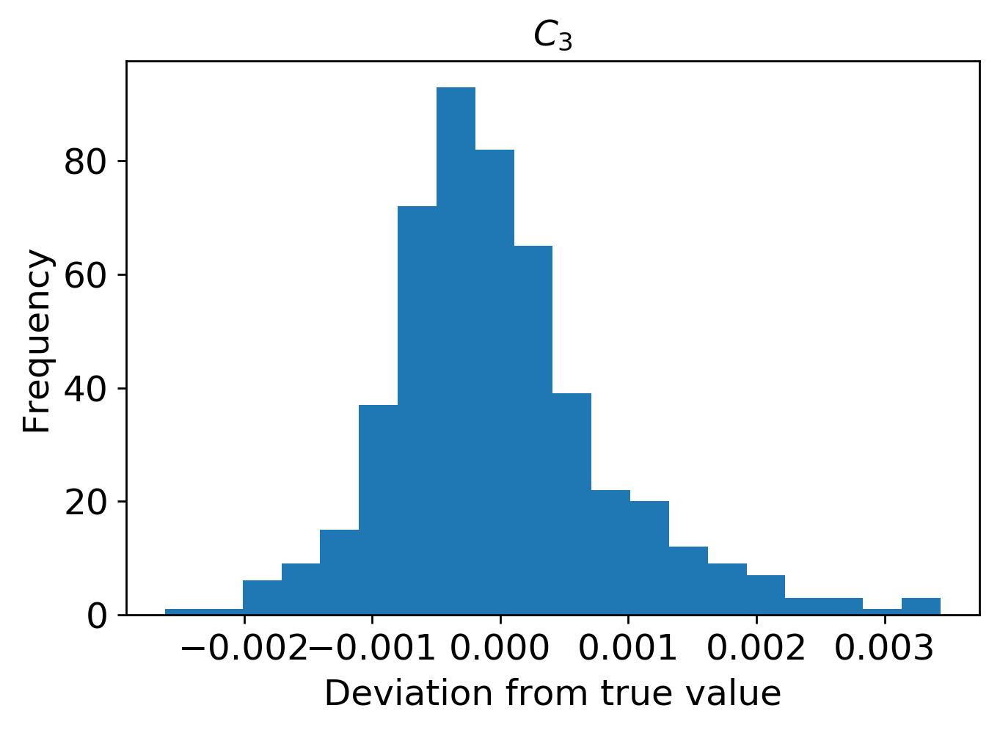

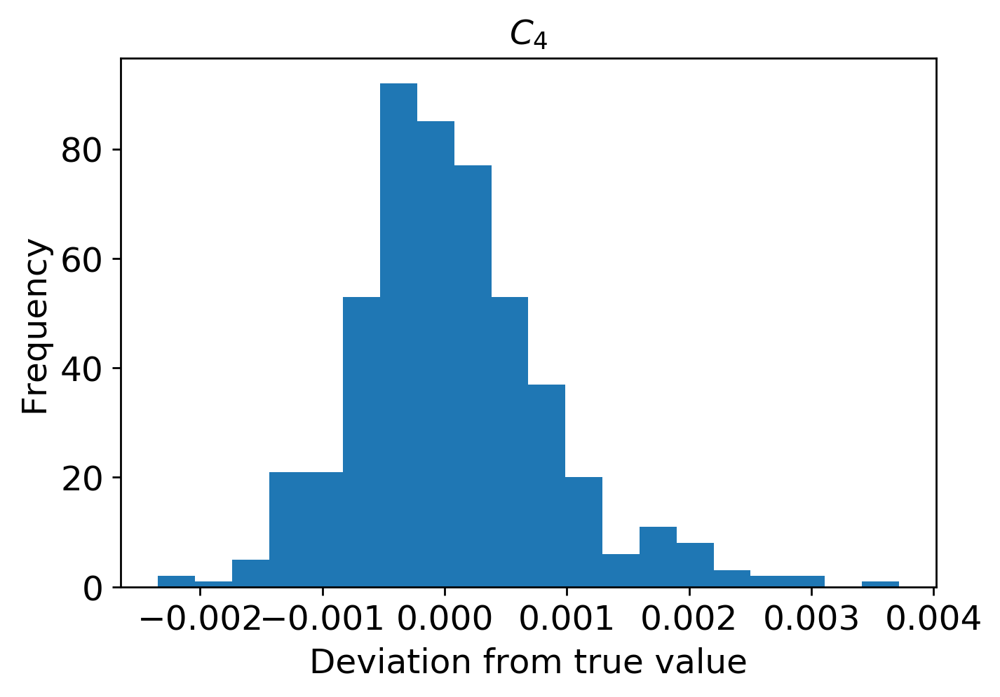

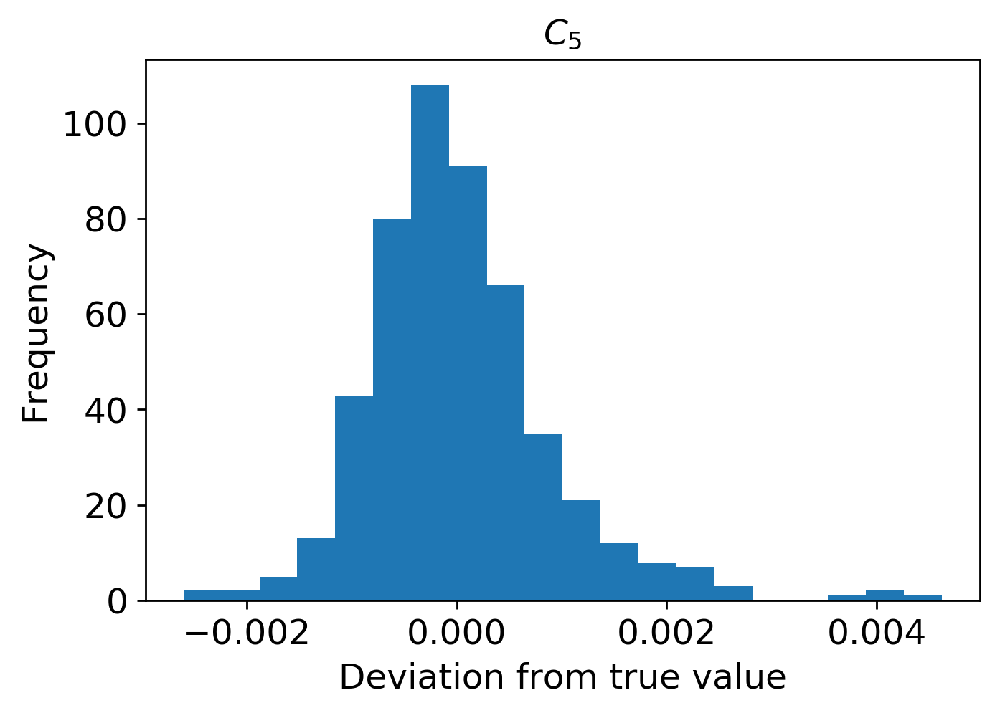

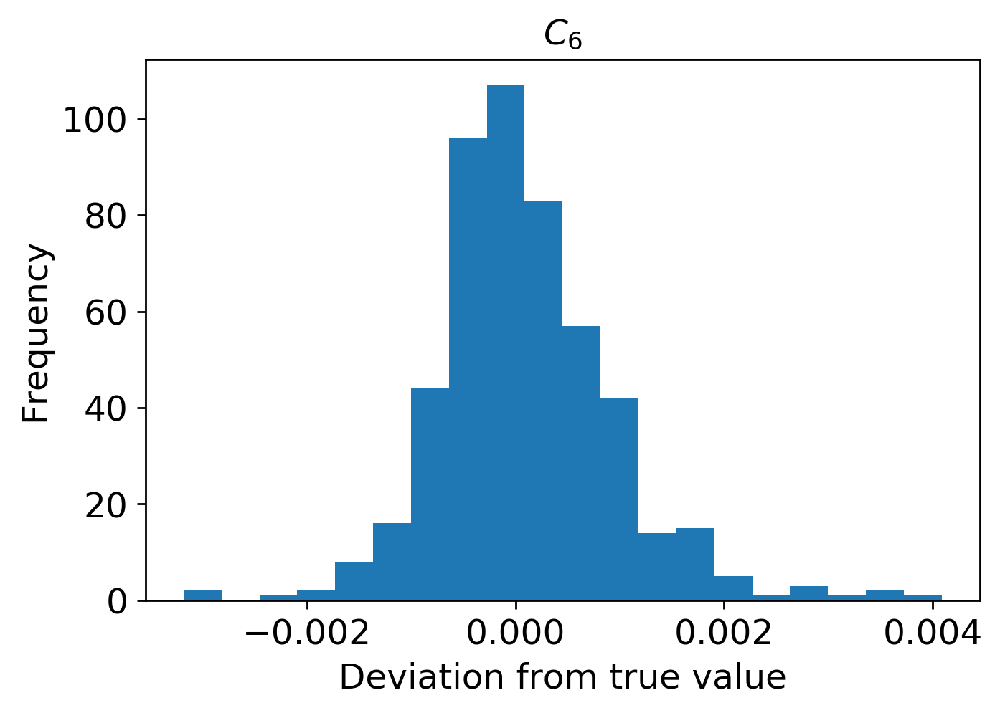

In [13]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi600/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

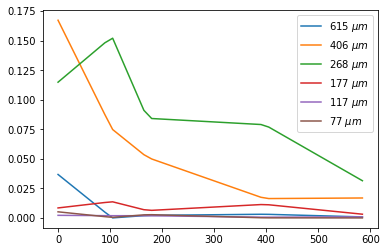

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi600/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi600.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



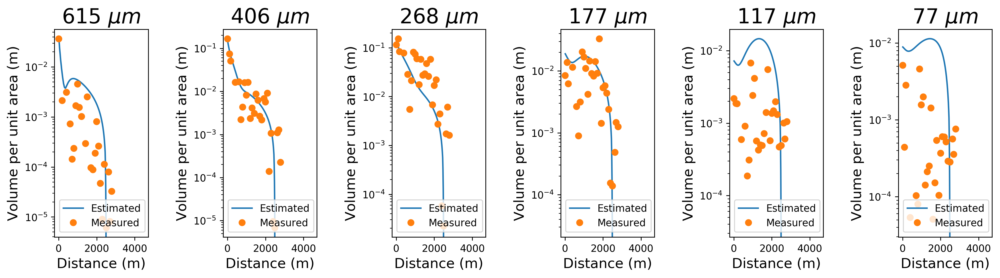

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 600.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi600.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi600.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi600.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi600.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi600.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi600.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi600.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi600.eps")
plt.show()

Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[2.50024160e+03 6.80764821e+00 4.27589849e+00 5.65595225e-03
  2.17017296e-02 1.92641012e-02 2.70769414e-03 1.02537636e-03
  1.25887433e-03]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


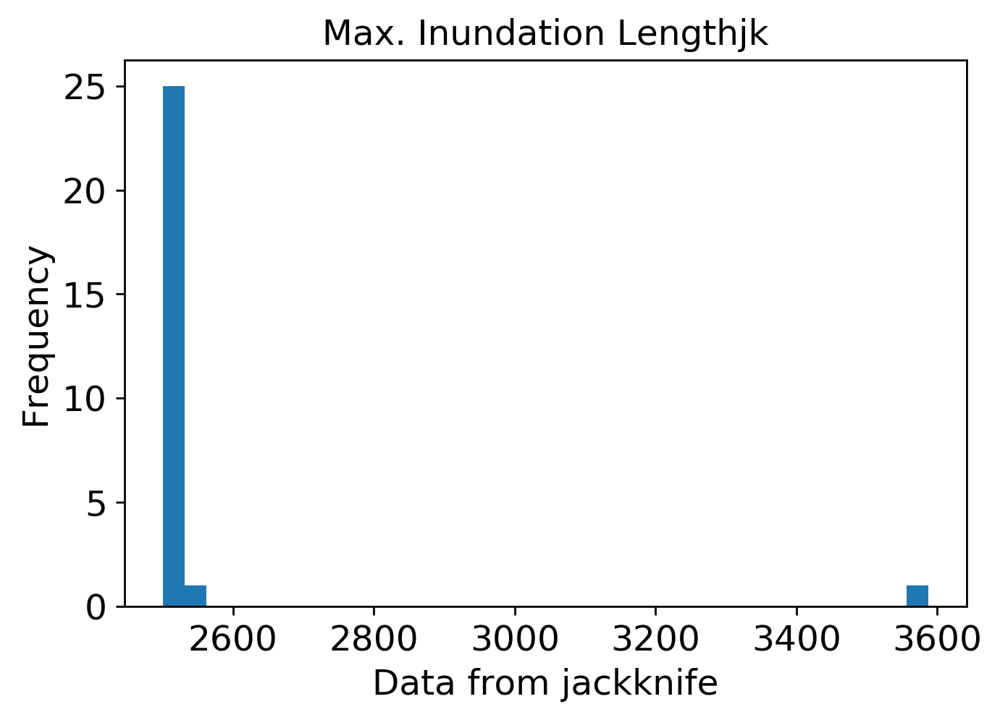

mean: 6.812866558062367
jk_e: 0.12878947982837582


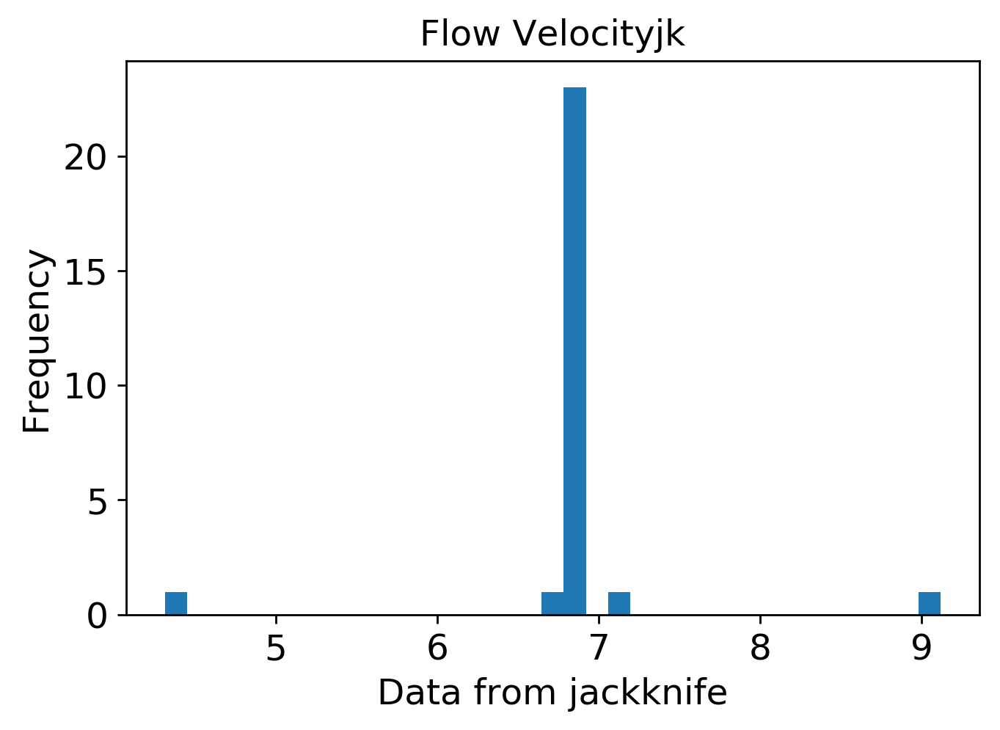

mean: 4.307414424564031
jk_e: 0.03538016025815957


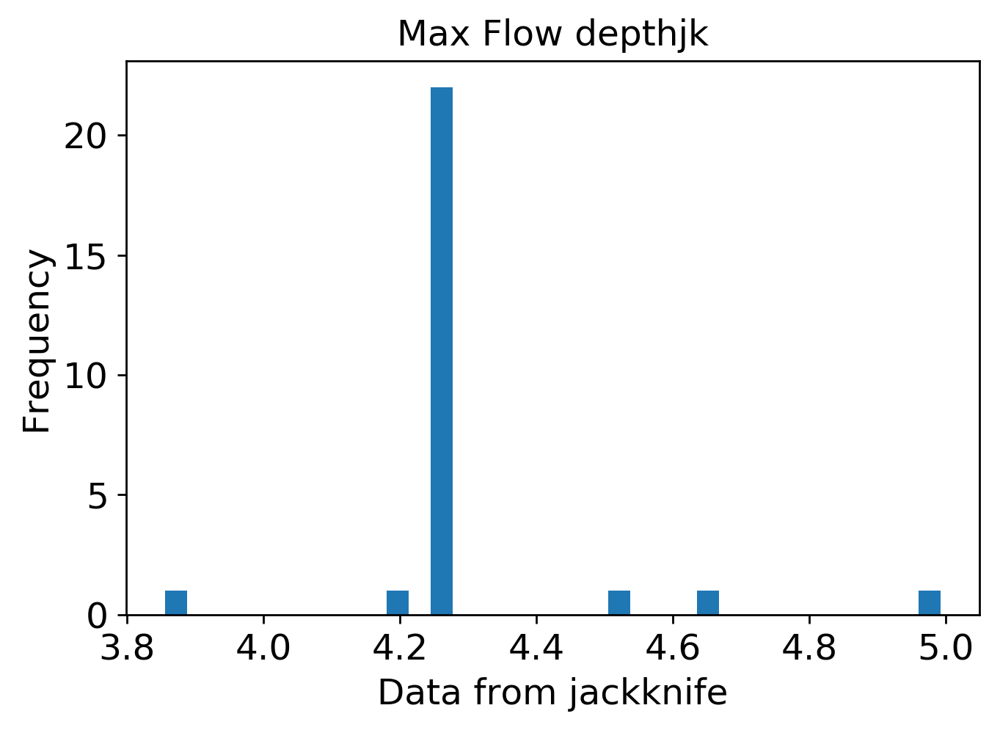

mean: 0.0055840705812453505
jk_e: 0.00023224666722657602


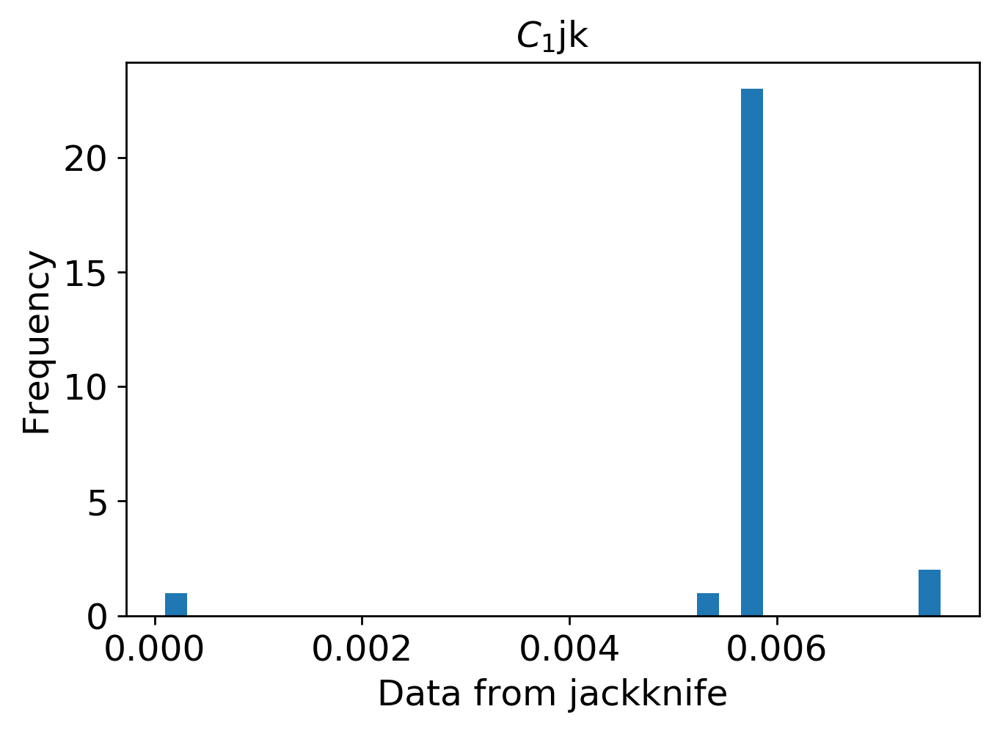

mean: 0.02154398645656761
jk_e: 0.0002457018463874758


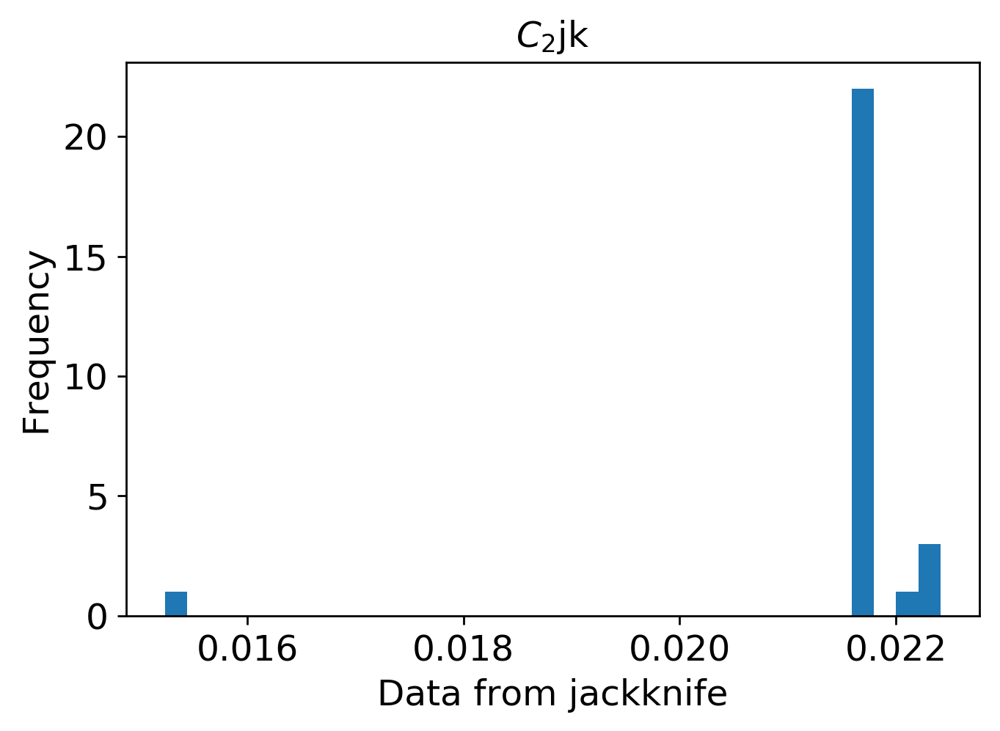

mean: 0.01952811897968702
jk_e: 0.00027482208742750537


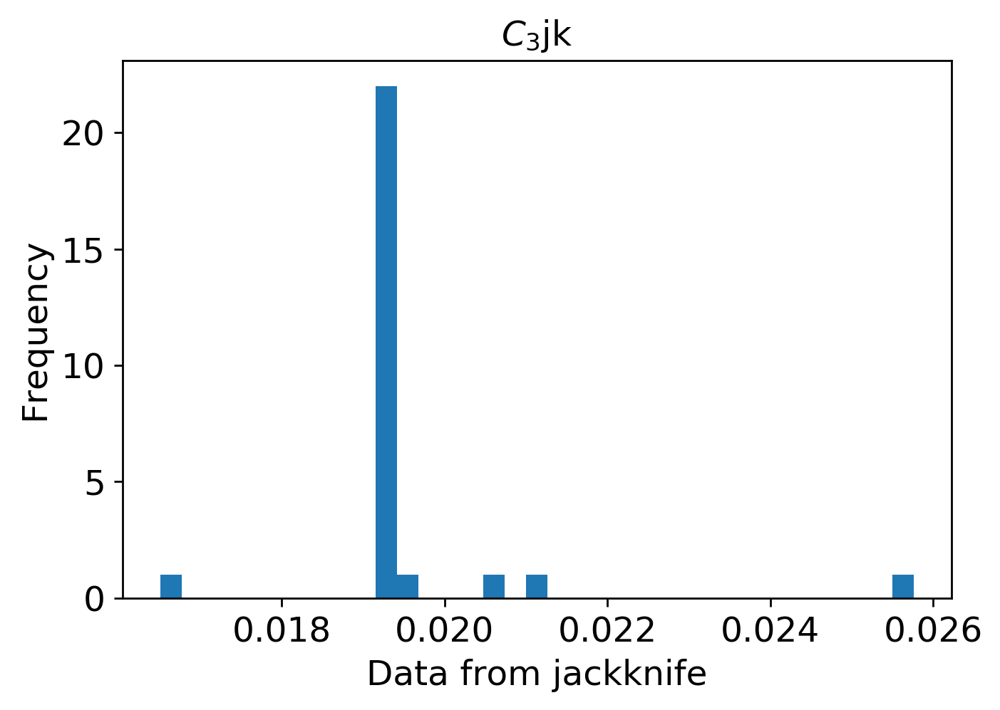

mean: 0.002759772519487098
jk_e: 6.027389630631227e-05


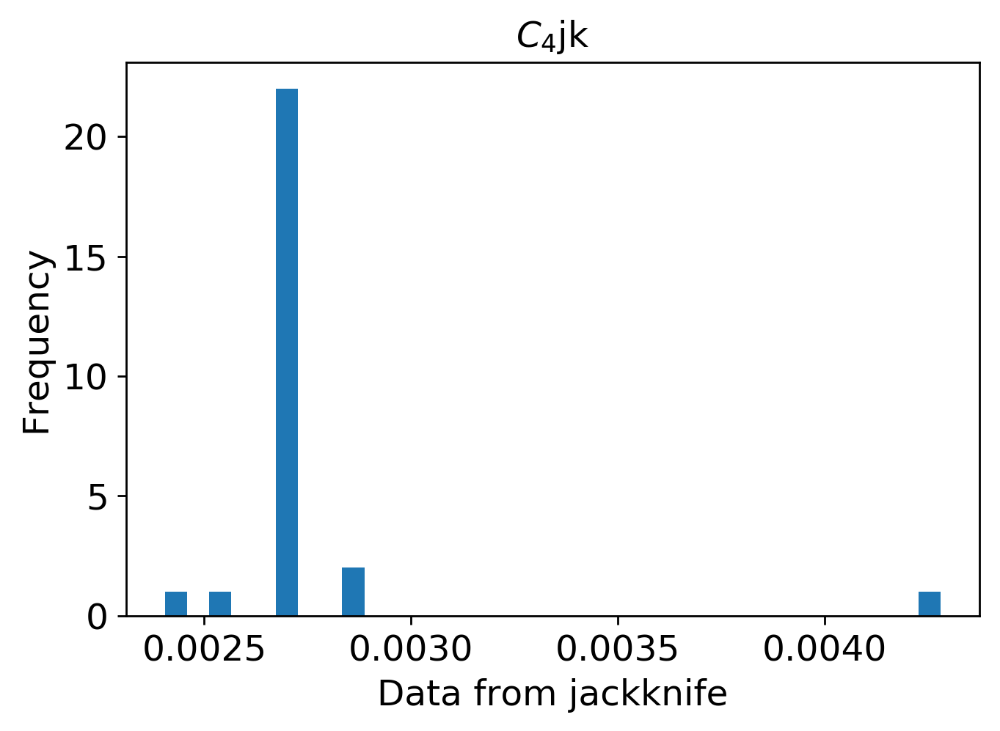

mean: 0.001120113116235566
jk_e: 8.123965998896428e-05


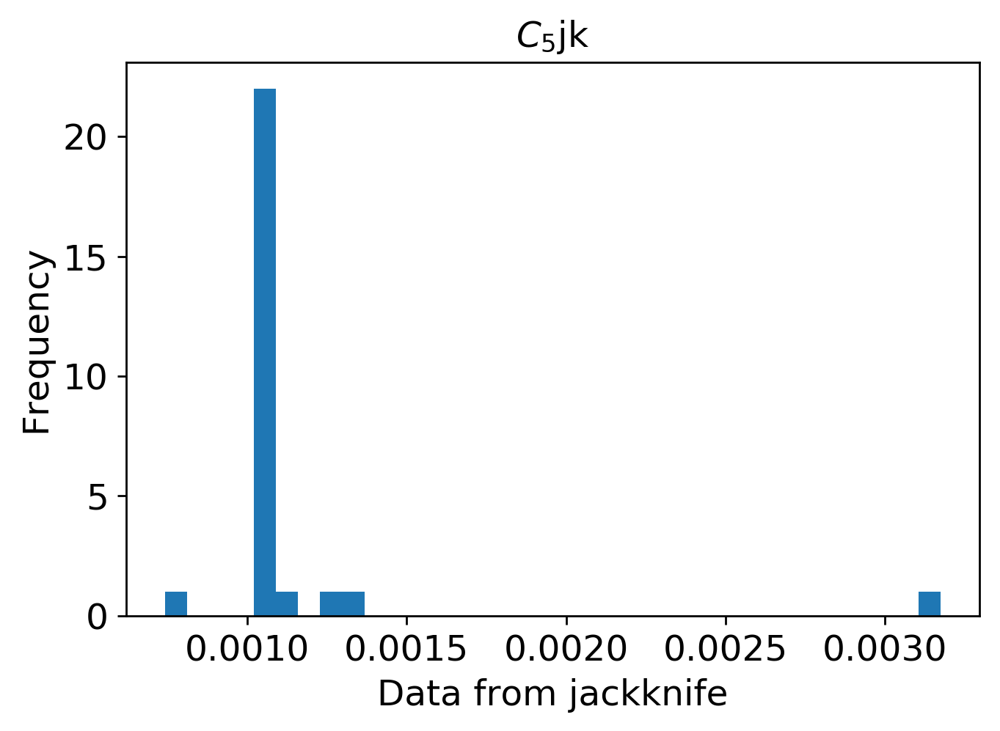

mean: 0.0013154314160770703
jk_e: 8.56487699969395e-05


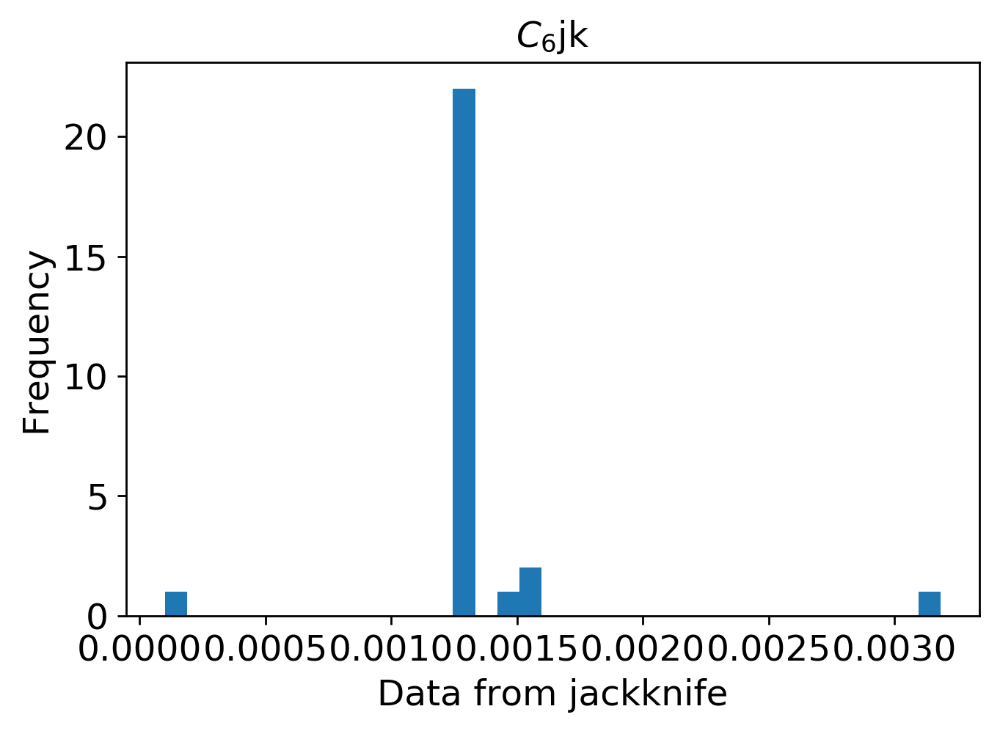

In [1]:
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi600/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi600.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi600.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi600.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()

# ROI 700

In [17]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi700"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=700)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 450us/step - loss: 0.0922 - mean_squared_error: 0.0922 - val_loss: 0.0685 - val_mean_squared_error: 0.0685
Epoch 2/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0649 - mean_squared_error: 0.0649 - val_loss: 0.0546 - val_mean_squared_error: 0.0546
Epoch 3/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0551 - mean_squared_error: 0.0551 - val_loss: 0.0466 - val_mean_squared_error: 0.0466
Epoch 4/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0489 - mean_squared_error: 0.0489 - val_loss: 0.0420 - val_mean_squared_error: 0.0420
Epoch 5/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0439 - mean_squared_error: 0.0439 - val_loss: 0.0381 - val_mean_squared_error: 0.0381
Epoch 6/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0401 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 360us/step - loss: 0.0191 - mean_squared_error: 0.0191 - val_loss: 0.0189 - val_mean_squared_error: 0.0189
Epoch 98/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0190 - mean_squared_error: 0.0190 - val_loss: 0.0176 - val_mean_squared_error: 0.0176
Epoch 99/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0192 - mean_squared_error: 0.0192 - val_loss: 0.0184 - val_mean_squared_error: 0.0184
Epoch 100/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0189 - mean_squared_error: 0.0189 - val_loss: 0.0185 - val_mean_squared_error: 0.0185
Epoch 101/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0190 - mean_squared_error: 0.0190 - val_loss: 0.0181 - val_mean_squared_error: 0.0181
Epoch 102/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0189 - mean_squared_error: 0.0189 - val_loss: 0.0179 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 349us/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 0.0104 - val_mean_squared_error: 0.0104
Epoch 194/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0124 - mean_squared_error: 0.0124 - val_loss: 0.0094 - val_mean_squared_error: 0.0094
Epoch 195/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0124 - mean_squared_error: 0.0124 - val_loss: 0.0098 - val_mean_squared_error: 0.0098
Epoch 196/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0089 - val_mean_squared_error: 0.0089
Epoch 197/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0087 - val_mean_squared_error: 0.0087
Epoch 198/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0092 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 352us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0078 - val_mean_squared_error: 0.0078
Epoch 290/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 291/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 292/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 293/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0082 - val_mean_squared_error: 0.0082
Epoch 294/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0073 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 334us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 386/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 387/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 388/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 389/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 390/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0064 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 336us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 482/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 483/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 484/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 485/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 486/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0052 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 348us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 578/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 579/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 580/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 581/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 582/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0050 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 362us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 674/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 675/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 676/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 677/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 678/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0048 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 770/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 771/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 772/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 773/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 774/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0042 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 338us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 866/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 867/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 868/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 869/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 870/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0040 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 326us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 962/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 963/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 964/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 965/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 966/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 352us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1058/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1059/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1060/2000
3600/3600 [==============================] - 1s 320us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1061/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1062/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 364us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 1106/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1107/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1108/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1109/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1110/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0037 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1154/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1155/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1156/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1157/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 1158/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0042 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1202/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1203/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1204/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1205/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1206/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 349us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1250/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 1251/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1252/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1253/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 1254/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0041 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1298/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1299/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1300/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1301/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1302/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0037 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1346/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1347/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1348/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1349/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1350/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1394/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1395/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1396/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1397/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1398/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 364us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1442/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1443/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1444/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1445/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1446/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1490/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1491/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1492/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1493/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1494/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0037 - val_mean_squared_erro

3600/3600 [==============================] - 1s 362us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1538/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1539/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1540/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1541/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1542/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1586/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1587/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1588/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1589/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1590/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 332us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1634/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1635/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1636/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1637/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1638/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0034 - val_mean_squared_erro

3600/3600 [==============================] - 1s 345us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1682/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1683/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1684/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1685/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1686/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1730/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1731/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1732/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1733/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1734/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1778/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1779/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1780/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1781/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1782/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1826/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1827/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1828/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1829/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1830/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1874/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1875/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1876/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1877/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1878/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 358us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1922/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1923/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1924/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1925/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1926/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 374us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1970/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1971/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1972/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1973/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1974/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_erro

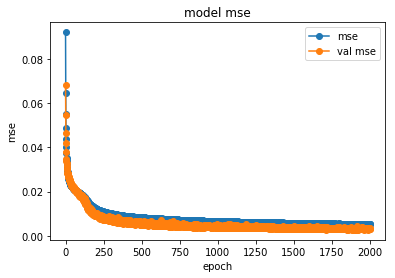

save the model


In [18]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi700/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi700/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


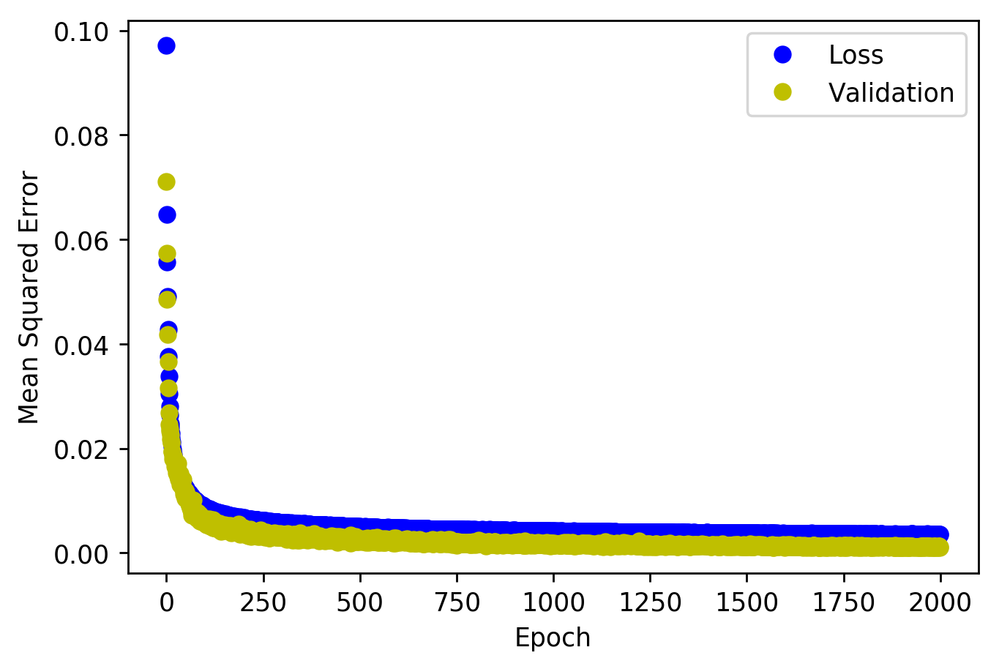

<Figure size 432x288 with 0 Axes>

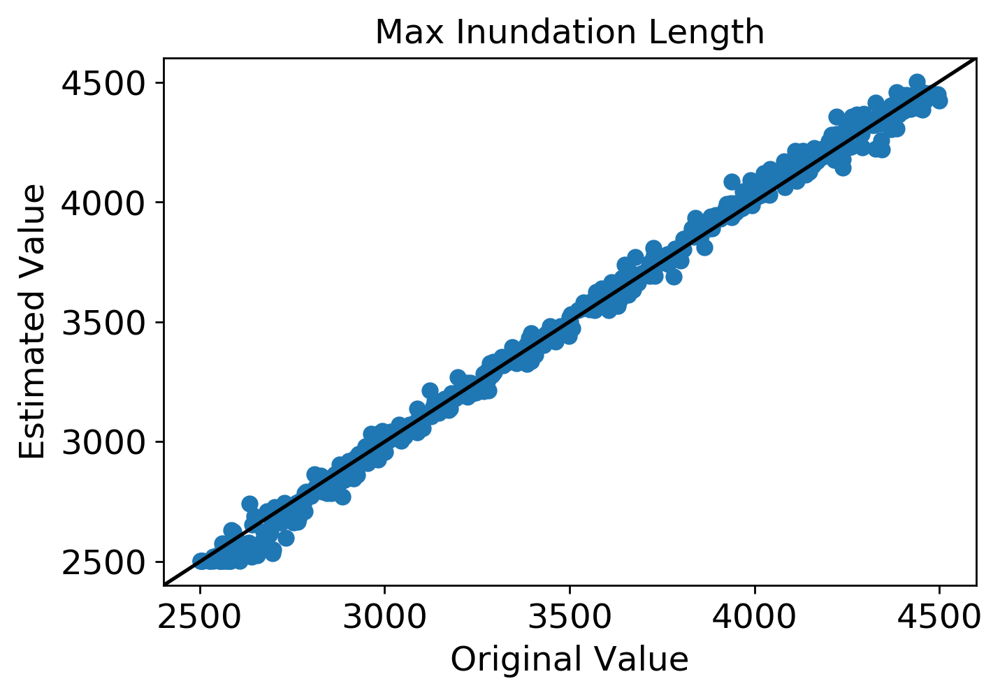

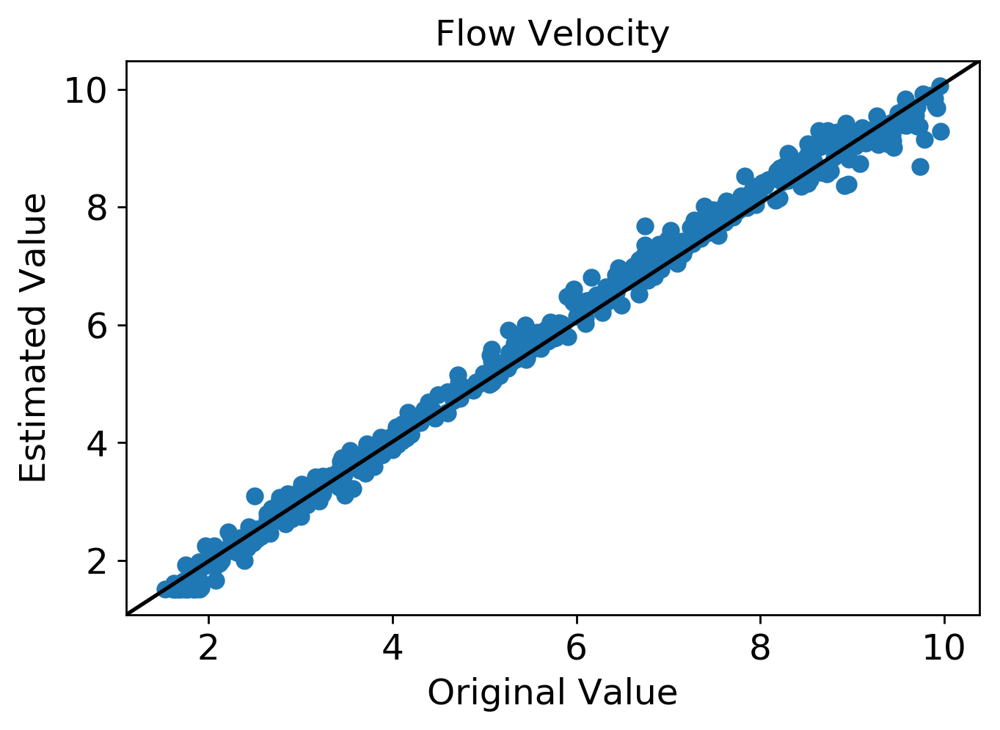

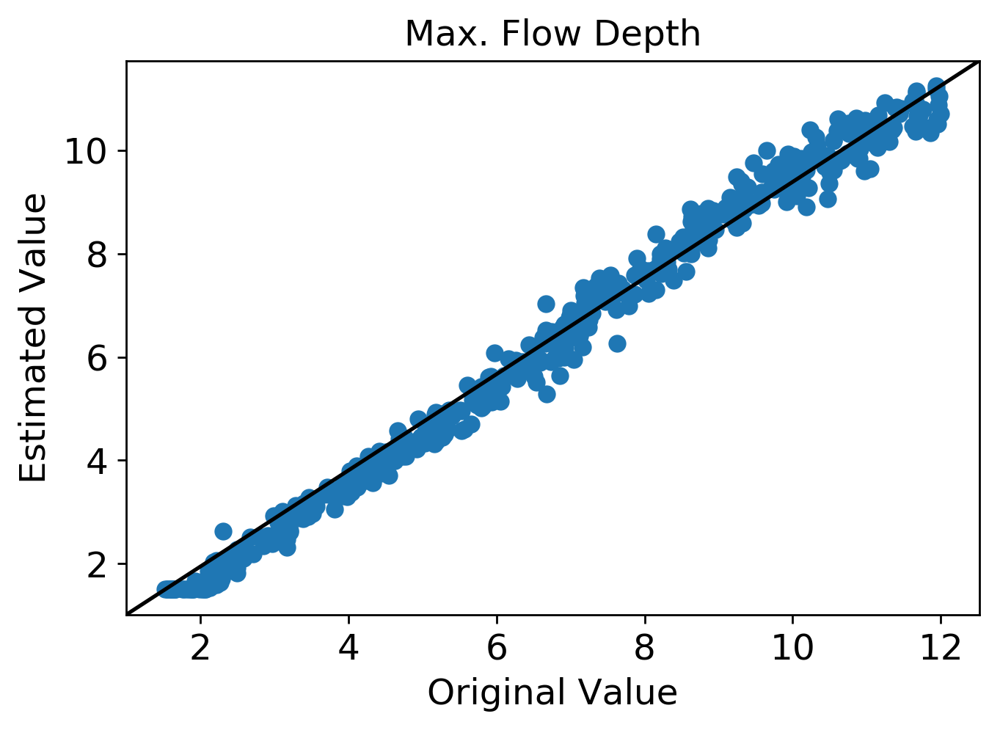

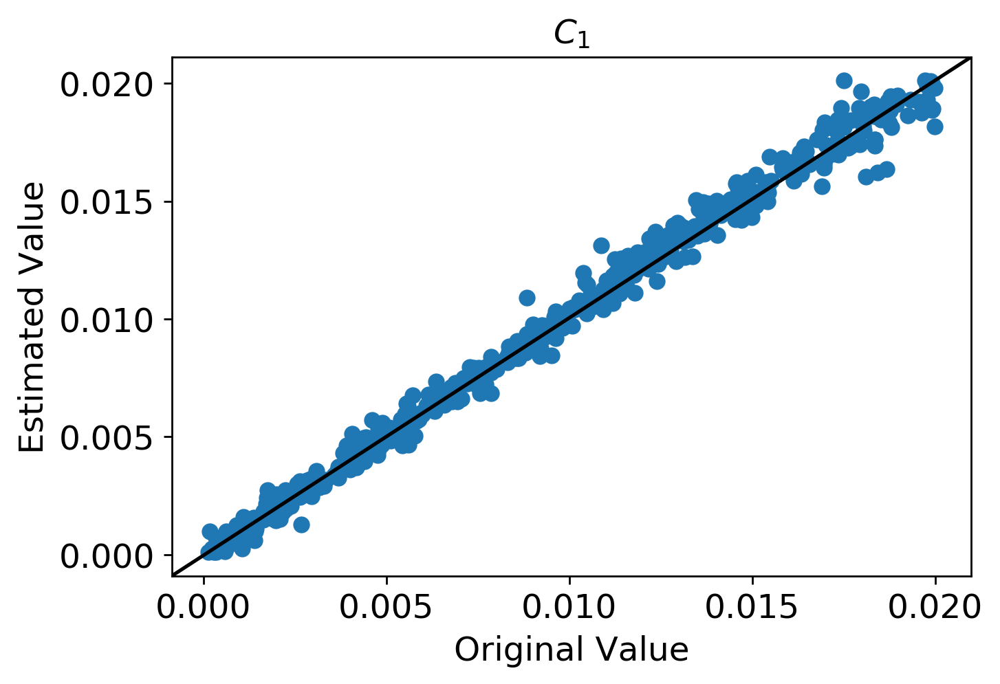

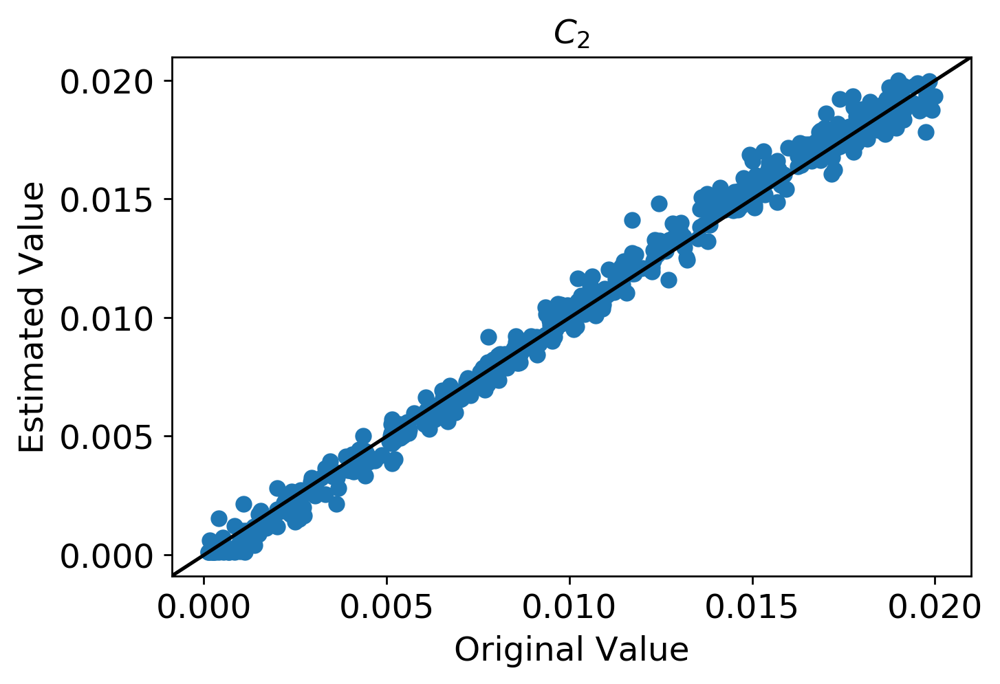

...

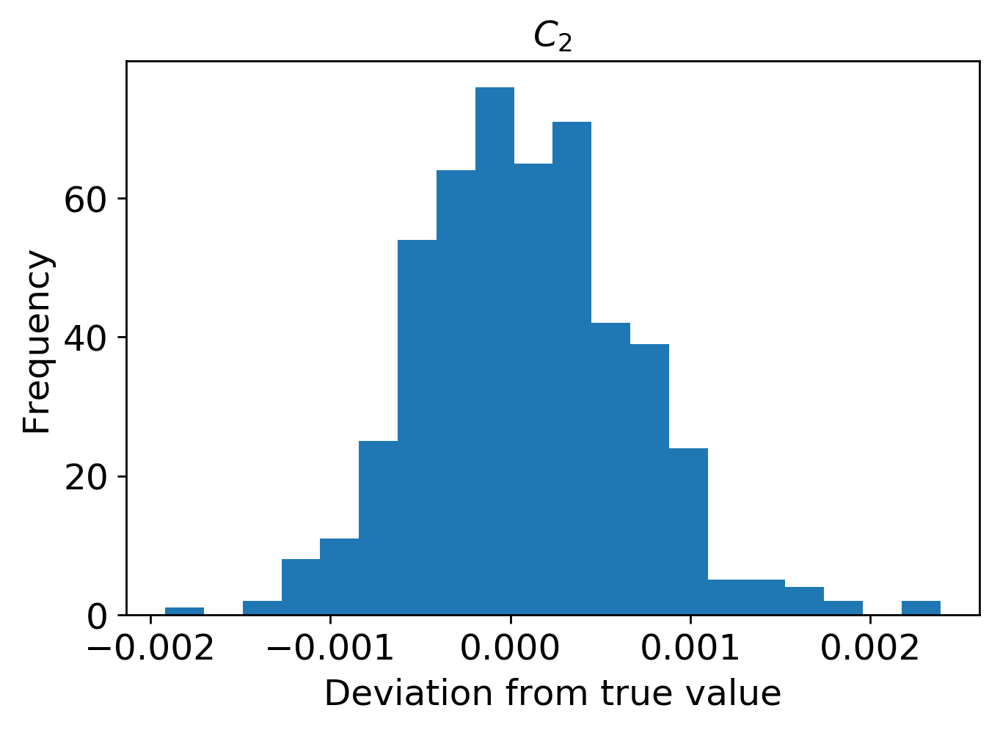

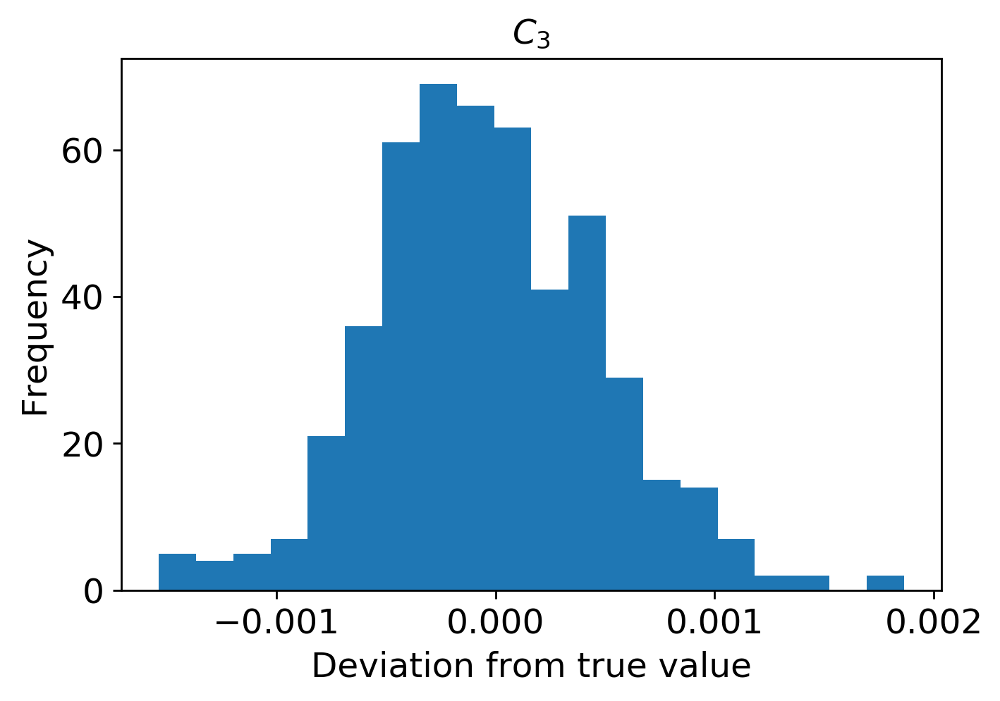

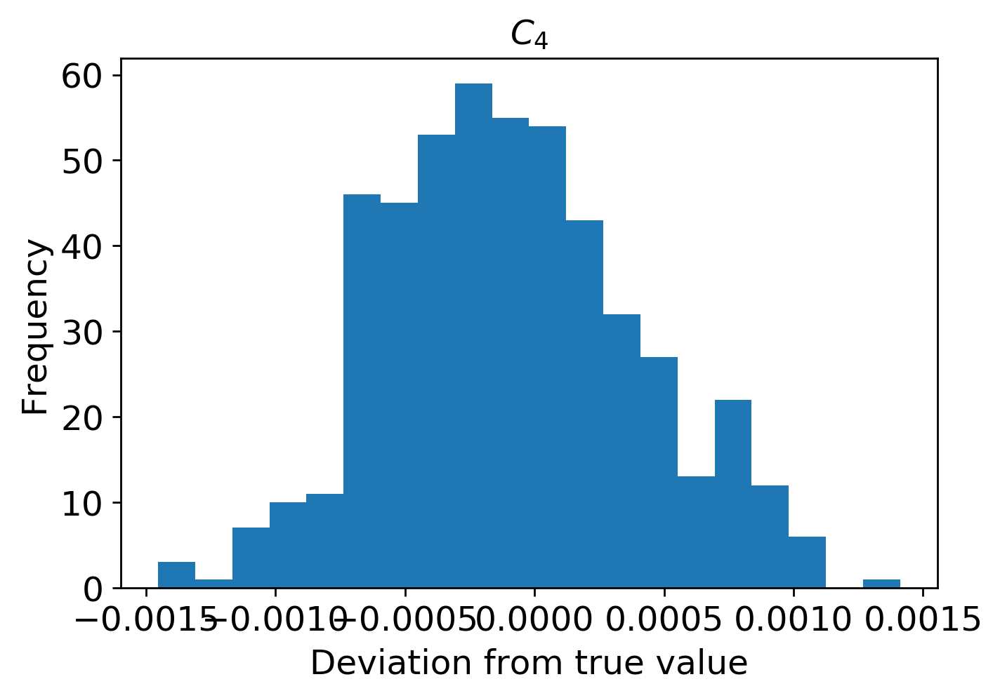

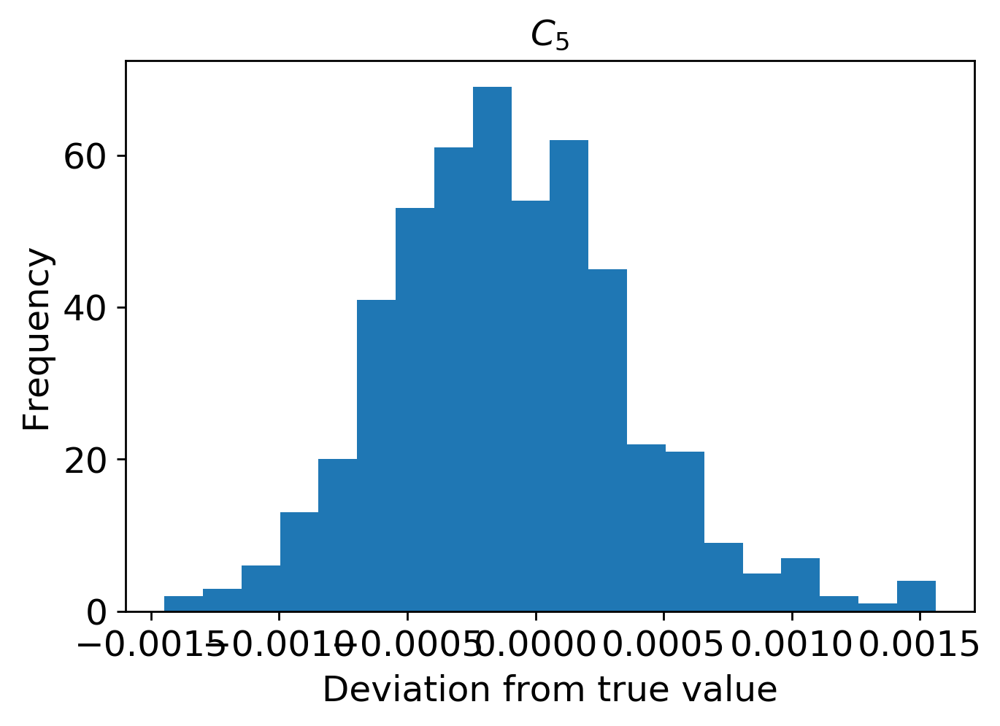

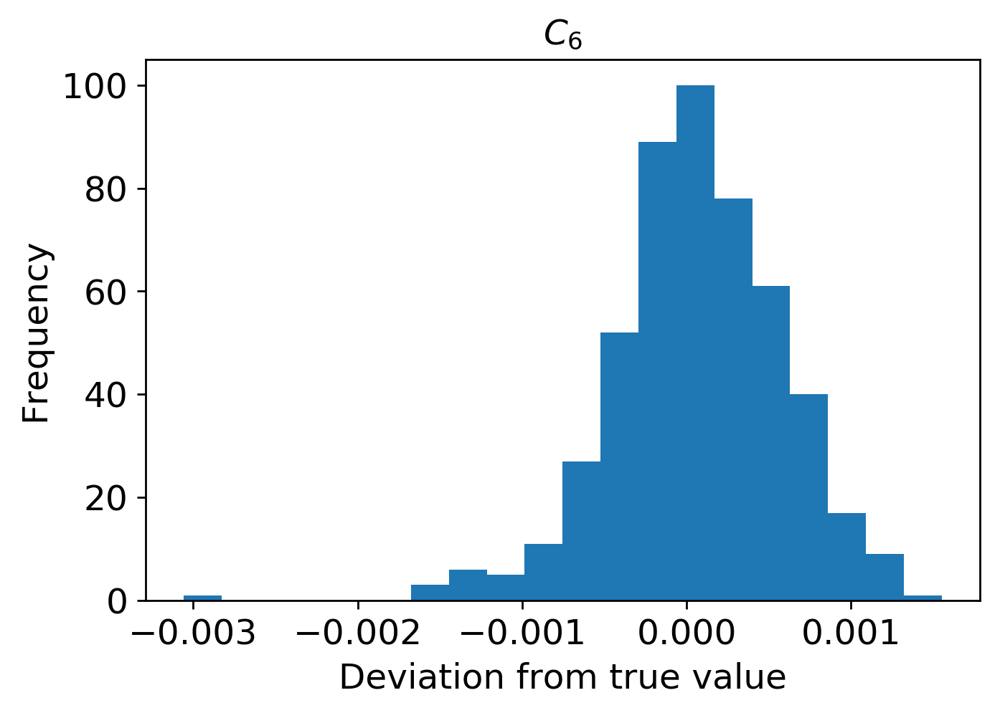

In [19]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi4000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi4000/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

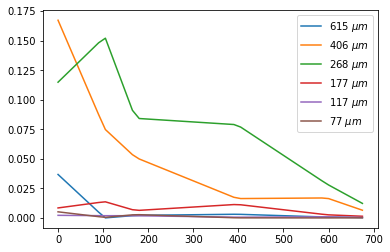

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi700/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=700
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi700.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



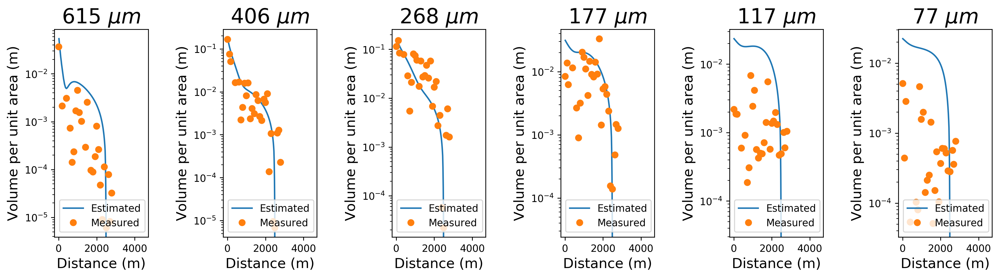

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi700.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi700.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi700.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi700.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi700.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi700.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi700.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi700.eps")
plt.show()

Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


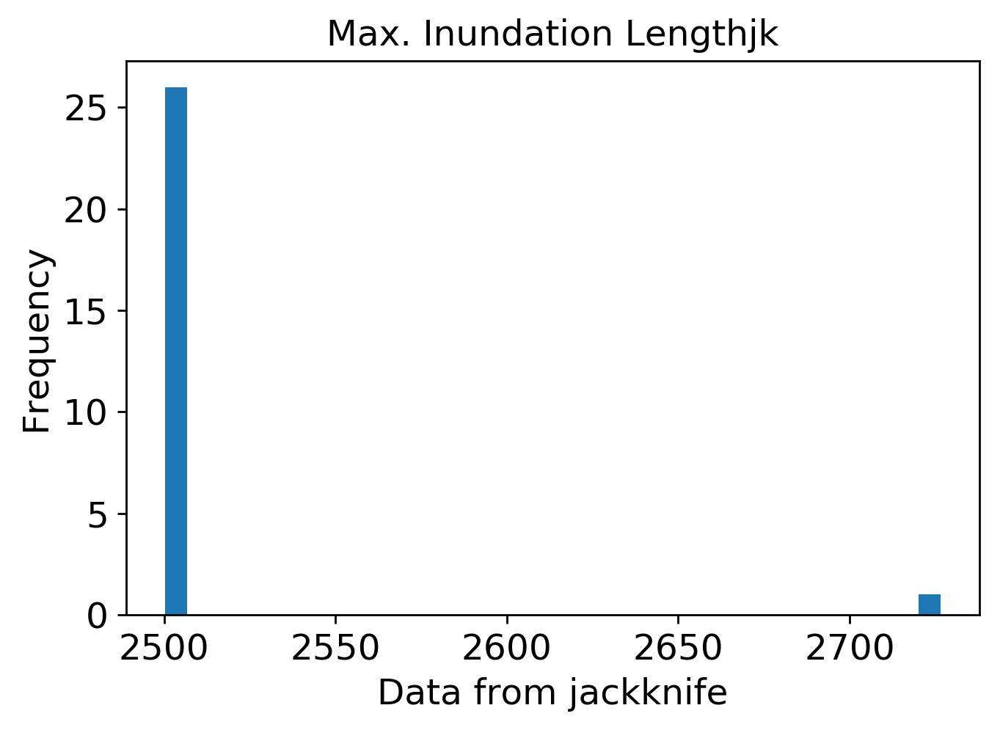

mean: 7.3766660640315305
jk_e: 0.11453715566245369


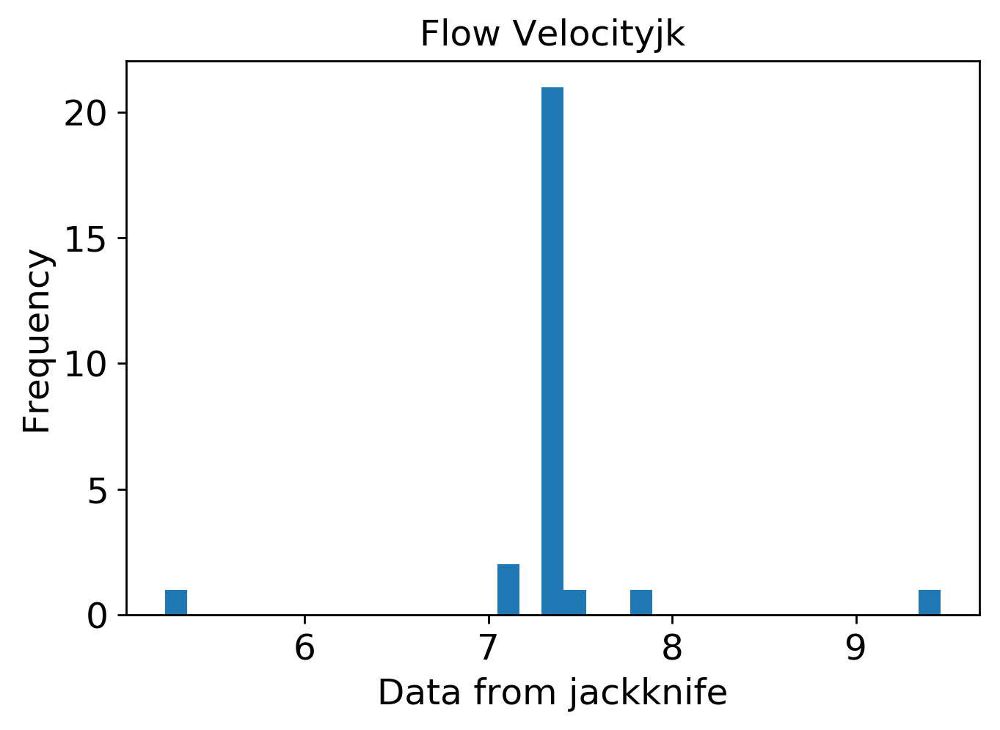

mean: 4.8031968801955305
jk_e: 0.034134687324180644


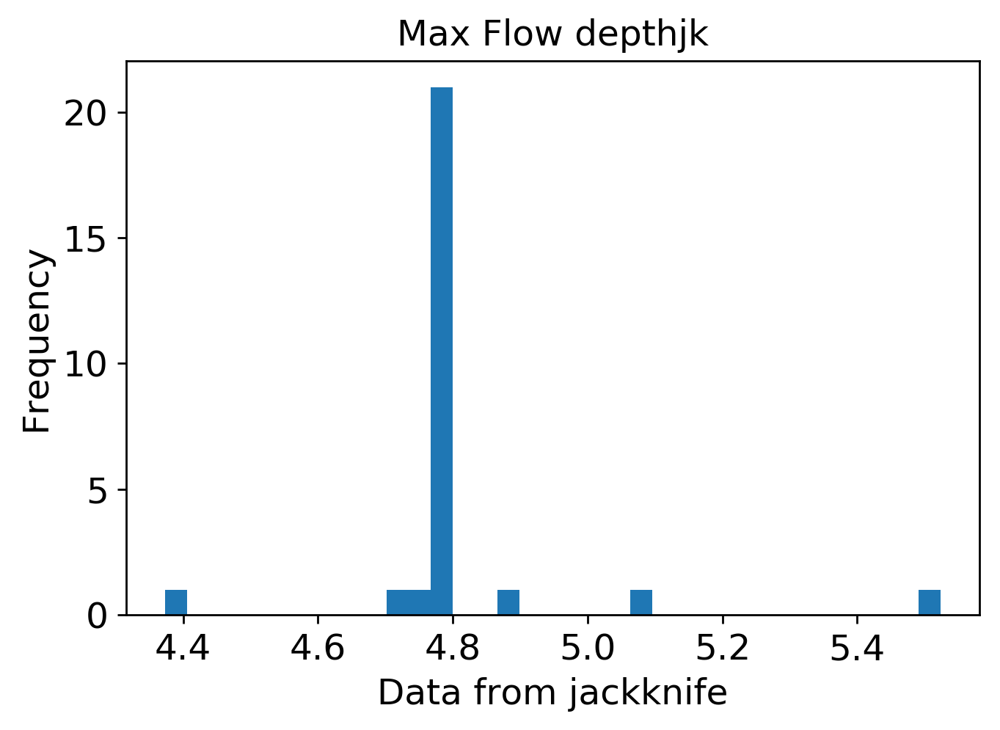

mean: 0.007473457070465138
jk_e: 0.00026799980109408516


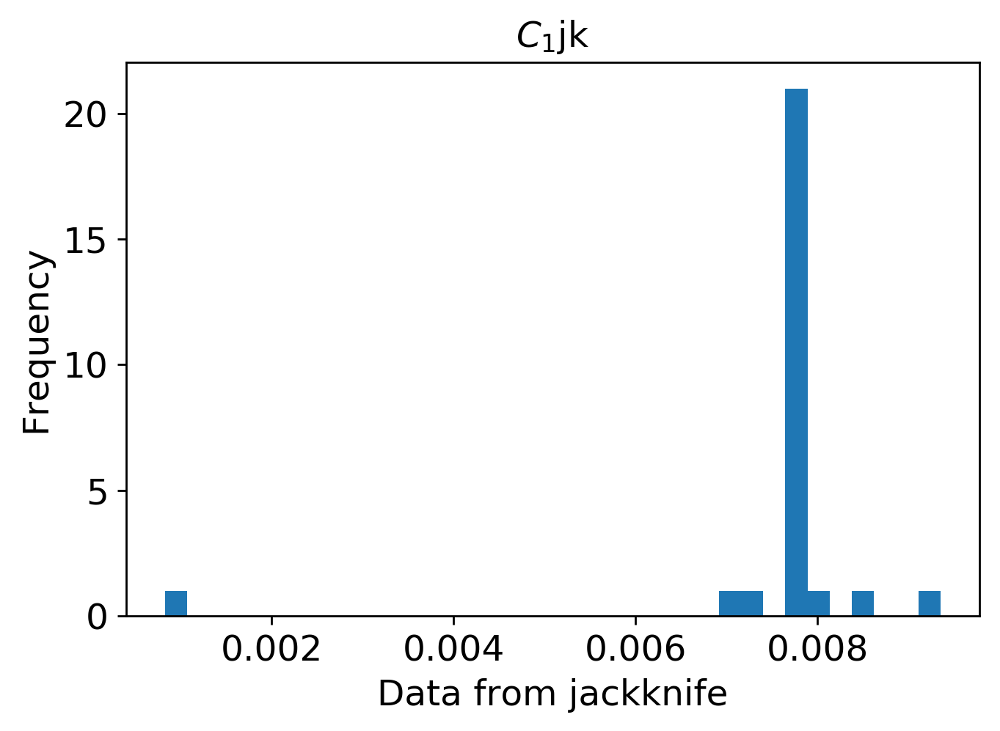

mean: 0.022958068865124952
jk_e: 0.0002536570630276741


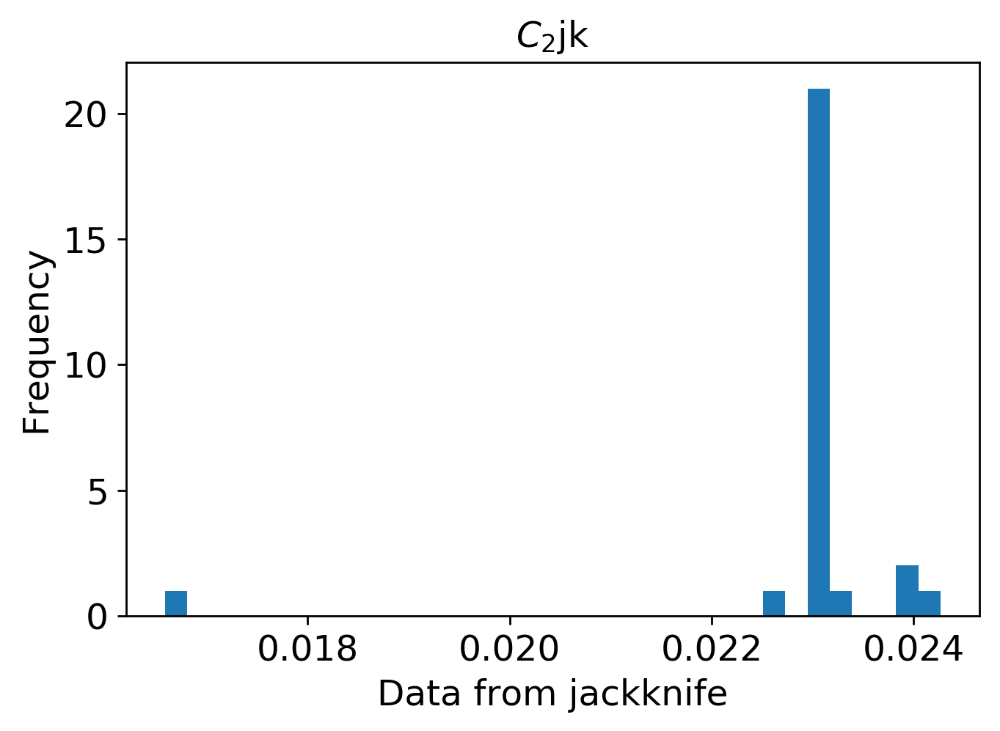

mean: 0.021733108407269348
jk_e: 0.00025414689681003543


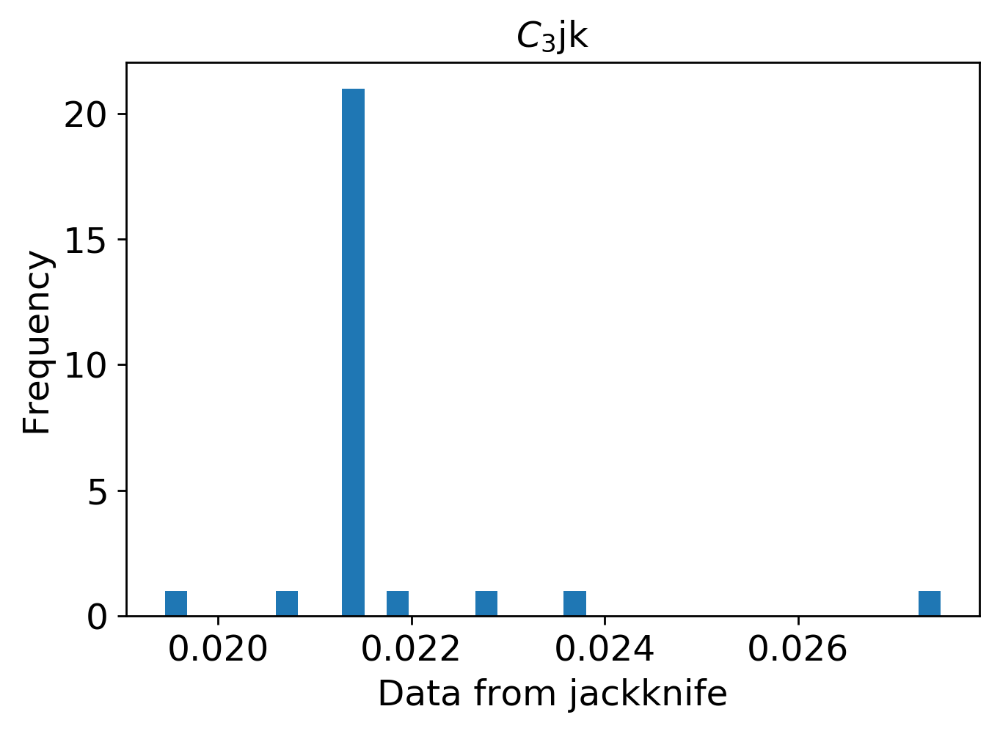

mean: 0.00402212964164745
jk_e: 6.851751313287726e-05


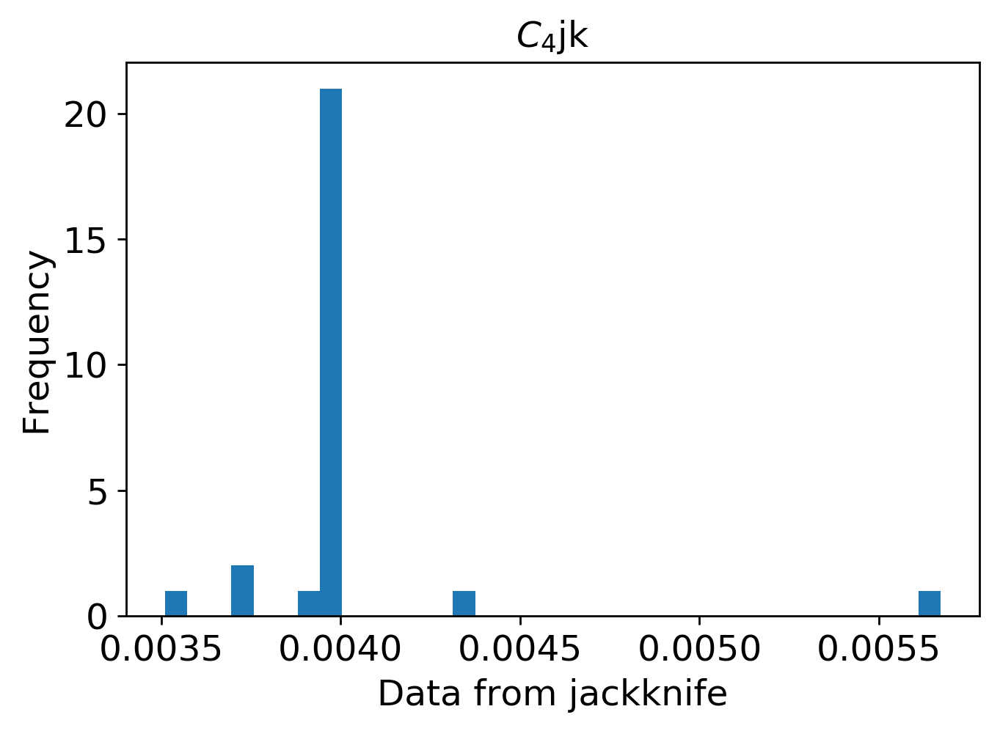

mean: 0.0030248205805083633
jk_e: 9.350443719747887e-05


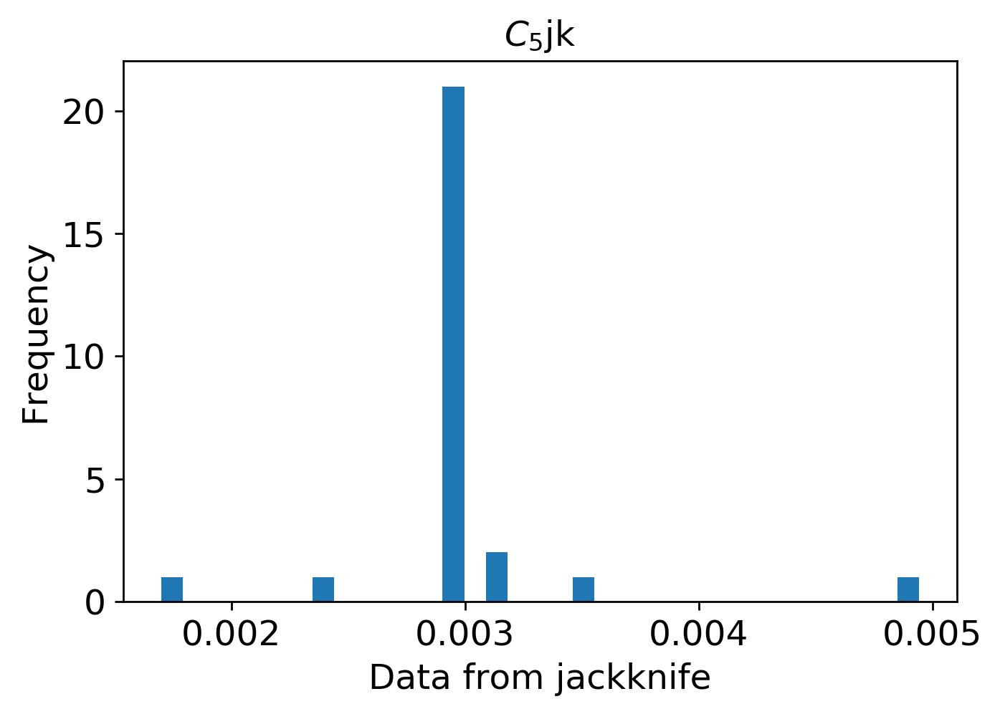

mean: 0.002895471624474052
jk_e: 0.00010000246958676059


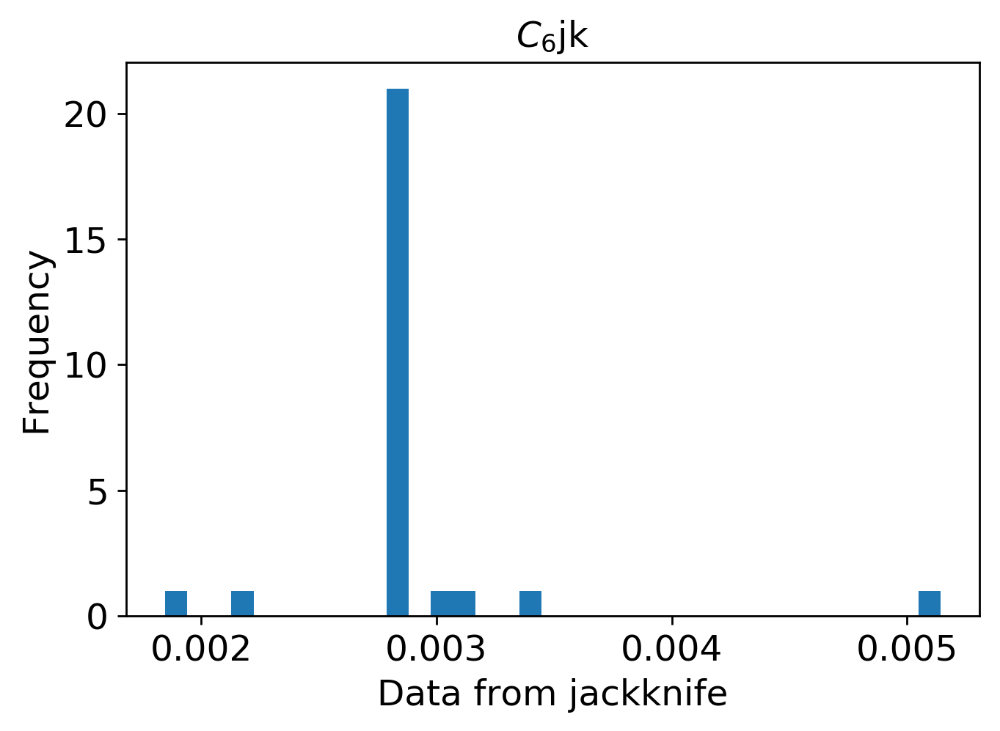

In [1]:
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi700/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi700.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi700.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi700.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()

# ROI 800

In [23]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi800"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=800)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 455us/step - loss: 0.0943 - mean_squared_error: 0.0943 - val_loss: 0.0704 - val_mean_squared_error: 0.0704
Epoch 2/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0652 - mean_squared_error: 0.0652 - val_loss: 0.0570 - val_mean_squared_error: 0.0570
Epoch 3/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0562 - mean_squared_error: 0.0562 - val_loss: 0.0489 - val_mean_squared_error: 0.0489
Epoch 4/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0500 - mean_squared_error: 0.0500 - val_loss: 0.0443 - val_mean_squared_error: 0.0443
Epoch 5/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0452 - mean_squared_error: 0.0452 - val_loss: 0.0407 - val_mean_squared_error: 0.0407
Epoch 6/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0414 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 359us/step - loss: 0.0177 - mean_squared_error: 0.0177 - val_loss: 0.0162 - val_mean_squared_error: 0.0162
Epoch 98/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0177 - mean_squared_error: 0.0177 - val_loss: 0.0157 - val_mean_squared_error: 0.0157
Epoch 99/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0174 - mean_squared_error: 0.0174 - val_loss: 0.0170 - val_mean_squared_error: 0.0170
Epoch 100/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0175 - mean_squared_error: 0.0175 - val_loss: 0.0160 - val_mean_squared_error: 0.0160
Epoch 101/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0173 - mean_squared_error: 0.0173 - val_loss: 0.0157 - val_mean_squared_error: 0.0157
Epoch 102/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0173 - mean_squared_error: 0.0173 - val_loss: 0.0152 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 344us/step - loss: 0.0116 - mean_squared_error: 0.0116 - val_loss: 0.0094 - val_mean_squared_error: 0.0094
Epoch 194/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0085 - val_mean_squared_error: 0.0085
Epoch 195/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0088 - val_mean_squared_error: 0.0088
Epoch 196/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0082 - val_mean_squared_error: 0.0082
Epoch 197/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0085 - val_mean_squared_error: 0.0085
Epoch 198/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0114 - mean_squared_error: 0.0114 - val_loss: 0.0087 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 367us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 290/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 291/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0071 - val_mean_squared_error: 0.0071
Epoch 292/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0074 - val_mean_squared_error: 0.0074
Epoch 293/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0071 - val_mean_squared_error: 0.0071
Epoch 294/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0065 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 386/2000
3600/3600 [==============================] - 1s 320us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 387/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 388/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 389/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 390/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0057 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 350us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 482/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 483/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 484/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 485/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 486/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0054 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 343us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 578/2000
3600/3600 [==============================] - 1s 322us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 579/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 580/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 581/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 582/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0040 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 345us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 674/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 675/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 676/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 677/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 678/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0047 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 343us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 770/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 771/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 772/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 773/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 774/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 362us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 866/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 867/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 868/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 869/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 870/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0043 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 337us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 962/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 963/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 964/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 965/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 966/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0039 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 357us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1058/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 1059/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1060/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1061/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1062/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1106/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1107/2000
3600/3600 [==============================] - 1s 323us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1108/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1109/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1110/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 358us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1154/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1155/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1156/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1157/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1158/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0041 - val_mean_squared_erro

3600/3600 [==============================] - 1s 338us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1202/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1203/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1204/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1205/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1206/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1250/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1251/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1252/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1253/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1254/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0034 - val_mean_squared_erro

3600/3600 [==============================] - 1s 405us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1298/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1299/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1300/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1301/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1302/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_erro

3600/3600 [==============================] - 1s 395us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1346/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1347/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1348/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1349/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1350/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1394/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1395/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1396/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1397/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1398/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 358us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1442/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1443/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1444/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1445/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1446/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1490/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1491/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1492/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1493/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1494/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0034 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1538/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1539/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1540/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1541/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1542/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1586/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1587/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1588/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1589/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1590/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1634/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1635/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1636/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1637/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1638/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 374us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1682/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1683/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1684/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1685/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1686/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 349us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1730/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1731/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1732/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1733/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1734/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1778/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1779/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1780/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1781/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1782/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 332us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1826/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1827/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1828/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1829/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1830/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1874/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1875/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1876/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1877/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1878/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 352us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1922/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1923/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1924/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1925/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1926/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1970/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1971/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1972/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1973/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1974/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_erro

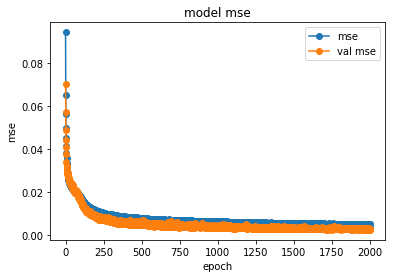

save the model


In [24]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi800/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi800/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


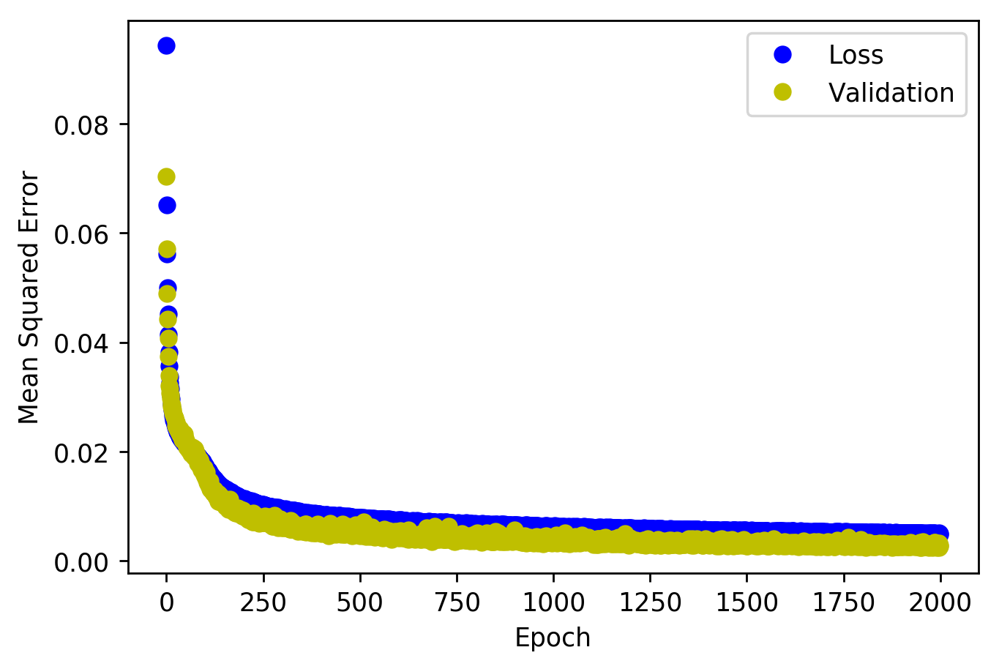

<Figure size 432x288 with 0 Axes>

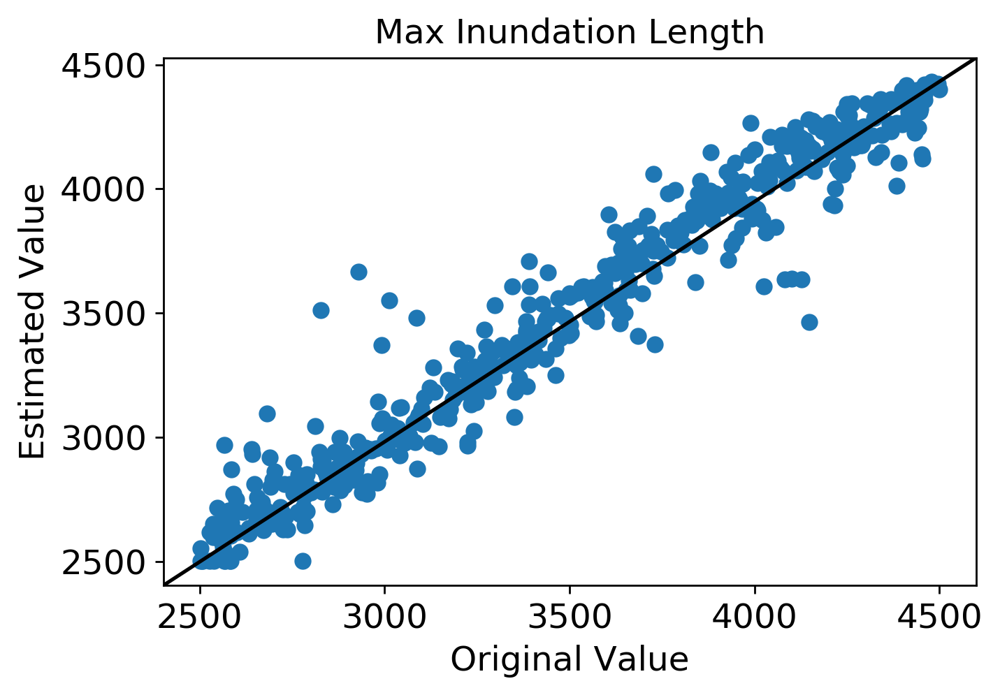

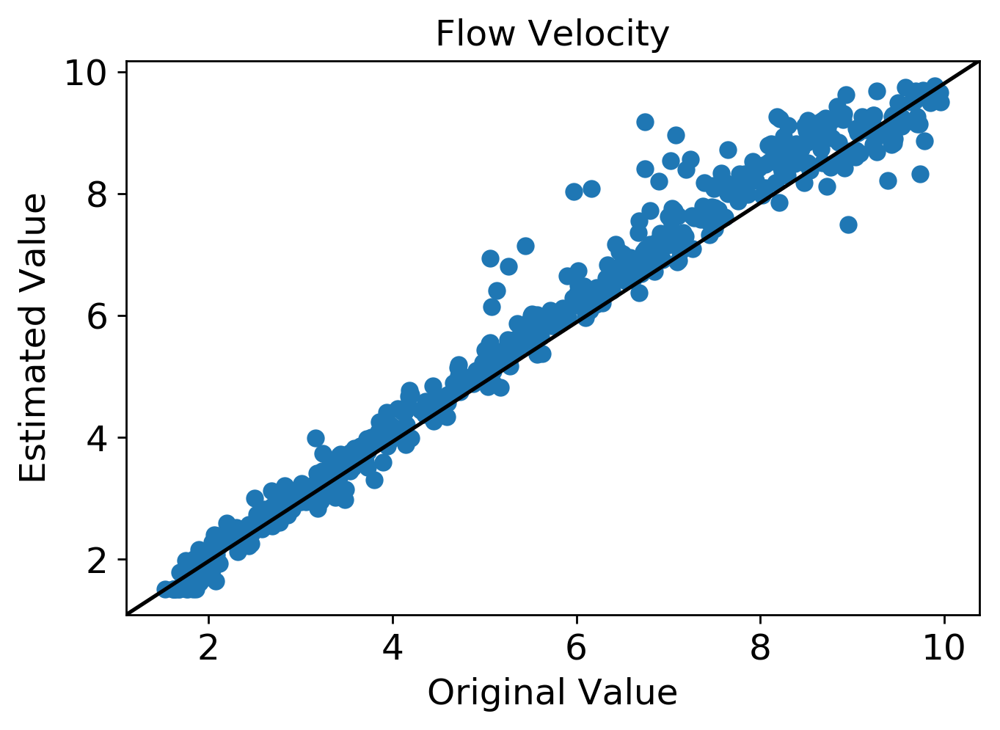

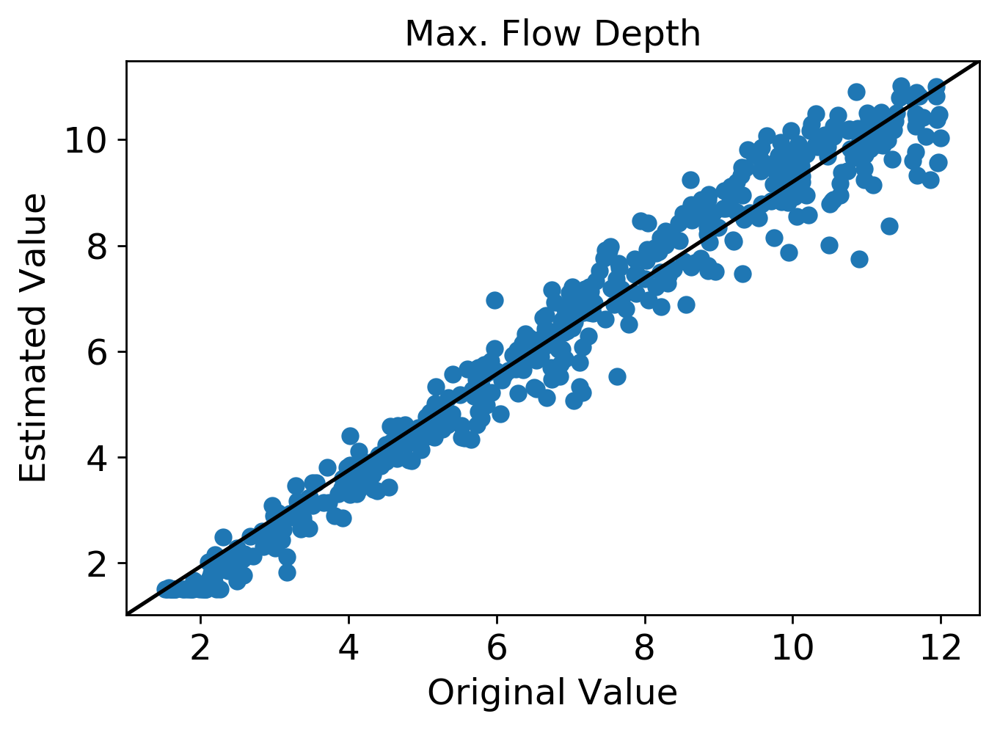

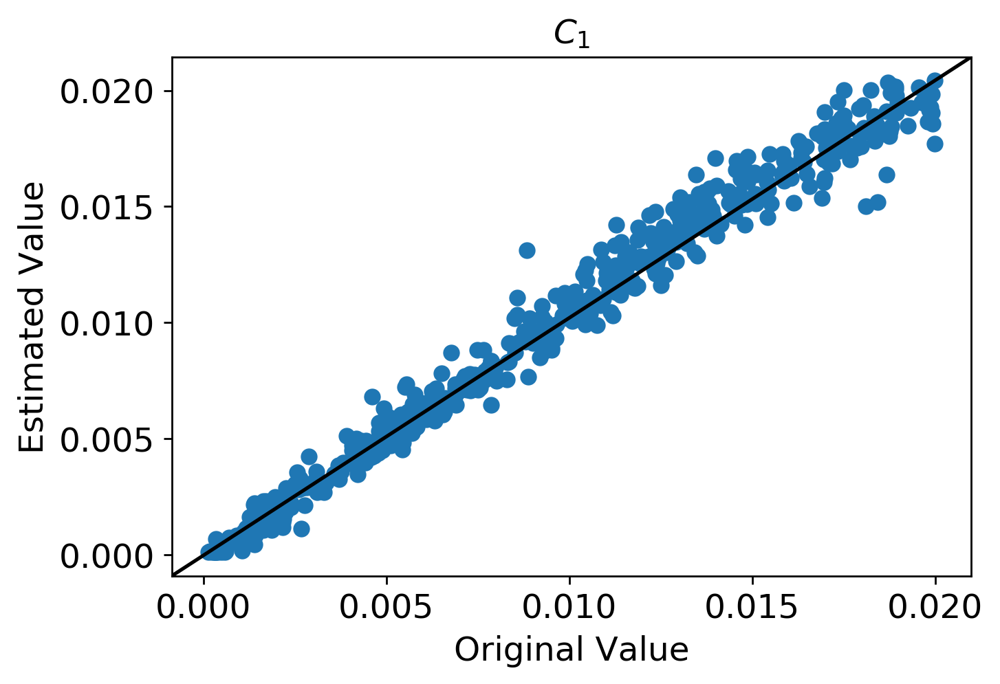

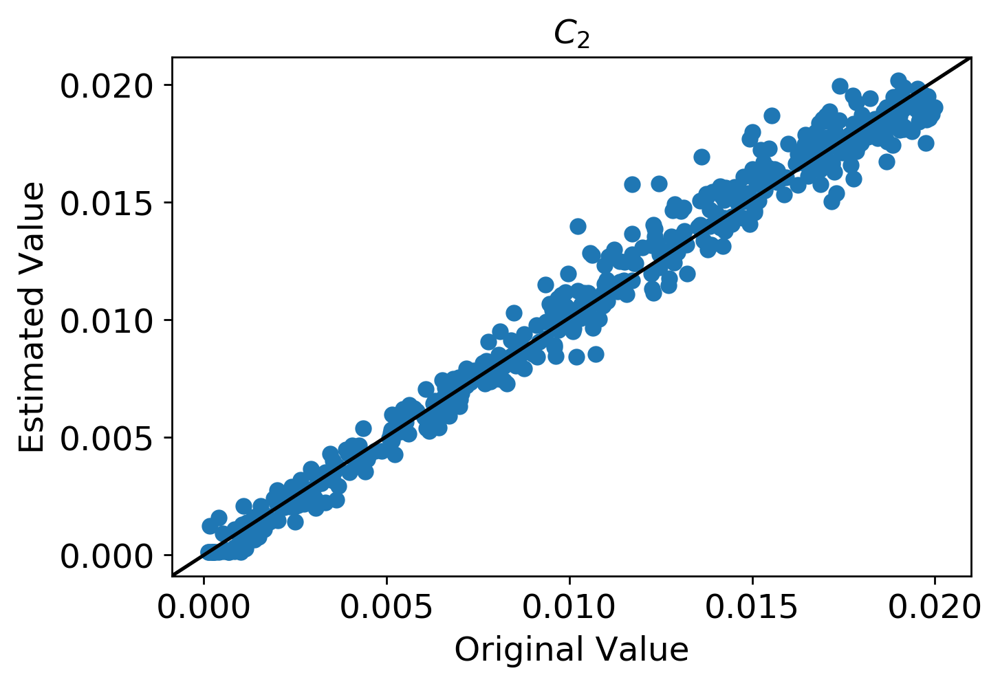

...

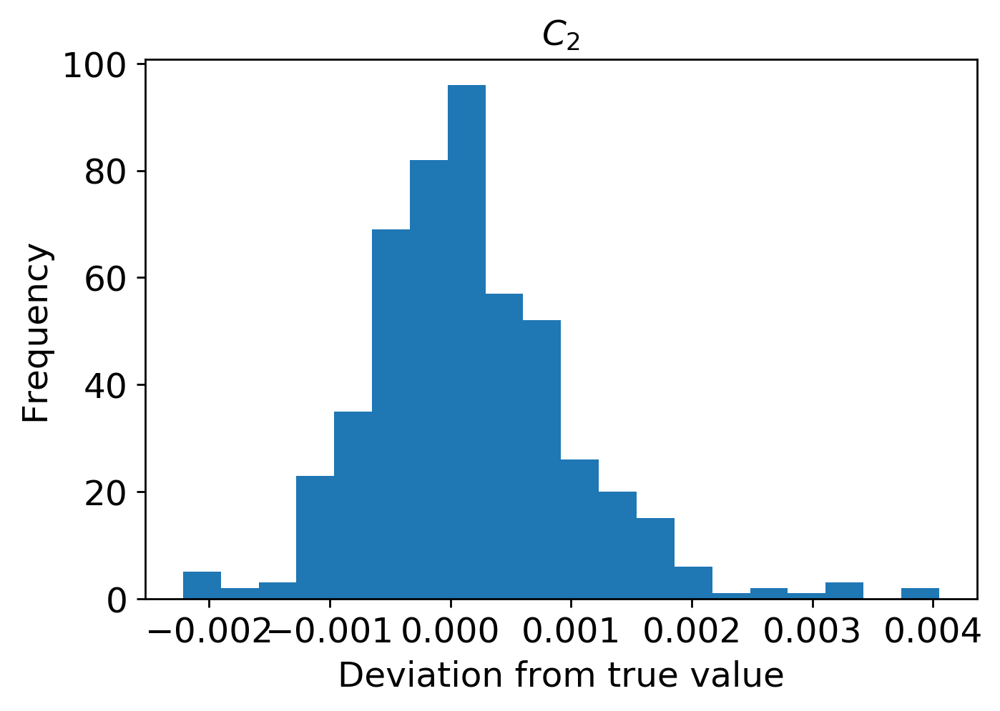

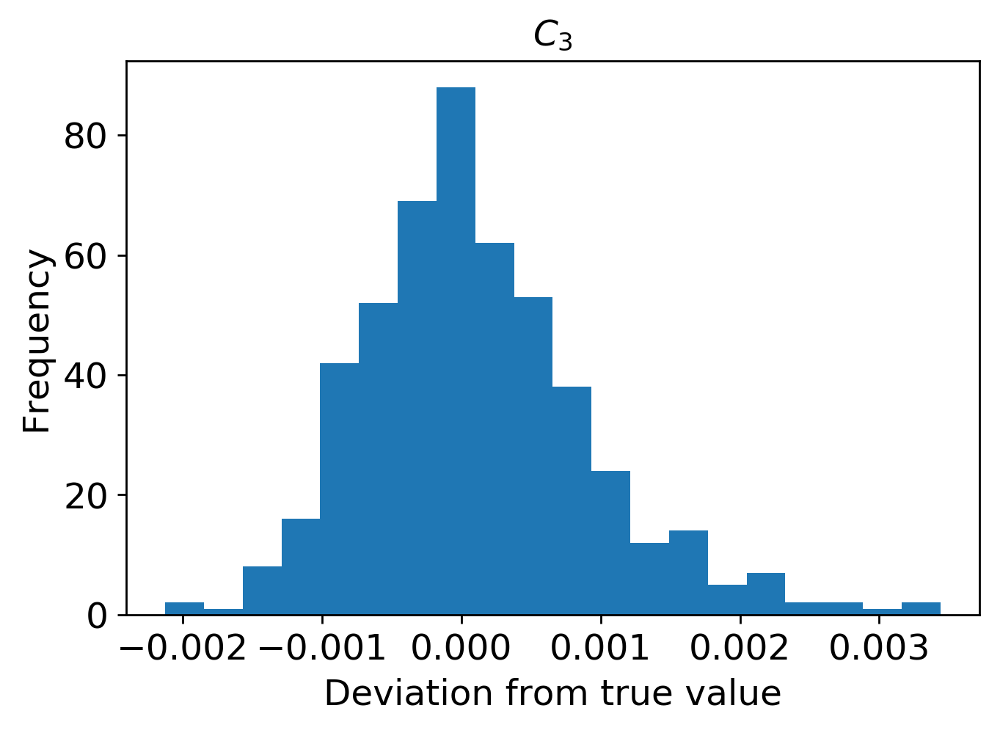

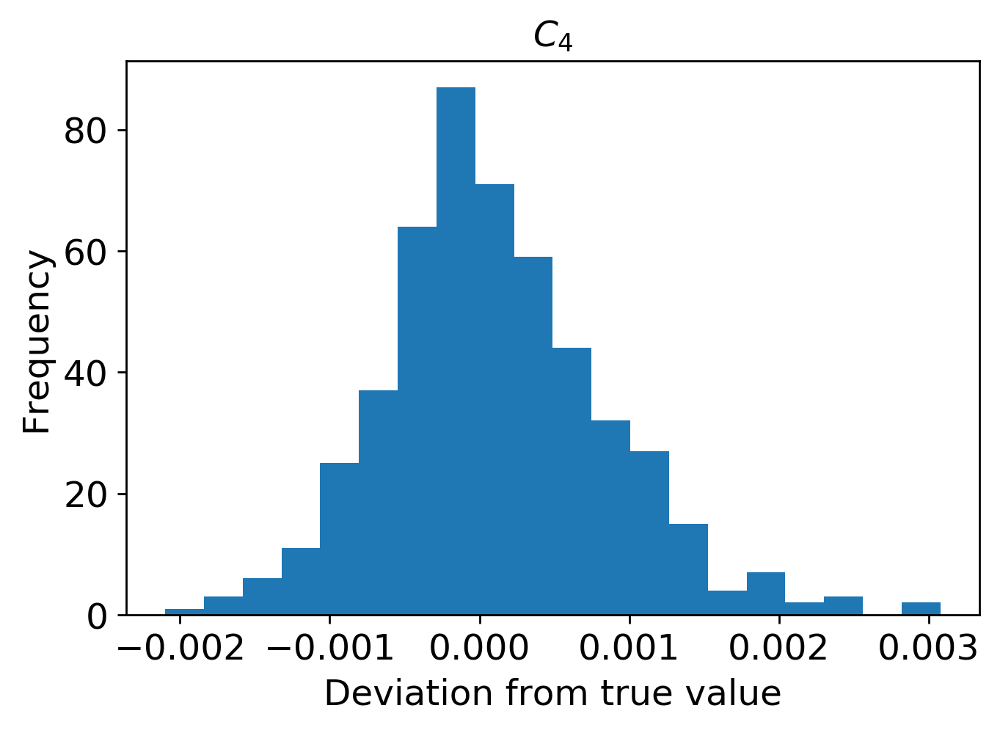

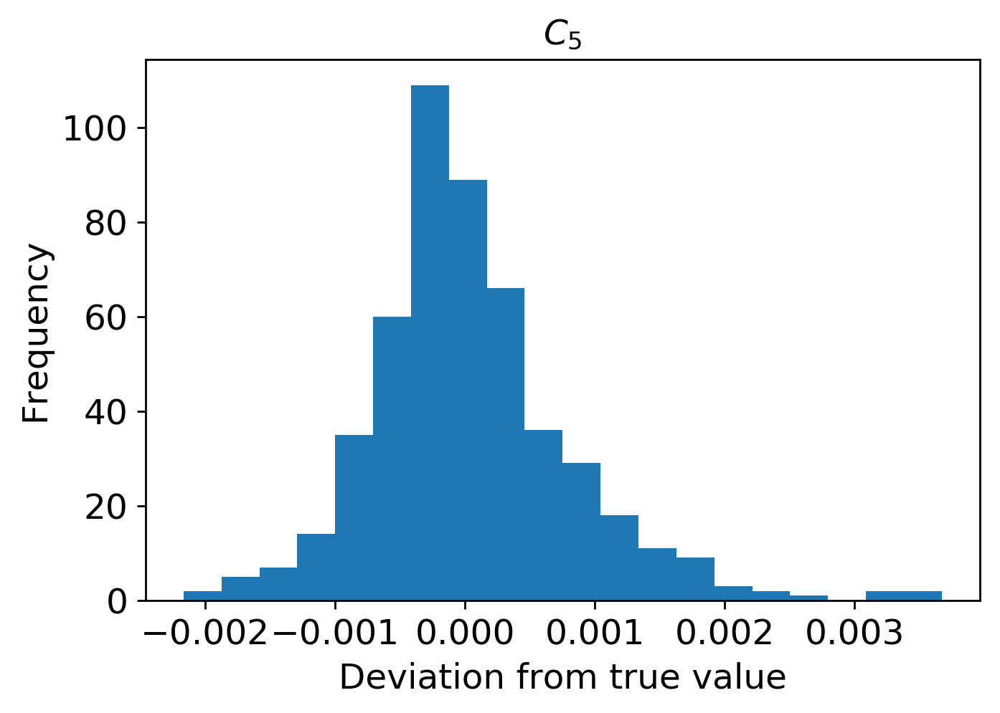

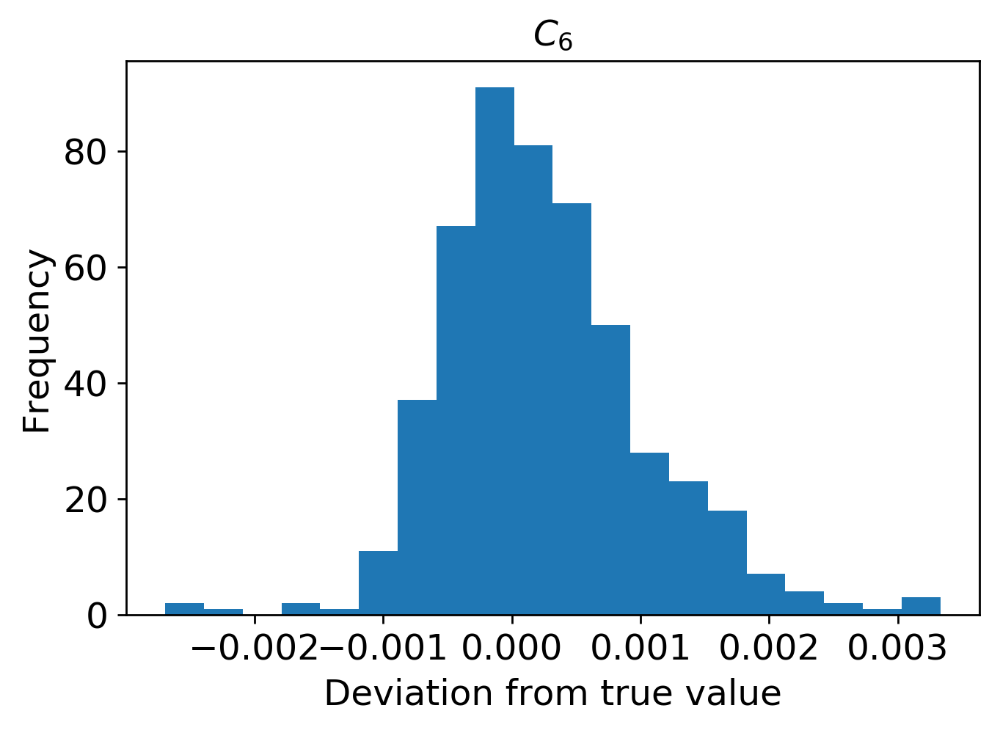

In [25]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi800/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

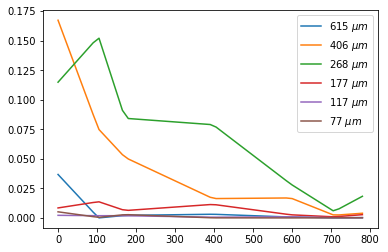

In [26]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi800/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='power',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi800.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



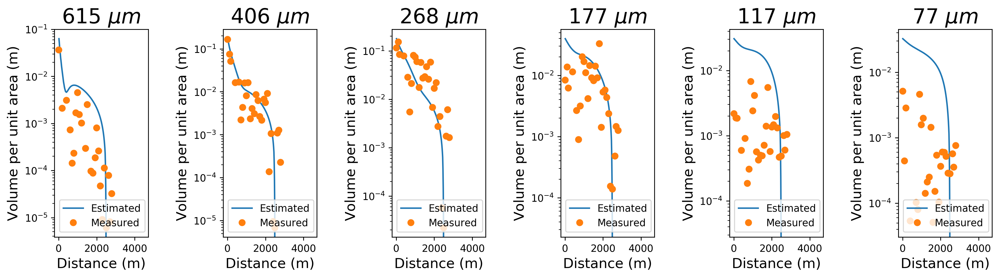

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi800.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi800.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi800.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi800.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi800.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi800.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi800.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi800.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[2.50024160e+03 7.40422607e+00 4.55869250e+00 9.43570426e-03
  2.43170119e-02 2.42543197e-02 5.33504834e-03 4.08361775e-03
  4.29736551e-03]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


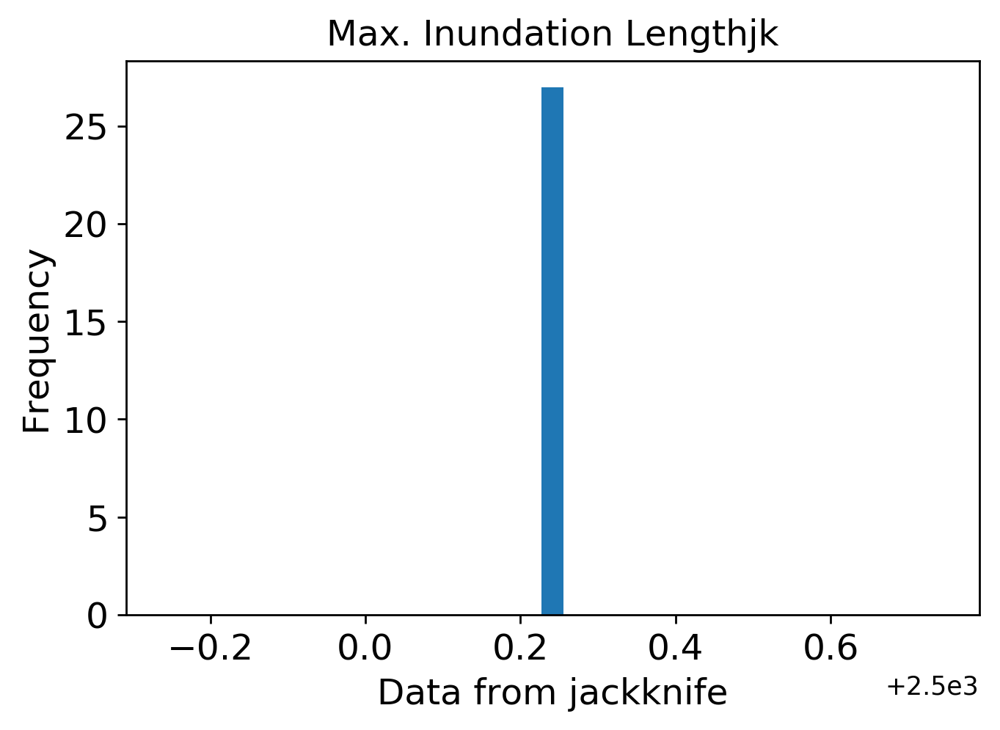

mean: 7.391373625058857
jk_e: 0.11230530030869897


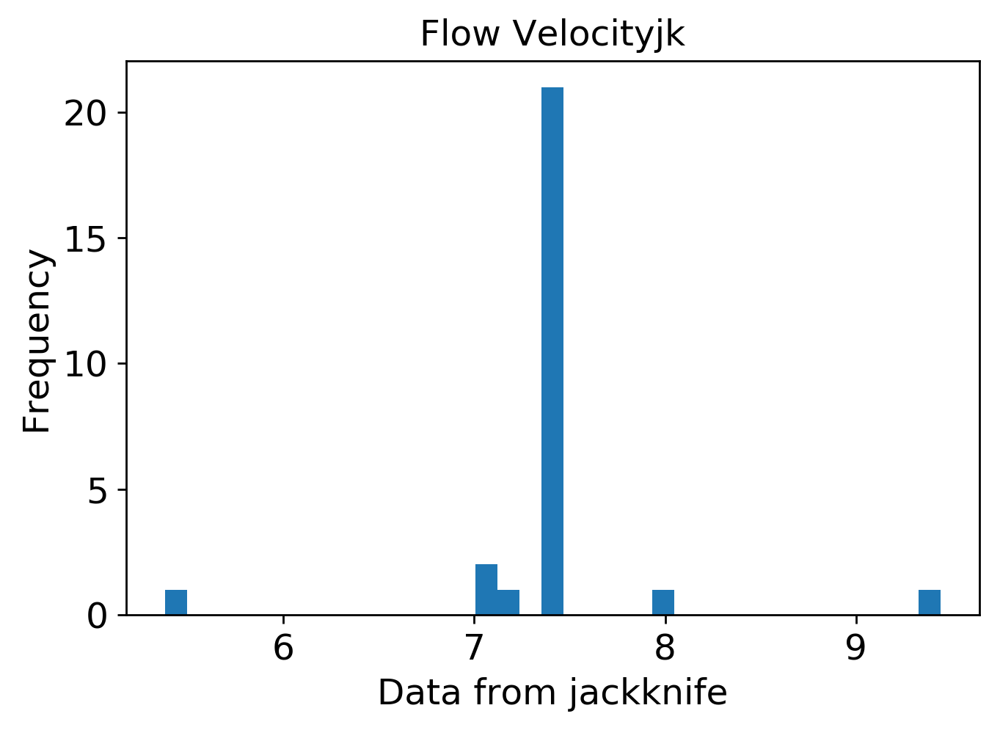

mean: 4.592811652532346
jk_e: 0.04147373952865047


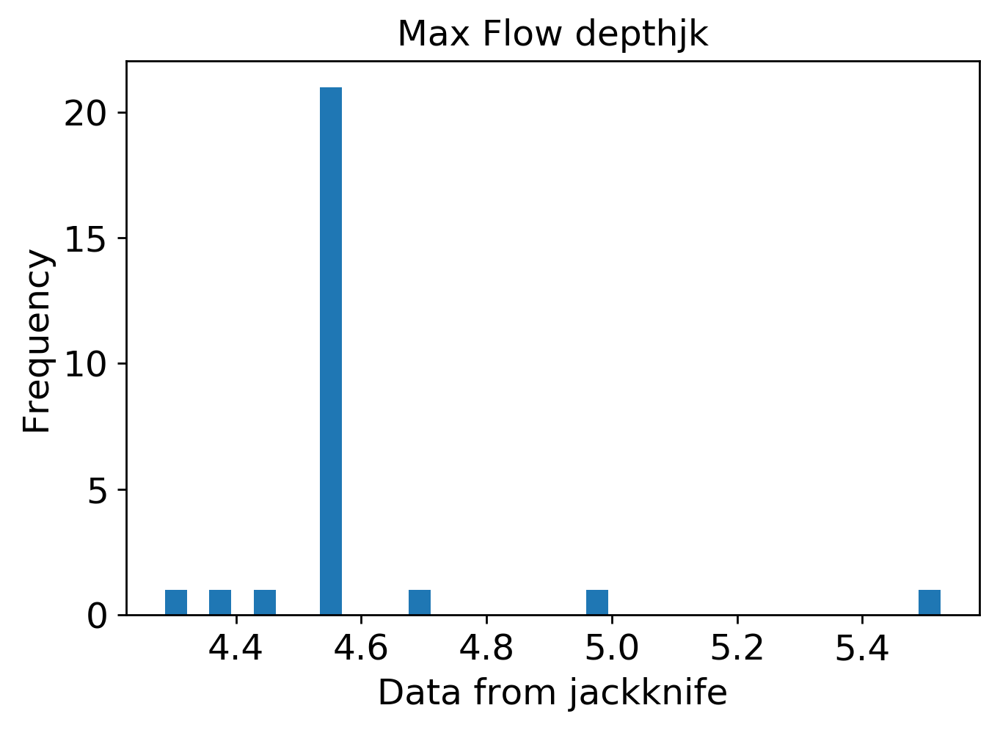

mean: 0.00921810518771737
jk_e: 0.0002470185657594961


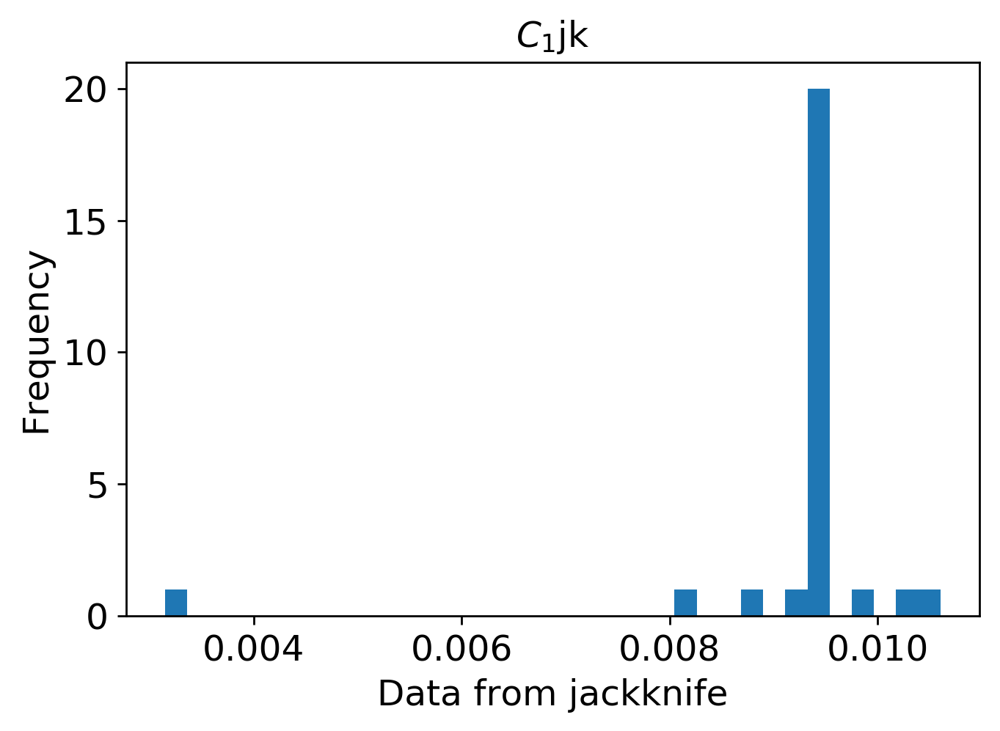

mean: 0.024131626368859918
jk_e: 0.0002507846590973302


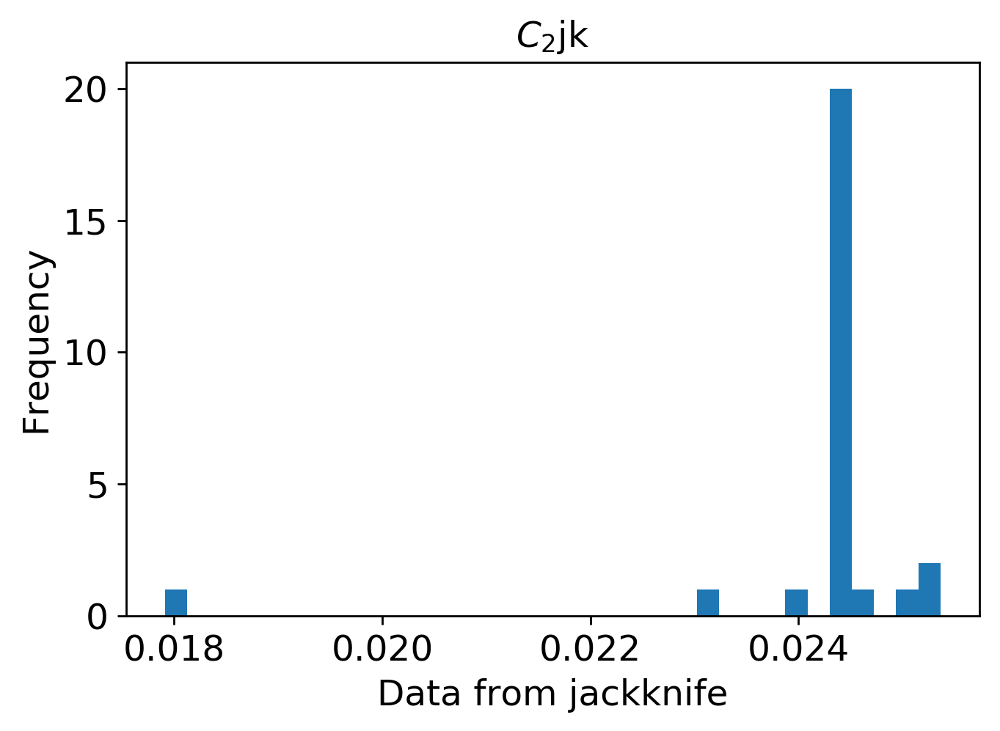

mean: 0.0243930014354055
jk_e: 0.00023455229379270226


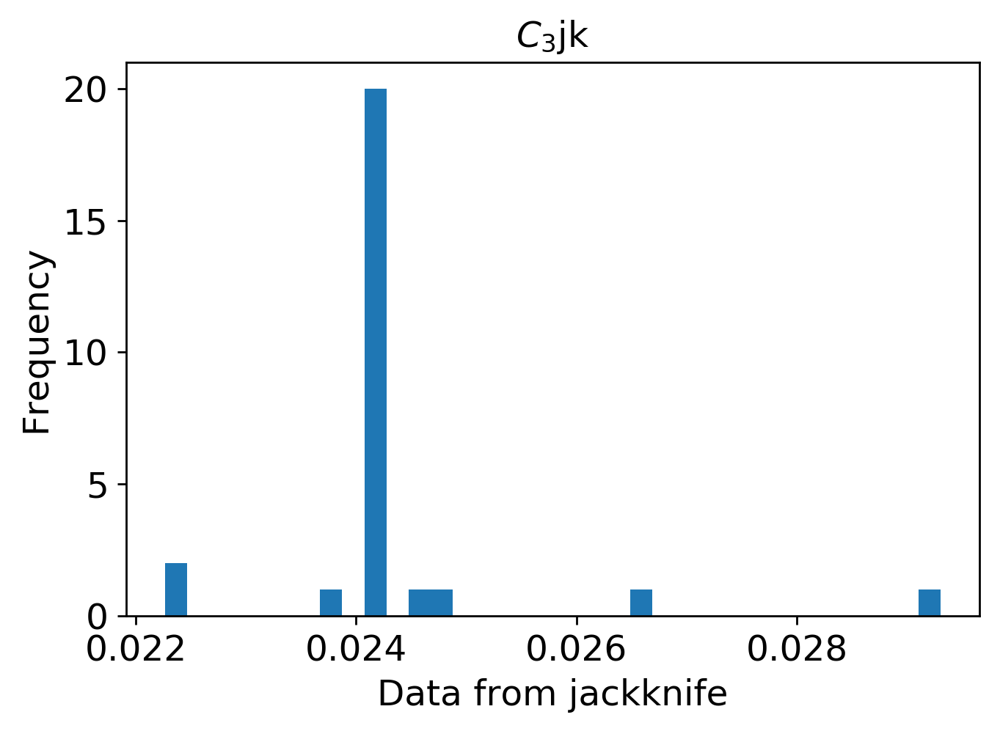

mean: 0.005364735467126149
jk_e: 9.516379597872069e-05


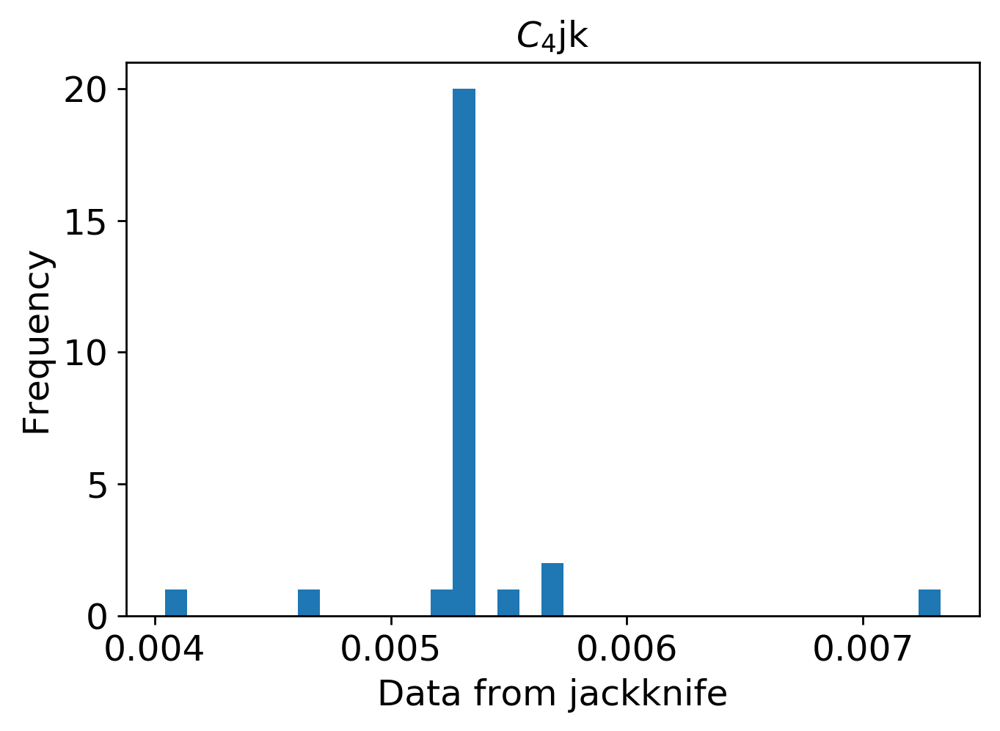

mean: 0.004078345031584165
jk_e: 0.00012343135016893393


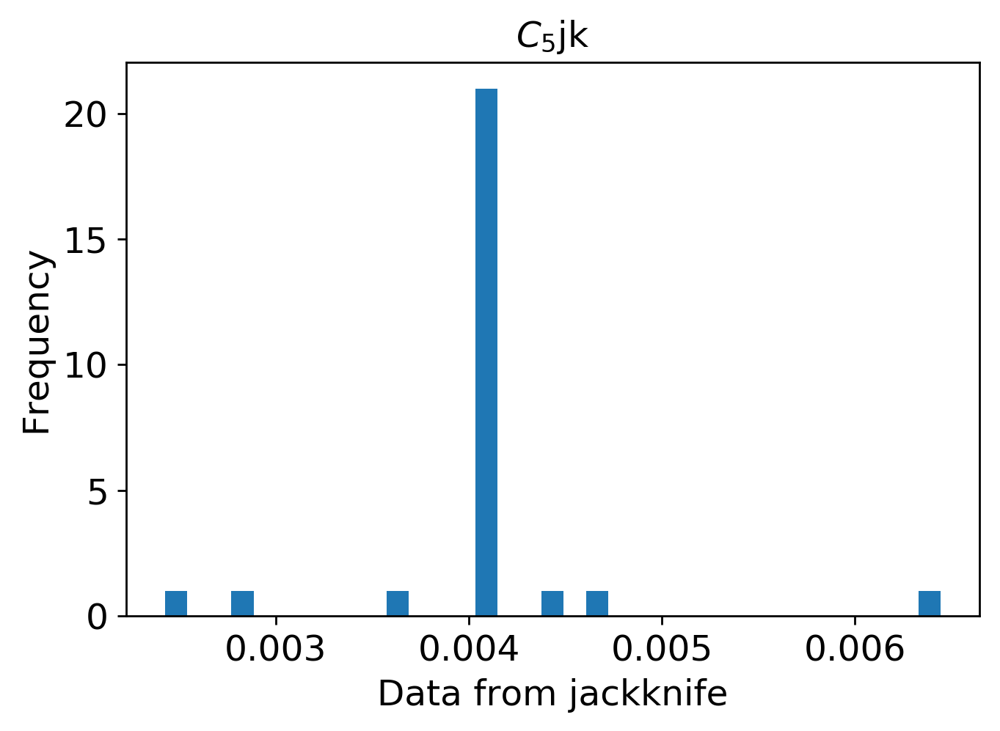

mean: 0.004240764463159918
jk_e: 0.00013717691944158174


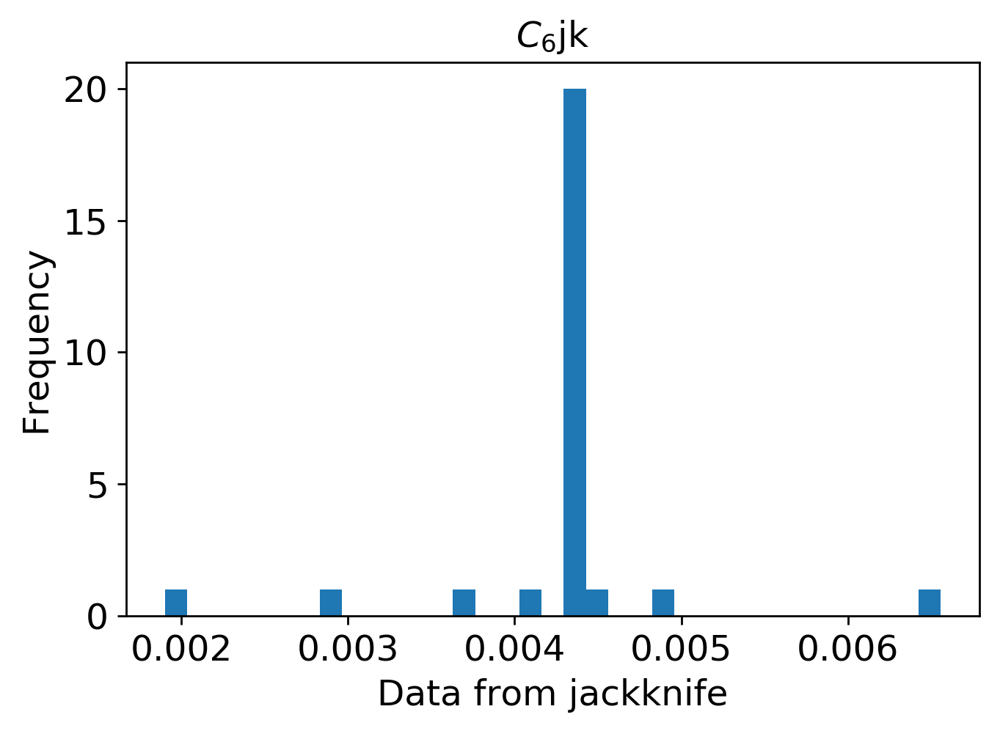

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi800/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi800.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi800.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi800.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 900

In [29]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi900"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=900)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 498us/step - loss: 0.0955 - mean_squared_error: 0.0955 - val_loss: 0.0688 - val_mean_squared_error: 0.0688
Epoch 2/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0645 - mean_squared_error: 0.0645 - val_loss: 0.0555 - val_mean_squared_error: 0.0555
Epoch 3/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0553 - mean_squared_error: 0.0553 - val_loss: 0.0483 - val_mean_squared_error: 0.0483
Epoch 4/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0489 - mean_squared_error: 0.0489 - val_loss: 0.0435 - val_mean_squared_error: 0.0435
Epoch 5/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0438 - mean_squared_error: 0.0438 - val_loss: 0.0379 - val_mean_squared_error: 0.0379
Epoch 6/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0401 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 344us/step - loss: 0.0152 - mean_squared_error: 0.0152 - val_loss: 0.0135 - val_mean_squared_error: 0.0135
Epoch 98/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0151 - mean_squared_error: 0.0151 - val_loss: 0.0127 - val_mean_squared_error: 0.0127
Epoch 99/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0152 - mean_squared_error: 0.0152 - val_loss: 0.0123 - val_mean_squared_error: 0.0123
Epoch 100/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0150 - mean_squared_error: 0.0150 - val_loss: 0.0123 - val_mean_squared_error: 0.0123
Epoch 101/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0149 - mean_squared_error: 0.0149 - val_loss: 0.0124 - val_mean_squared_error: 0.0124
Epoch 102/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0148 - mean_squared_error: 0.0148 - val_loss: 0.0127 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 365us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0078 - val_mean_squared_error: 0.0078
Epoch 194/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0108 - mean_squared_error: 0.0108 - val_loss: 0.0081 - val_mean_squared_error: 0.0081
Epoch 195/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0086 - val_mean_squared_error: 0.0086
Epoch 196/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0086 - val_mean_squared_error: 0.0086
Epoch 197/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0109 - mean_squared_error: 0.0109 - val_loss: 0.0085 - val_mean_squared_error: 0.0085
Epoch 198/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 0.0084 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 368us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 290/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 291/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 292/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 293/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 294/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0058 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 363us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 386/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 387/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 388/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 389/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 390/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0051 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 364us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 482/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 483/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 484/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 485/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 486/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0050 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 354us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 578/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 579/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 580/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 581/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 582/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0046 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 352us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 674/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 675/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 676/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 677/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 678/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 364us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 770/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 771/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 772/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 773/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 774/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0047 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 371us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 866/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 867/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 868/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 869/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 870/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 352us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 962/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 963/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 964/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 965/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 966/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0034 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 335us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1058/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1059/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1060/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1061/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1062/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1106/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 1107/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1108/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1109/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1110/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1154/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1155/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1156/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1157/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1158/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1202/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 1203/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1204/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1205/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1206/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1250/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1251/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1252/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1253/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1254/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1298/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1299/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1300/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1301/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1302/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1346/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1347/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1348/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1349/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1350/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 350us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1394/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1395/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1396/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1397/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1398/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 356us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1442/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1443/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1444/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1445/2000
3600/3600 [==============================] - 1s 327us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1446/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 334us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1490/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1491/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1492/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1493/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1494/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1538/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1539/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1540/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1541/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1542/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 334us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1586/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1587/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1588/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1589/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1590/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1634/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1635/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1636/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1637/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1638/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1682/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1683/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1684/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1685/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1686/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1730/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1731/2000
3600/3600 [==============================] - 1s 326us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1732/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1733/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1734/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 334us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1778/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1779/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1780/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1781/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1782/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 356us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1826/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1827/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1828/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1829/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1830/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 328us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1874/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1875/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1876/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1877/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1878/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1922/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1923/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1924/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1925/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1926/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 360us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1970/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1971/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1972/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1973/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1974/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_erro

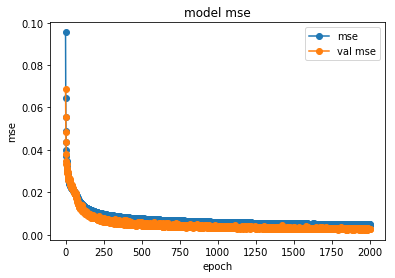

save the model


In [30]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi900/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi900/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


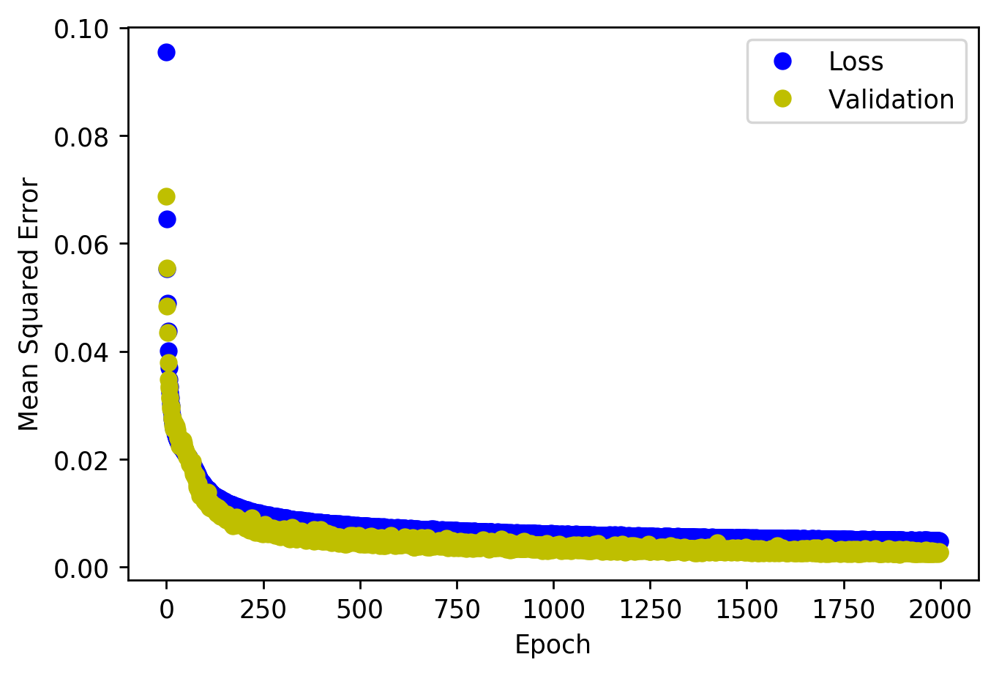

<Figure size 432x288 with 0 Axes>

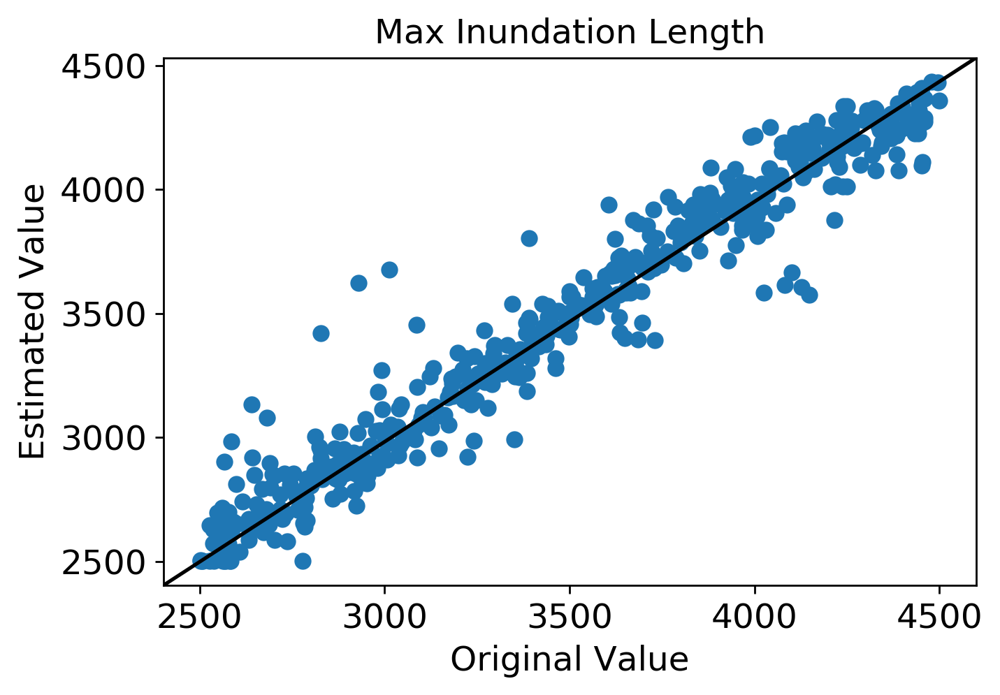

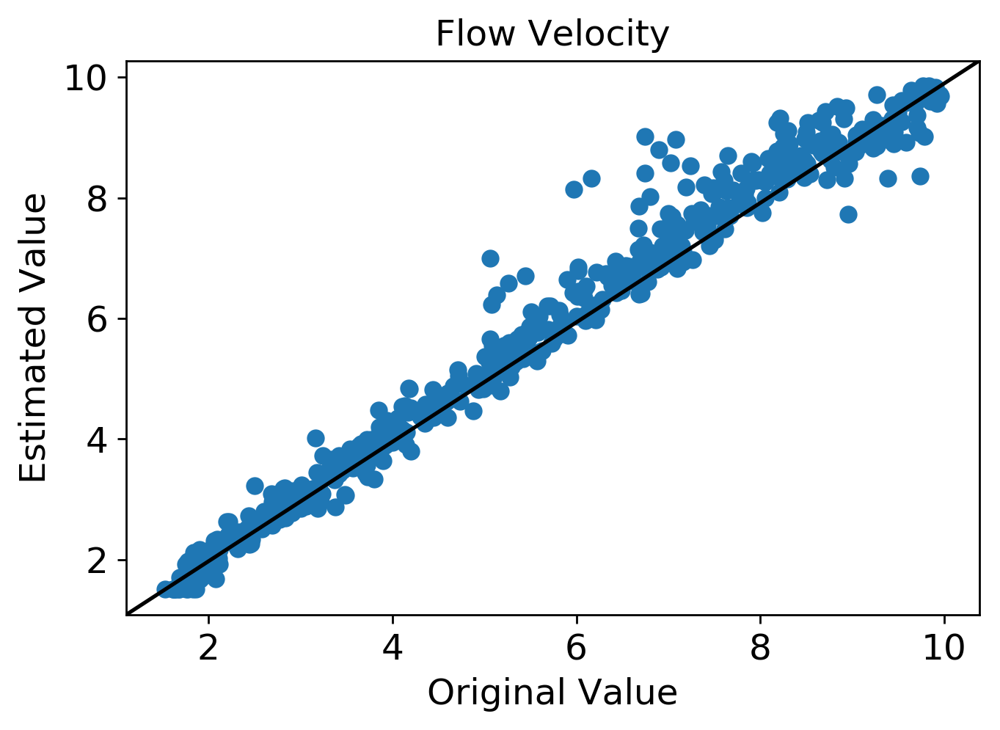

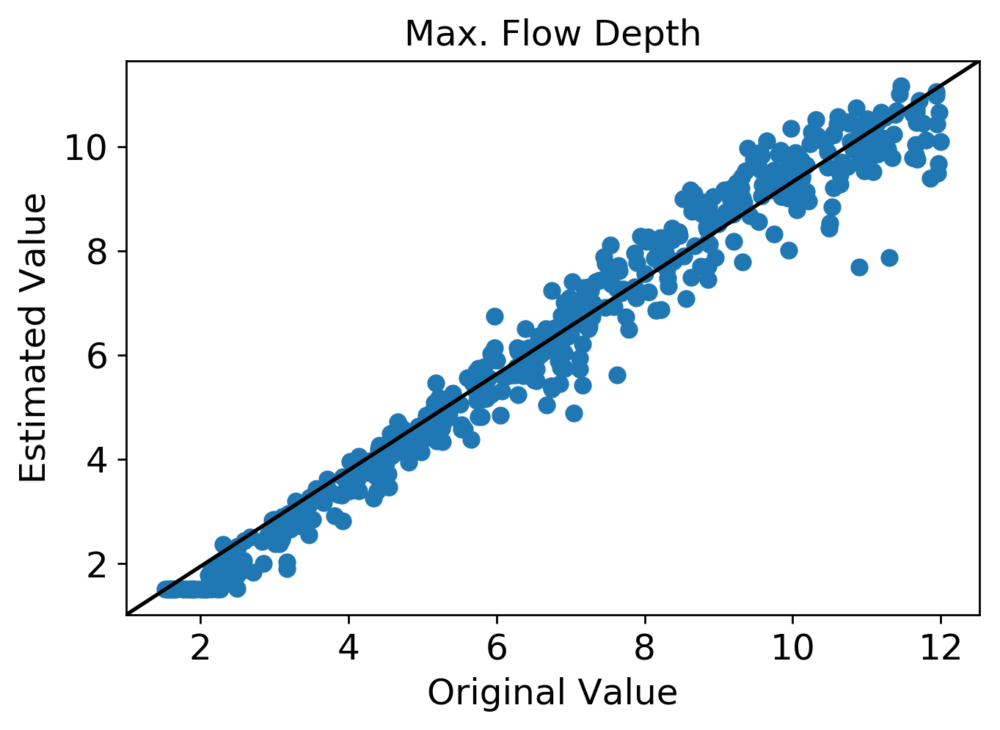

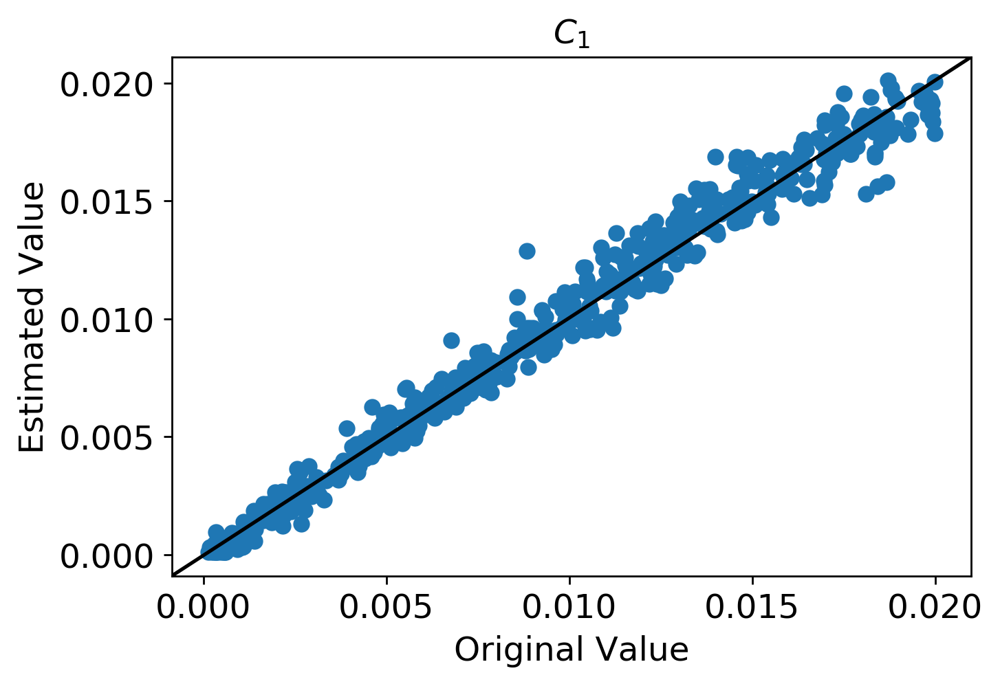

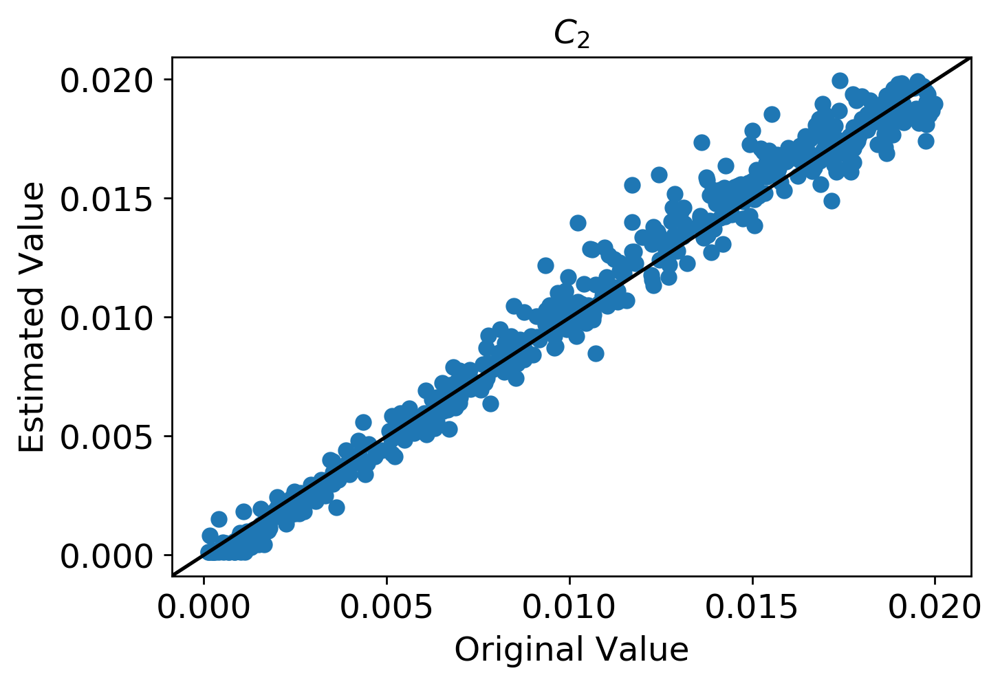

...

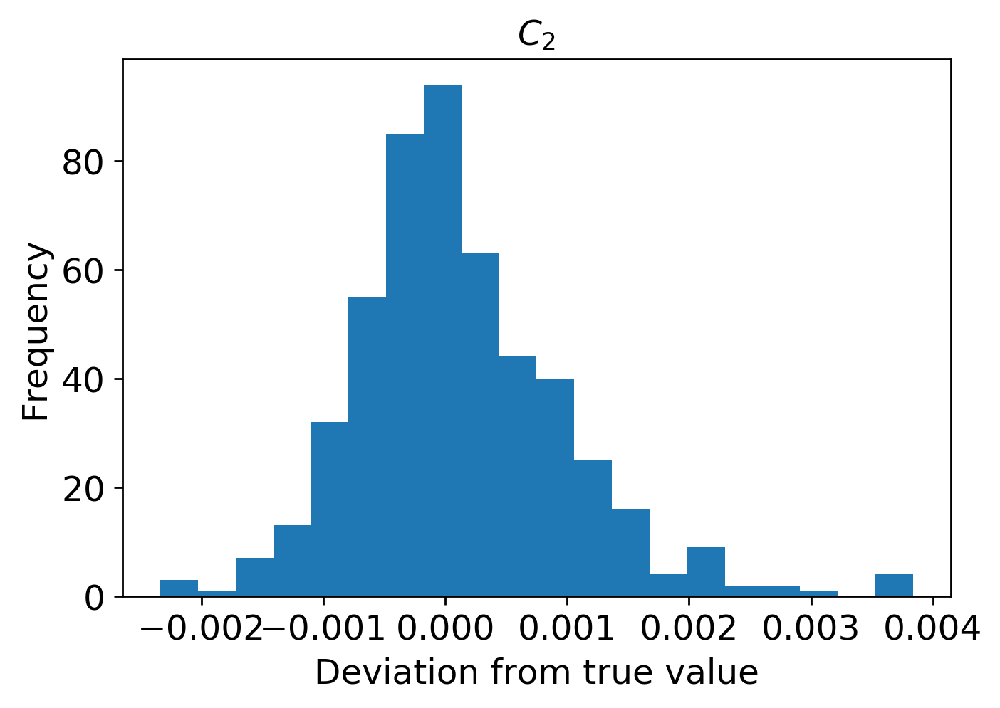

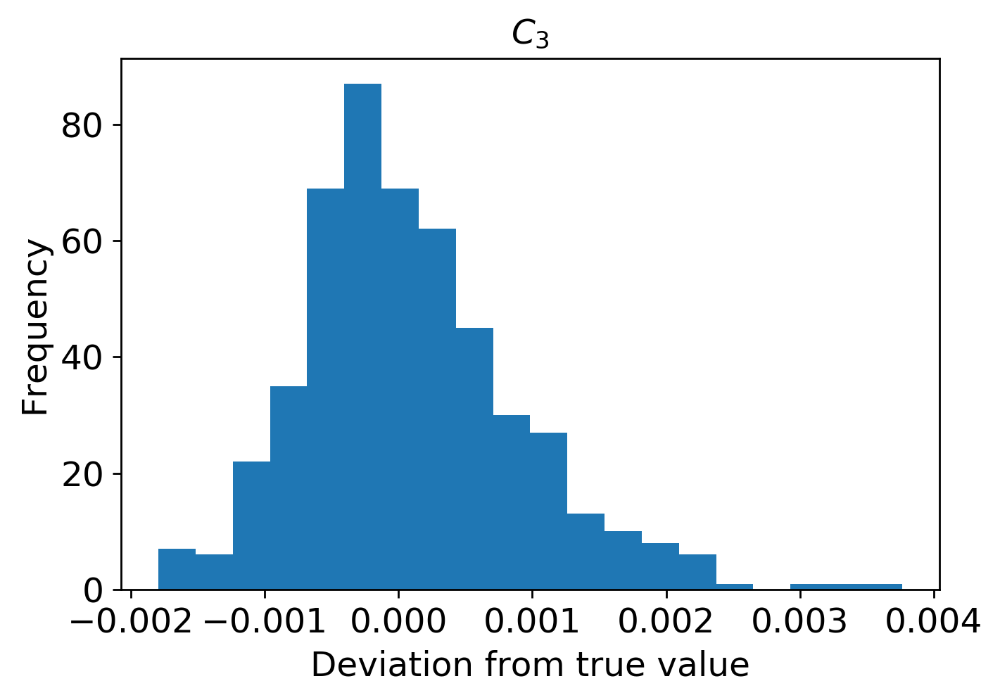

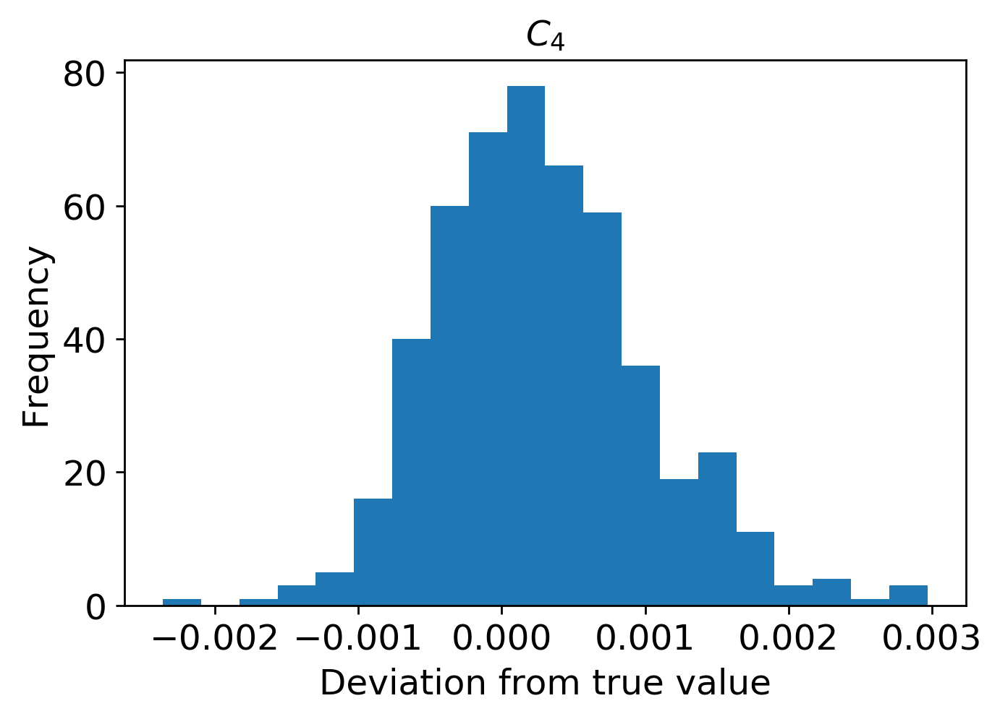

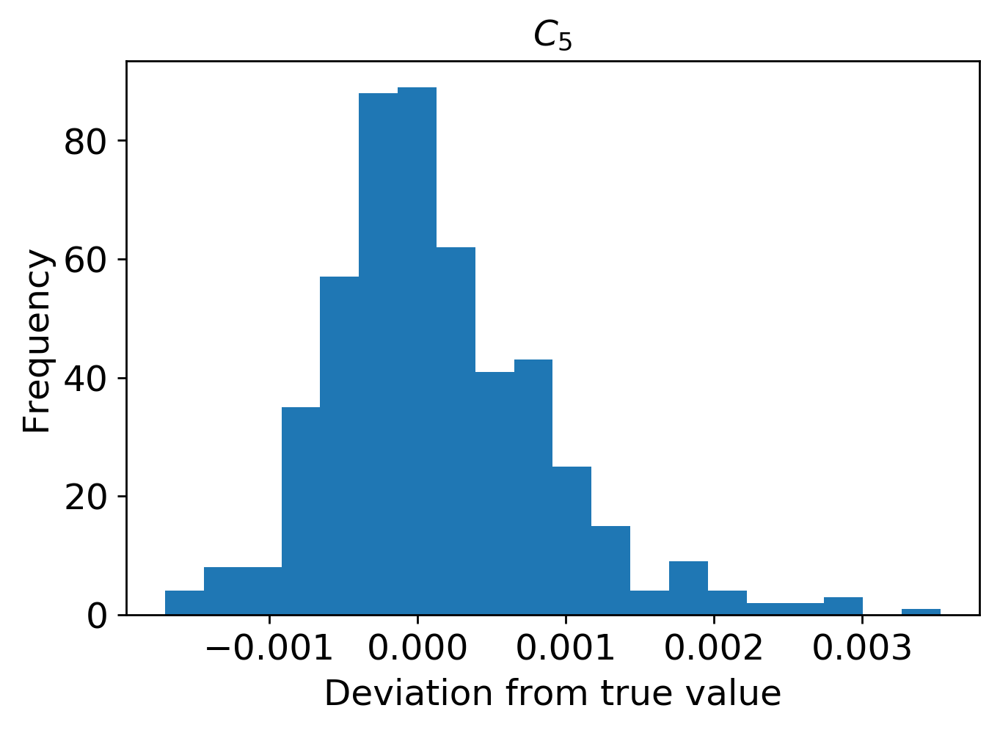

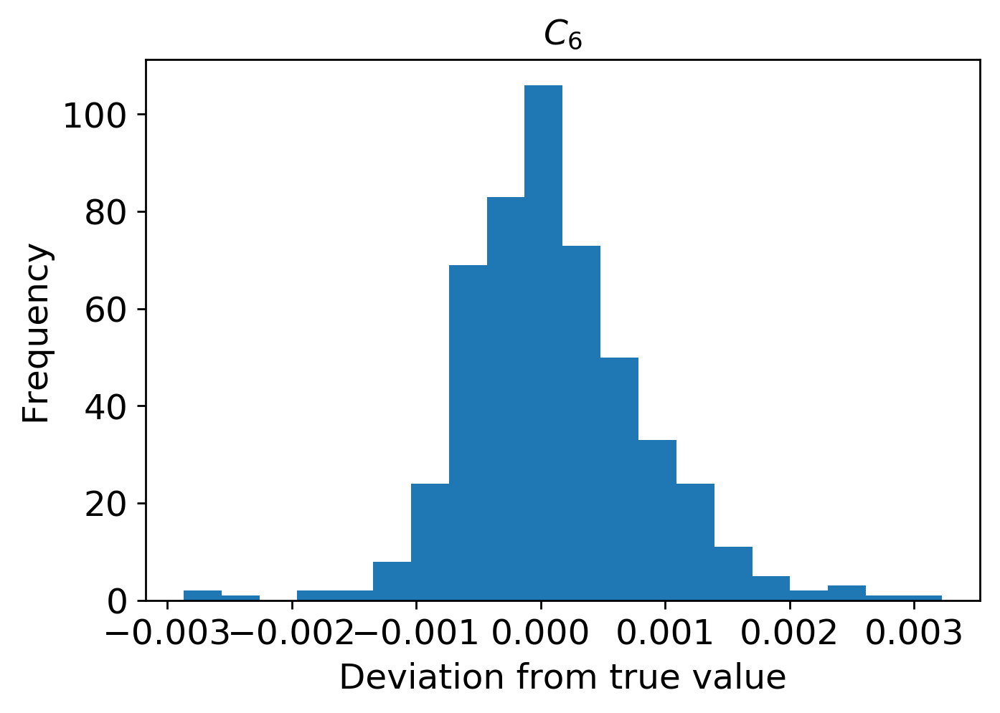

In [31]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi900/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

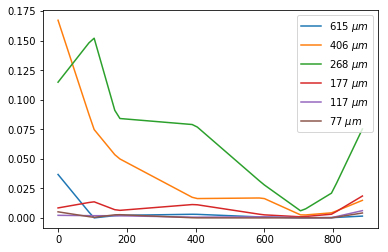

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi900/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='power',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi900.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



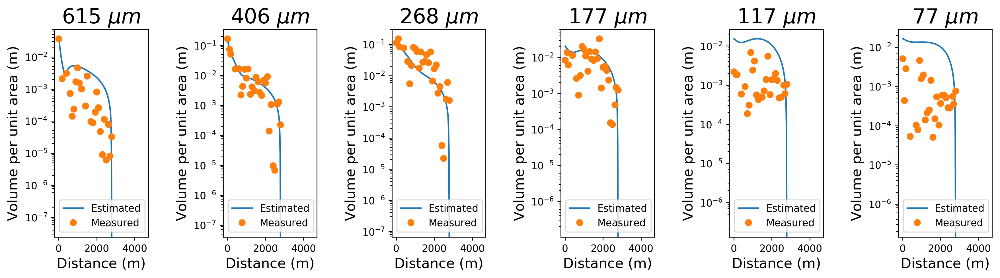

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi900.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi900.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi900.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi900.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi900.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi900.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi900.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi900.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[3.61743989e+03 6.24902022e+00 3.23263786e+00 5.85427992e-03
  2.40692959e-02 2.30858588e-02 2.77337961e-03 2.02291165e-03
  1.59060801e-03]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


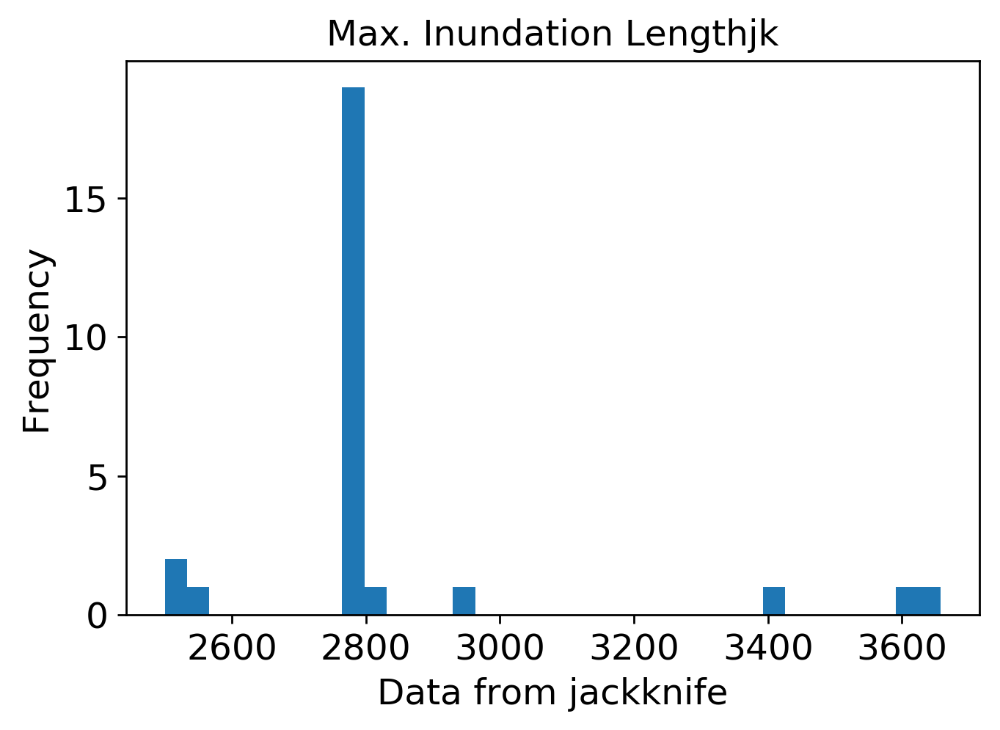

mean: 6.9306029033638925
jk_e: 0.1308848057672555


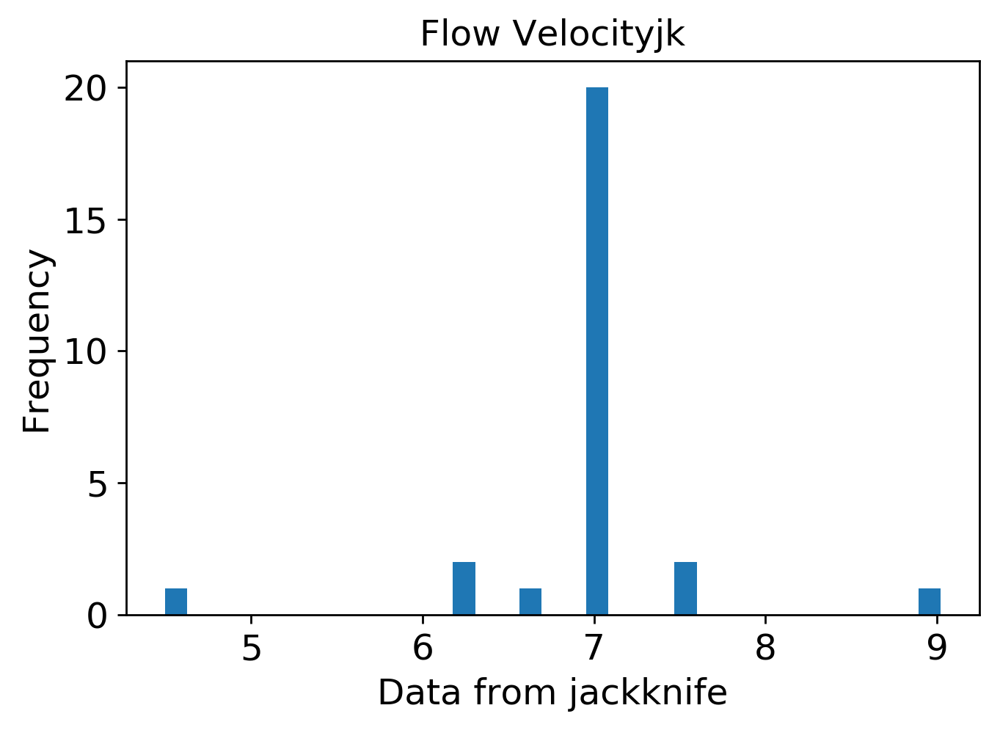

mean: 3.67827911591587
jk_e: 0.031242142988626962


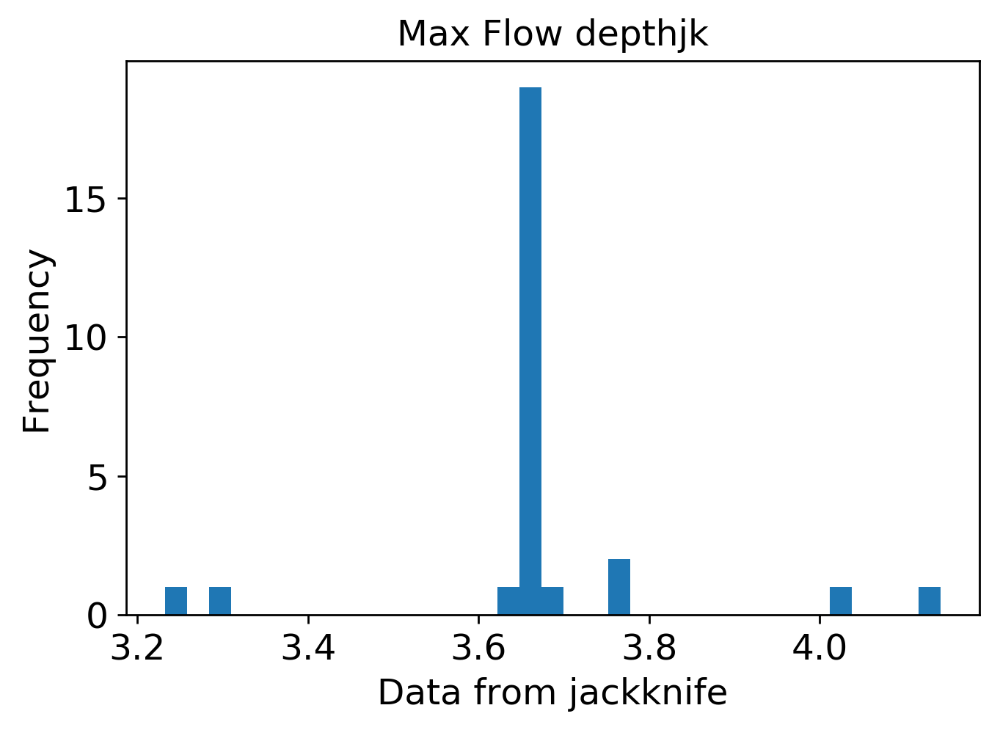

mean: 0.006567295446139965
jk_e: 0.0002318522449890851


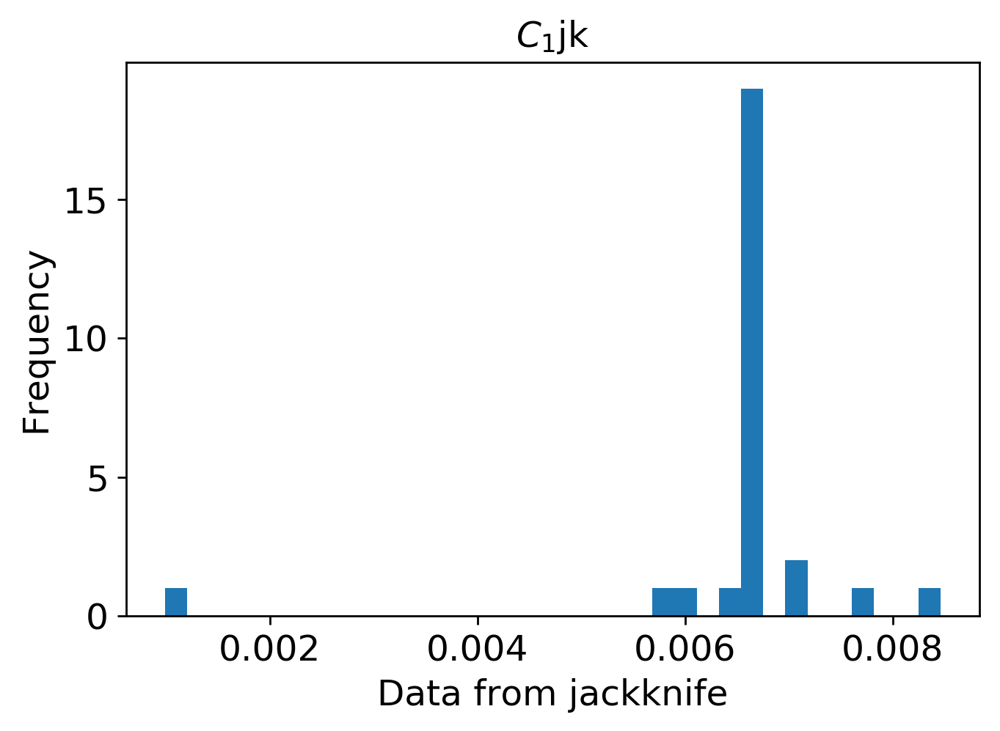

mean: 0.024458292996375742
jk_e: 0.00023285031330215375


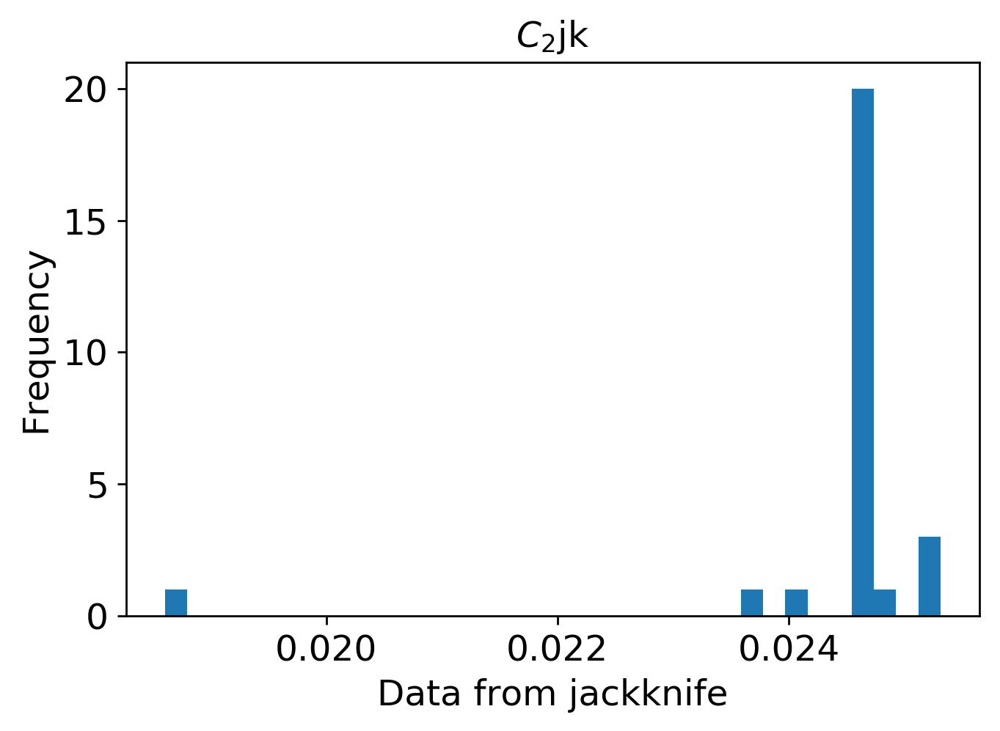

mean: 0.023891244605325816
jk_e: 0.00027137170336238224


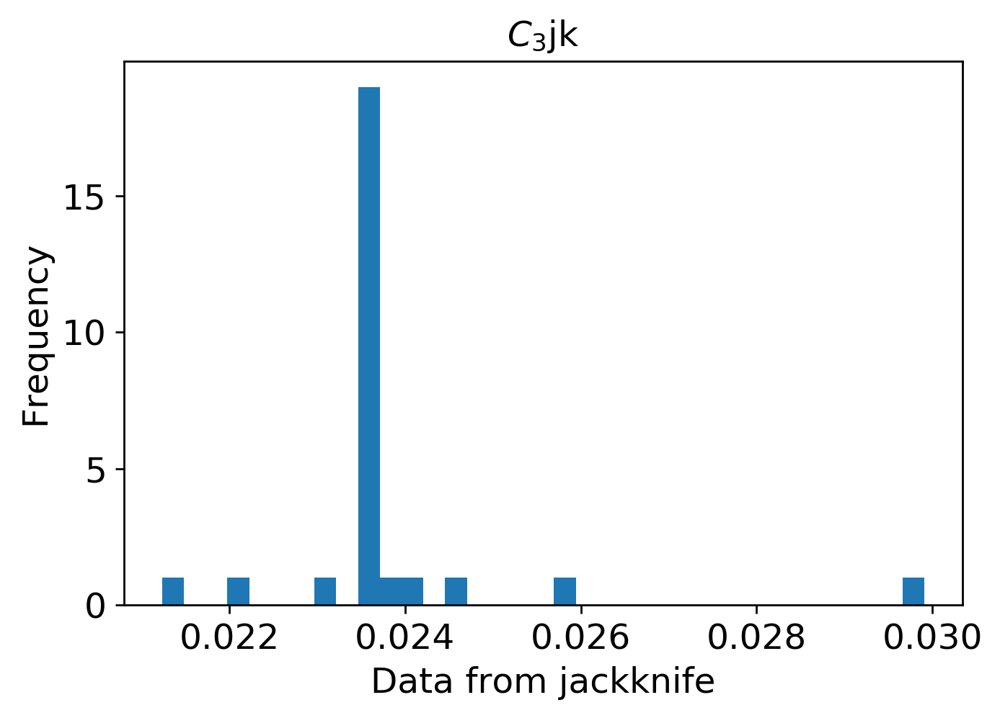

mean: 0.0035063336196414895
jk_e: 9.167539302243252e-05


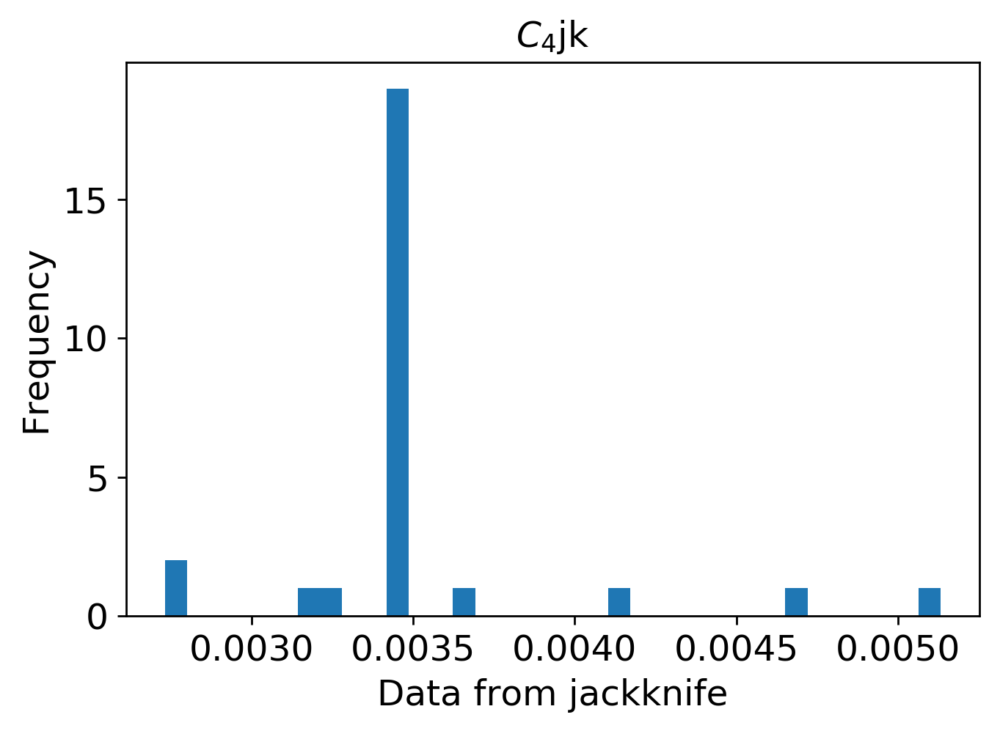

mean: 0.0025575272582990063
jk_e: 8.569708902993287e-05


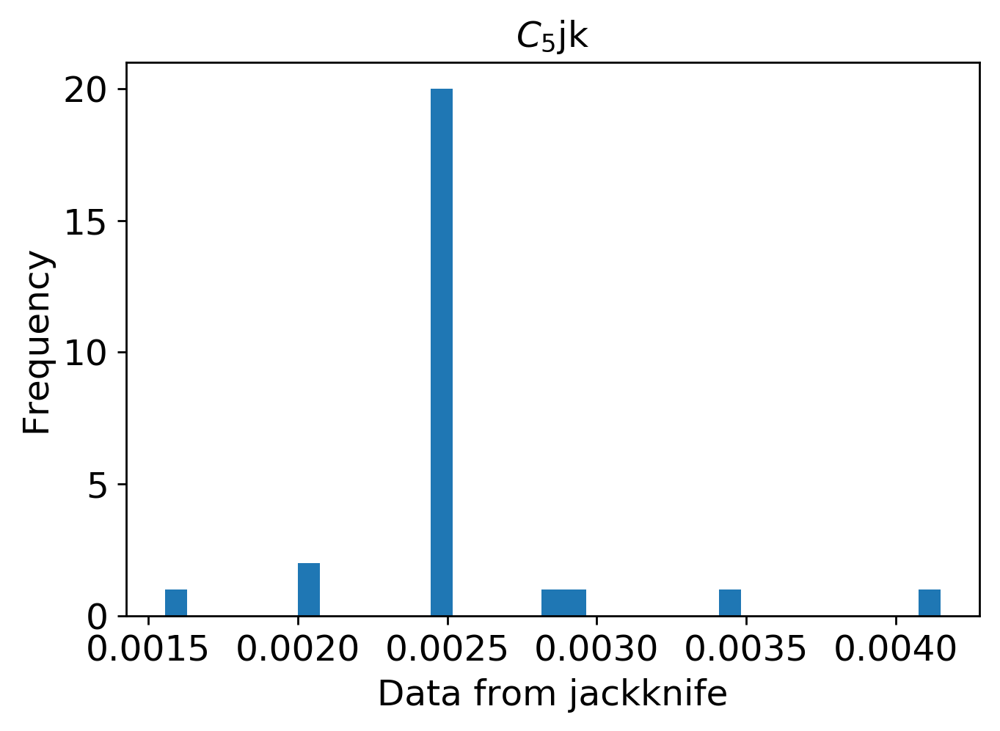

mean: 0.0027329472494698544
jk_e: 0.000107289212433892


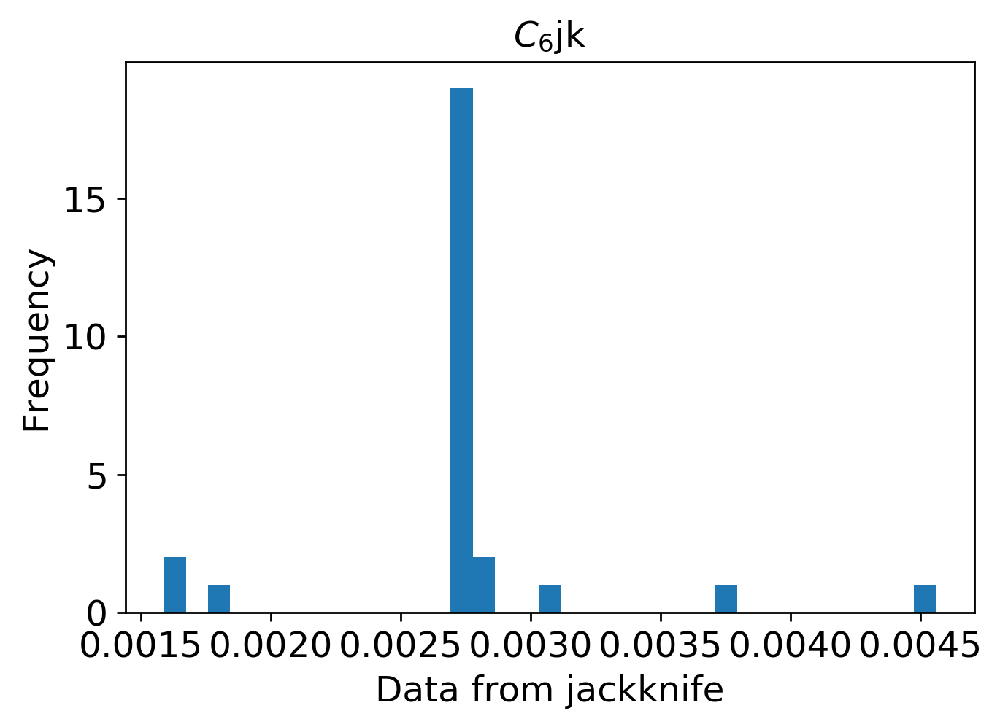

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi900/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi900.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi900.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi900.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()
